In [87]:
# Libs for Data Treatment and Vizualization
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
# from google.colab import drive

In [88]:
# drive.mount('/content/drive')

# 0. Dataset Global Models (Sorocaba-Ipero 2024 | Server Side)⭐

## Data collection

In [89]:
# # Instalar e usar chardet para detectar o encoding
# !pip install chardet

In [90]:
import chardet

file_path = 'Datasets Brutos/Estacao_A713 - Sorocaba_Ipero/2024/INMET_SE_SP_A713_IPERO-Dataset_01-01-2024_A_31-12-2024.CSV'

with open(file_path, 'rb') as f:
    result = chardet.detect(f.read(10000))  # Lê as primeiras 10.000 bytes

print(f"Encoding detectado: {result['encoding']} com confiança {result['confidence']}")

Encoding detectado: utf-8 com confiança 0.99


In [91]:
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_A713 - Sorocaba_Ipero/2024/INMET_SE_SP_A713_IPERO-Dataset_01-01-2024_A_31-12-2024.CSV'
file_path = 'Datasets Brutos/Estacao_A713 - Sorocaba_Ipero/2024/INMET_SE_SP_A713_IPERO-Dataset_01-01-2024_A_31-12-2024.CSV'

# Upload CSV file into DataFrame
df = pd.read_csv(file_path, encoding='utf-8', sep=';', decimal=',')

In [92]:
print("Dataframe format:")
print(f" ↪Linhas: {df.shape[0]} \n ↪Colunas: {df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
df.head()

Dataframe format:
 ↪Linhas: 8784 
 ↪Colunas: 20

---

First 5 lines of the dataset:


,Data,Hora UTC,"PRECIPITA��O TOTAL, HOR�RIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESS�O ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESS�O ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m�),"TEMPERATURA DO AR - BULBO SECO, HORARIA (�C)",TEMPERATURA DO PONTO DE ORVALHO (�C),TEMPERATURA M�XIMA NA HORA ANT. (AUT) (�C),TEMPERATURA M�NIMA NA HORA ANT. (AUT) (�C),TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (�C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (�C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIRE��O HORARIA (gr) (� (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)",Unnamed: 19
0,2024/01/01,0000 UTC,0.0,946.2,946.2,945.5,NaN,20.2,16.2,21.1,20.1,16.7,16.2,79,75,78,115,6.3,3.1,NaN
1,2024/01/01,0100 UTC,0.0,946.6,946.6,946.1,NaN,20.5,16.1,20.5,19.7,16.4,16.1,81,76,76,123,5.1,0.1,NaN
2,2024/01/01,0200 UTC,0.0,946.7,946.9,946.6,NaN,20.8,15.9,20.8,20.5,16.1,15.9,76,74,74,123,1.0,0.1,NaN
3,2024/01/01,0300 UTC,0.0,946.3,946.8,946.3,NaN,20.9,16.3,21.0,20.7,16.3,15.9,75,73,75,119,1.2,0.2,NaN
4,2024/01/01,0400 UTC,0.0,946.3,946.4,946.1,NaN,20.2,16.0,20.9,20.2,16.2,16.0,77,75,77,115,0.9,0.0,NaN


Renomeando as colunas

In [93]:
# Verificar os nomes das colunas atuais
print("Colunas originais:")
print(df.columns.tolist())

Colunas originais:
['Data', 'Hora UTC', 'PRECIPITA��O TOTAL, HOR�RIO (mm)', 'PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)', 'PRESS�O ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)', 'PRESS�O ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)', 'RADIACAO GLOBAL (Kj/m�)', 'TEMPERATURA DO AR - BULBO SECO, HORARIA (�C)', 'TEMPERATURA DO PONTO DE ORVALHO (�C)', 'TEMPERATURA M�XIMA NA HORA ANT. (AUT) (�C)', 'TEMPERATURA M�NIMA NA HORA ANT. (AUT) (�C)', 'TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (�C)', 'TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (�C)', 'UMIDADE REL. MAX. NA HORA ANT. (AUT) (%)', 'UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)', 'UMIDADE RELATIVA DO AR, HORARIA (%)', 'VENTO, DIRE��O HORARIA (gr) (� (gr))', 'VENTO, RAJADA MAXIMA (m/s)', 'VENTO, VELOCIDADE HORARIA (m/s)', 'Unnamed: 19']


In [94]:
# Mapeamento para corrigir os caracteres
correcoes = {
    'PRECIPITA��O': 'PRECIPITAÇÃO',
    'HOR�RIO': 'HORÁRIO',
    'PRESS�O': 'PRESSÃO',
    'Kj/m�': 'Kj/m²',
    '(�C)': '(°C)',
    'M�XIMA': 'MÁXIMA',
    'M�NIMA': 'MÍNIMA',
    'DIRE��O': 'DIREÇÃO',
    '(� (gr))': '(° (gr))'
}

# Renomear colunas
novos_nomes = []
for coluna in df.columns:
    for errado, correto in correcoes.items():
        coluna = coluna.replace(errado, correto)
    novos_nomes.append(coluna)

df.columns = novos_nomes

print("\nColunas corrigidas:")
print(df.columns.tolist())


Colunas corrigidas:
['Data', 'Hora UTC', 'PRECIPITAÇÃO TOTAL, HORÁRIO (mm)', 'PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)', 'PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)', 'PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)', 'RADIACAO GLOBAL (Kj/m²)', 'TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)', 'TEMPERATURA DO PONTO DE ORVALHO (°C)', 'TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)', 'TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C)', 'TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C)', 'TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C)', 'UMIDADE REL. MAX. NA HORA ANT. (AUT) (%)', 'UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)', 'UMIDADE RELATIVA DO AR, HORARIA (%)', 'VENTO, DIREÇÃO HORARIA (gr) (° (gr))', 'VENTO, RAJADA MAXIMA (m/s)', 'VENTO, VELOCIDADE HORARIA (m/s)', 'Unnamed: 19']


In [95]:
# Data general info
print("General Dataset Information:")
print(df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8784 entries, 0 to 8783
Data columns (total 20 columns):
 #   Column                                                 Non-Null Count  Dtype  
---  ------                                                 --------------  -----  
 0   Data                                                   8784 non-null   object 
 1   Hora UTC                                               8784 non-null   object 
 2   PRECIPITAÇÃO TOTAL, HORÁRIO (mm)                       8784 non-null   float64
 3   PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)  8784 non-null   float64
 4   PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)        8784 non-null   float64
 5   PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)       8784 non-null   float64
 6   RADIACAO GLOBAL (Kj/m²)                                4774 non-null   float64
 7   TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)           8784 non-null   float64
 8   TEMPERATURA DO PONT

In [96]:
print("Descriptive statistics:")
df.describe()

Descriptive statistics:


,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)",Unnamed: 19
count,8784.000000,8784.00000,8784.000000,8784.000000,4774.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,8784.000000,744.000000,744.000000,0.0
mean,0.123611,946.88273,947.139822,946.624966,1379.983515,21.719752,15.426628,22.502550,20.968921,16.083675,14.819080,74.285861,67.846995,71.078780,179.473019,2.948656,0.774328,NaN
std,1.138521,3.47141,3.452331,3.483715,1069.268533,5.257070,4.044032,5.361661,5.153918,3.925735,4.175048,18.321938,20.368825,19.505995,83.506396,3.595477,1.638837,NaN
min,0.000000,936.50000,936.500000,936.200000,0.000000,2.400000,-4.100000,3.800000,2.000000,-1.500000,-4.500000,14.000000,11.000000,13.000000,1.000000,0.000000,0.000000,NaN
25%,0.000000,944.50000,944.800000,944.200000,350.125000,18.300000,12.700000,19.000000,17.700000,13.400000,12.100000,63.000000,53.000000,58.000000,118.000000,0.400000,0.000000,NaN
50%,0.000000,946.60000,946.800000,946.300000,1257.650000,21.400000,15.900000,22.100000,20.800000,16.600000,15.400000,80.000000,72.000000,77.000000,167.000000,0.800000,0.000000,NaN
75%,0.000000,949.10000,949.400000,948.900000,2300.275000,25.300000,18.600000,26.300000,24.300000,19.200000,18.100000,89.000000,85.000000,87.000000,242.000000,5.500000,0.200000,NaN
max,29.600000,957.60000,957.600000,957.000000,3983.000000,36.700000,24.600000,37.600000,36.000000,24.700000,23.100000,97.000000,97.000000,97.000000,360.000000,18.300000,8.100000,NaN


## Data Pre-Processing

In [97]:
# --------------------
# Data Pre-Processing
# --------------------

# Removing 'UTC' from the time column
df['Hora UTC'] = df['Hora UTC'].str.replace(' UTC', '')

# Convert the UTC format to datetime format (only hour and minute)
df['Hora Datetime'] = pd.to_datetime(df['Hora UTC'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
df['Data e Hora (datetime)'] = df['Data'] + ' ' + df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
df['Data e Hora (datetime)'] = pd.to_datetime(df['Data e Hora (datetime)'])

df['Data e Hora (datetime)'].head()

0   2024-01-01 00:00:00
1   2024-01-01 01:00:00
2   2024-01-01 02:00:00
3   2024-01-01 03:00:00
4   2024-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [98]:
df.head()

,Data,Hora UTC,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),...,TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)",Unnamed: 19,Hora Datetime,Data e Hora (datetime)
0,2024/01/01,0000,0.0,946.2,946.2,945.5,NaN,20.2,16.2,21.1,...,16.2,79,75,78,115,6.3,3.1,NaN,00:00:00,2024-01-01 00:00:00
1,2024/01/01,0100,0.0,946.6,946.6,946.1,NaN,20.5,16.1,20.5,...,16.1,81,76,76,123,5.1,0.1,NaN,01:00:00,2024-01-01 01:00:00
2,2024/01/01,0200,0.0,946.7,946.9,946.6,NaN,20.8,15.9,20.8,...,15.9,76,74,74,123,1.0,0.1,NaN,02:00:00,2024-01-01 02:00:00
3,2024/01/01,0300,0.0,946.3,946.8,946.3,NaN,20.9,16.3,21.0,...,15.9,75,73,75,119,1.2,0.2,NaN,03:00:00,2024-01-01 03:00:00
4,2024/01/01,0400,0.0,946.3,946.4,946.1,NaN,20.2,16.0,20.9,...,16.0,77,75,77,115,0.9,0.0,NaN,04:00:00,2024-01-01 04:00:00


In [99]:
# Removing "Data", "Hora UTC", "Hora Datetime" columns and one with no values
df = df.drop(columns=['Data', 'Hora UTC', 'Hora Datetime', 'Unnamed: 19'])
# df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = df.pop(column)          # remove the column
df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(df.shape)

df.head()

DataFrame format:
(8784, 18)


,Data e Hora (datetime),"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)"
0,2024-01-01 00:00:00,0.0,946.2,946.2,945.5,NaN,20.2,16.2,21.1,20.1,16.7,16.2,79,75,78,115,6.3,3.1
1,2024-01-01 01:00:00,0.0,946.6,946.6,946.1,NaN,20.5,16.1,20.5,19.7,16.4,16.1,81,76,76,123,5.1,0.1
2,2024-01-01 02:00:00,0.0,946.7,946.9,946.6,NaN,20.8,15.9,20.8,20.5,16.1,15.9,76,74,74,123,1.0,0.1
3,2024-01-01 03:00:00,0.0,946.3,946.8,946.3,NaN,20.9,16.3,21.0,20.7,16.3,15.9,75,73,75,119,1.2,0.2
4,2024-01-01 04:00:00,0.0,946.3,946.4,946.1,NaN,20.2,16.0,20.9,20.2,16.2,16.0,77,75,77,115,0.9,0.0


In [100]:
# Indexing of the 'Datetime' Date and Time
df.set_index('Data e Hora (datetime)', inplace=True)

df.head()

,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)"
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2024-01-01 00:00:00,0.0,946.2,946.2,945.5,NaN,20.2,16.2,21.1,20.1,16.7,16.2,79,75,78,115,6.3,3.1
2024-01-01 01:00:00,0.0,946.6,946.6,946.1,NaN,20.5,16.1,20.5,19.7,16.4,16.1,81,76,76,123,5.1,0.1
2024-01-01 02:00:00,0.0,946.7,946.9,946.6,NaN,20.8,15.9,20.8,20.5,16.1,15.9,76,74,74,123,1.0,0.1
2024-01-01 03:00:00,0.0,946.3,946.8,946.3,NaN,20.9,16.3,21.0,20.7,16.3,15.9,75,73,75,119,1.2,0.2
2024-01-01 04:00:00,0.0,946.3,946.4,946.1,NaN,20.2,16.0,20.9,20.2,16.2,16.0,77,75,77,115,0.9,0.0


In [101]:
# Check missing values
print("Amount of missing values per column:")
print(df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(df.isnull().mean() * 100)

Amount of missing values per column:
PRECIPITAÇÃO TOTAL, HORÁRIO (mm)                            0
PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)       0
PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)             0
PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)            0
RADIACAO GLOBAL (Kj/m²)                                  4010
TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)                0
TEMPERATURA DO PONTO DE ORVALHO (°C)                        0
TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)                  0
TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C)                  0
TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C)            0
TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C)            0
UMIDADE REL. MAX. NA HORA ANT. (AUT) (%)                    0
UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)                    0
UMIDADE RELATIVA DO AR, HORARIA (%)                         0
VENTO, DIREÇÃO HORARIA (gr) (° (gr))                        0
VENTO, RAJADA MAXIMA (m/s)       

In [102]:
# Fill in missing values with the median
df['RADIACAO GLOBAL (Kj/m²)'] = df['RADIACAO GLOBAL (Kj/m²)'].fillna(df['RADIACAO GLOBAL (Kj/m²)'].median())

In [103]:
# Fill missing value in 'total precipitation, time (mm)' performing the interpolation
for column in df.columns:
  if column == 'PRECIPITAÇÃO TOTAL, HORÁRIO (mm)':
    df[column] = df[column].interpolate(method='linear')  # Interpolação linear

In [104]:
# Check missing values
print("Amount of missing values per column:")
print(df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(df.isnull().mean() * 100)

Amount of missing values per column:
PRECIPITAÇÃO TOTAL, HORÁRIO (mm)                            0
PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)       0
PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)             0
PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)            0
RADIACAO GLOBAL (Kj/m²)                                     0
TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)                0
TEMPERATURA DO PONTO DE ORVALHO (°C)                        0
TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C)                  0
TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C)                  0
TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C)            0
TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C)            0
UMIDADE REL. MAX. NA HORA ANT. (AUT) (%)                    0
UMIDADE REL. MIN. NA HORA ANT. (AUT) (%)                    0
UMIDADE RELATIVA DO AR, HORARIA (%)                         0
VENTO, DIREÇÃO HORARIA (gr) (° (gr))                        0
VENTO, RAJADA MAXIMA (m/s)       

Checking the main features visually

In [105]:
# Filters the data by interval
df_intervalo = df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

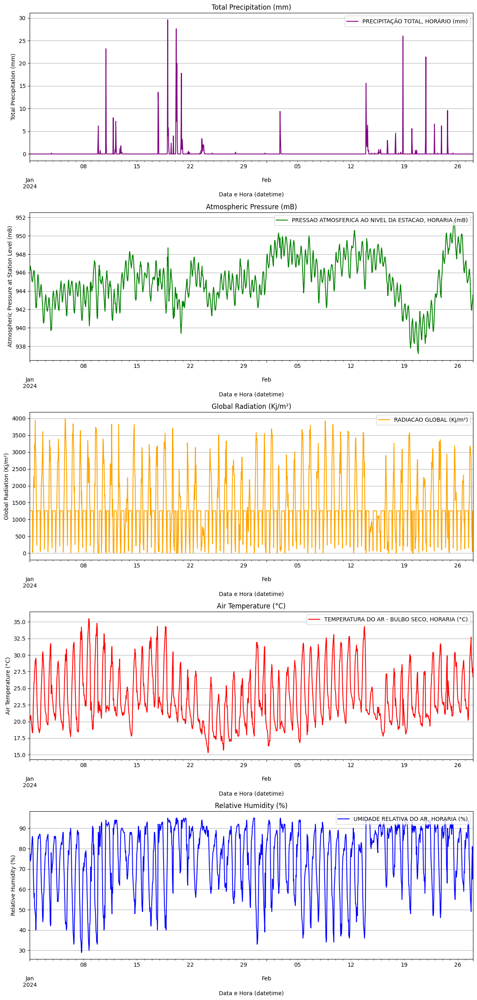

In [106]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
df_intervalo.plot(y='PRECIPITAÇÃO TOTAL, HORÁRIO (mm)', ax=axes[0], color='purple', legend=True, title='Total Precipitation (mm)')
df_intervalo.plot(y='PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)', ax=axes[1], color='green', legend=True, title='Atmospheric Pressure (mB)')
df_intervalo.plot(y='RADIACAO GLOBAL (Kj/m²)', ax=axes[2], color='orange', legend=True, title='Global Radiation (Kj/m²)')
df_intervalo.plot(y='TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)', ax=axes[3], color='red', legend=True, title='Air Temperature (°C)')
df_intervalo.plot(y='UMIDADE RELATIVA DO AR, HORARIA (%)', ax=axes[4], color='blue', legend=True, title='Relative Humidity (%)')

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel('Total Precipitation (mm)')
axes[1].set_ylabel('Atmospheric Pressure at Station Level (mB)')
axes[2].set_ylabel('Global Radiation (Kj/m²)')
axes[3].set_ylabel('Air Temperature (°C)')
axes[4].set_ylabel('Relative Humidity (%)')
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

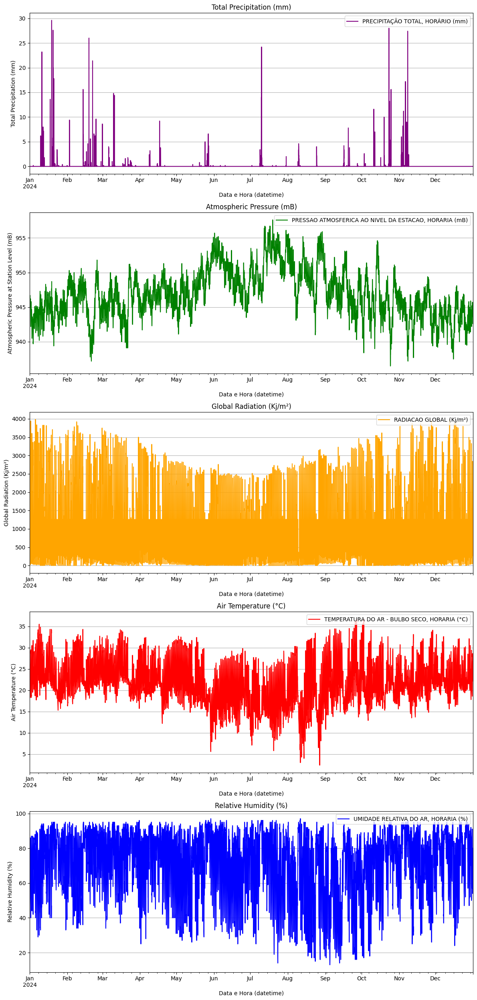

In [107]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
df.plot(y='PRECIPITAÇÃO TOTAL, HORÁRIO (mm)', ax=axes[0], color='purple', legend=True, title='Total Precipitation (mm)')
df.plot(y='PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)', ax=axes[1], color='green', legend=True, title='Atmospheric Pressure (mB)')
df.plot(y='RADIACAO GLOBAL (Kj/m²)', ax=axes[2], color='orange', legend=True, title='Global Radiation (Kj/m²)')
df.plot(y='TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)', ax=axes[3], color='red', legend=True, title='Air Temperature (°C)')
df.plot(y='UMIDADE RELATIVA DO AR, HORARIA (%)', ax=axes[4], color='blue', legend=True, title='Relative Humidity (%)')

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel('Total Precipitation (mm)')
axes[1].set_ylabel('Atmospheric Pressure at Station Level (mB)')
axes[2].set_ylabel('Global Radiation (Kj/m²)')
axes[3].set_ylabel('Air Temperature (°C)')
axes[4].set_ylabel('Relative Humidity (%)')
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature

In [108]:
# ----------------------------------------------------------------------
# Creating the Target feature 'PRECIPITAÇÃO TOTAL, HORÁRIO (mm) (t+1)'
# ----------------------------------------------------------------------

df['PRECIPITAÇÃO TOTAL, HORÁRIO (mm) (t+1)'] = df['PRECIPITAÇÃO TOTAL, HORÁRIO (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'PRECIPITAÇÃO TOTAL, HORÁRIO (mm) (t+1)'
removed_target_column = df.pop(target_column)
df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
df.dropna(subset=['PRECIPITAÇÃO TOTAL, HORÁRIO (mm) (t+1)'], inplace=True)

df.tail()

,"PRECIPITAÇÃO TOTAL, HORÁRIO (mm) (t+1)","PRECIPITAÇÃO TOTAL, HORÁRIO (mm)","PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)",PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB),PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB),RADIACAO GLOBAL (Kj/m²),"TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)",TEMPERATURA DO PONTO DE ORVALHO (°C),TEMPERATURA MÁXIMA NA HORA ANT. (AUT) (°C),TEMPERATURA MÍNIMA NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MAX. NA HORA ANT. (AUT) (°C),TEMPERATURA ORVALHO MIN. NA HORA ANT. (AUT) (°C),UMIDADE REL. MAX. NA HORA ANT. (AUT) (%),UMIDADE REL. MIN. NA HORA ANT. (AUT) (%),"UMIDADE RELATIVA DO AR, HORARIA (%)","VENTO, DIREÇÃO HORARIA (gr) (° (gr))","VENTO, RAJADA MAXIMA (m/s)","VENTO, VELOCIDADE HORARIA (m/s)"
Data e Hora (datetime),,,,,,,,,,,,,,,,,,
2024-12-31 18:00:00,0.0,0.0,943.5,943.6,943.1,920.7,28.3,18.9,29.1,28.2,19.3,18.0,58,53,57,241,NaN,NaN
2024-12-31 19:00:00,0.0,0.0,943.4,943.6,943.3,825.0,26.2,20.1,28.8,26.2,20.7,18.2,69,55,69,216,NaN,NaN
2024-12-31 20:00:00,0.0,0.0,942.7,943.7,942.7,570.8,24.0,17.9,26.2,23.9,20.2,16.9,70,63,69,148,NaN,NaN
2024-12-31 21:00:00,0.0,0.0,942.6,942.7,941.8,925.3,24.7,18.7,25.1,23.9,18.9,17.9,71,66,69,216,NaN,NaN
2024-12-31 22:00:00,0.0,0.0,943.1,943.2,942.6,271.4,22.7,19.0,24.7,22.6,19.4,18.7,80,70,80,113,NaN,NaN


## Saving data as `.csv`

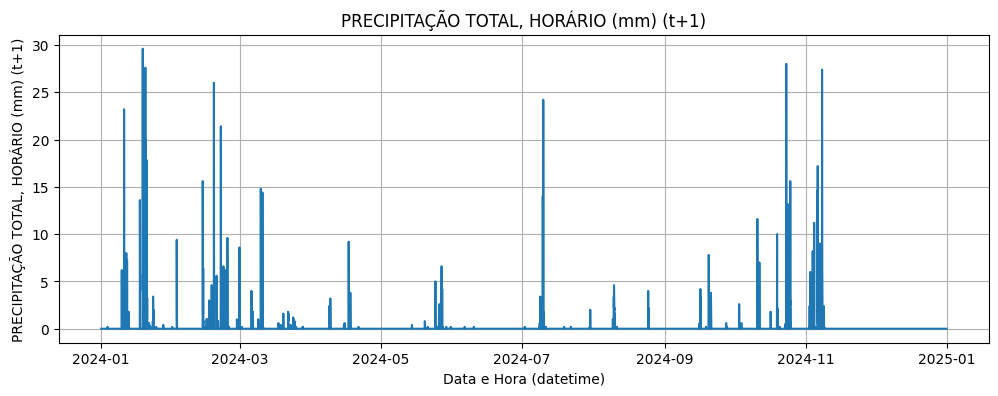

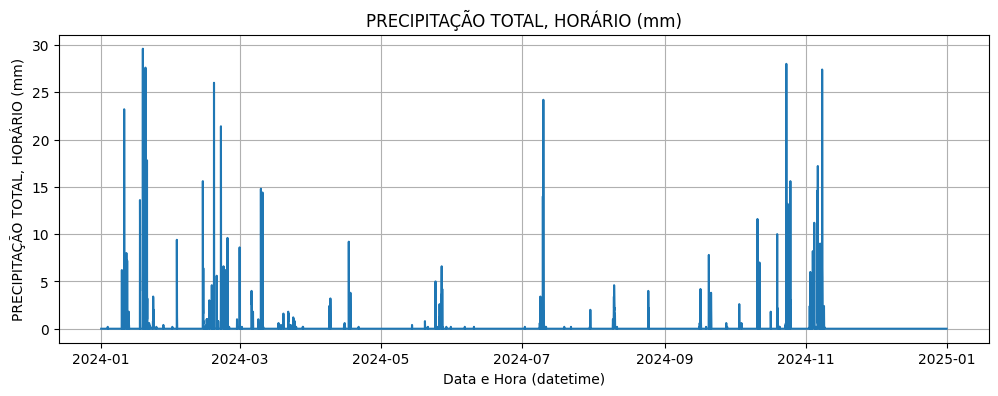

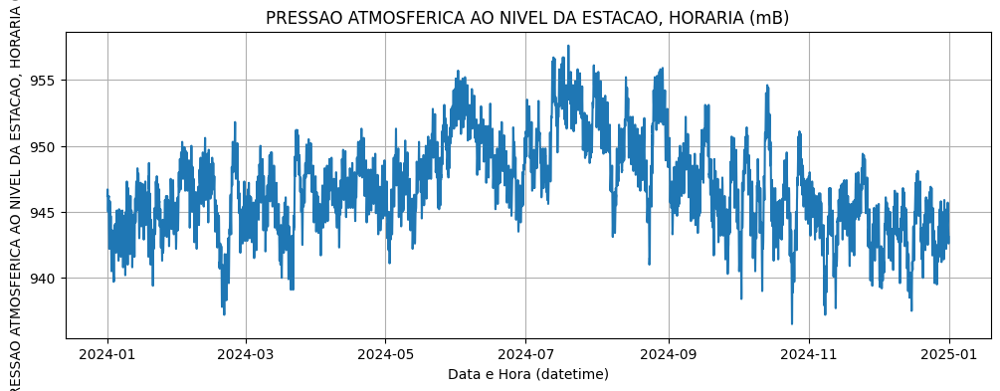

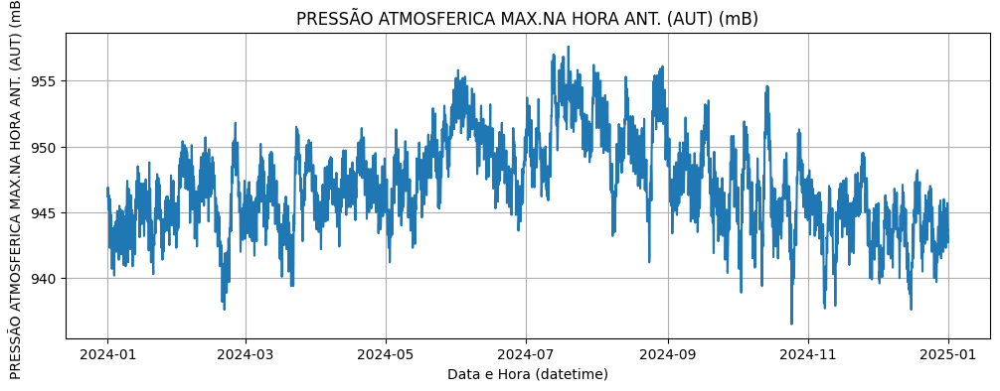

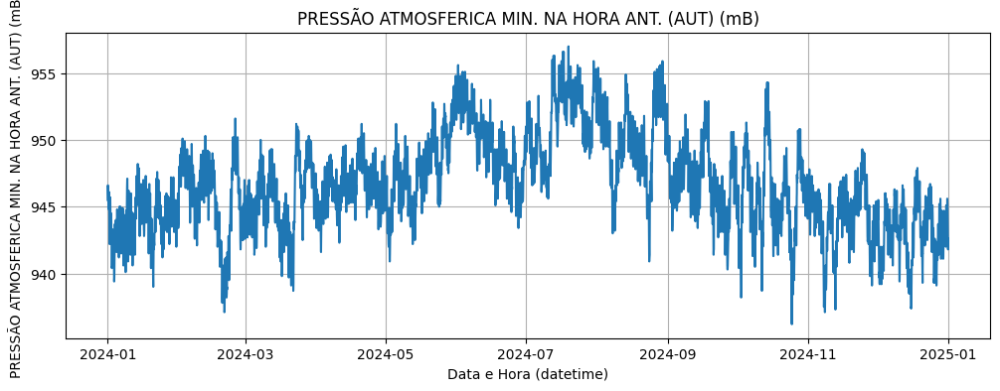

...

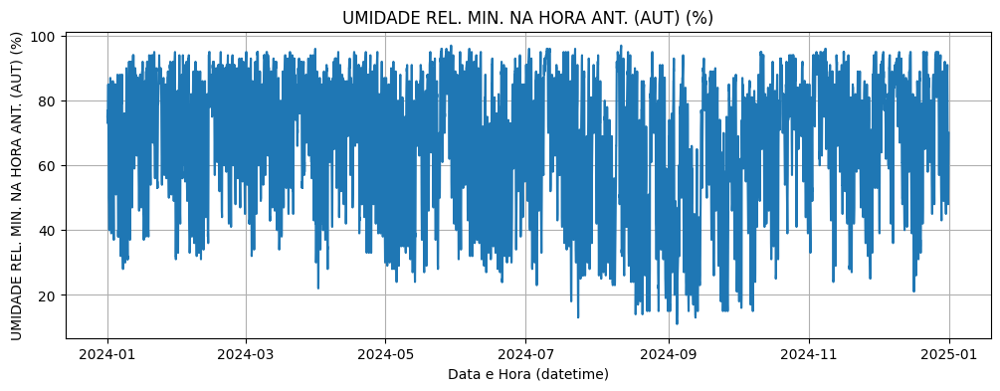

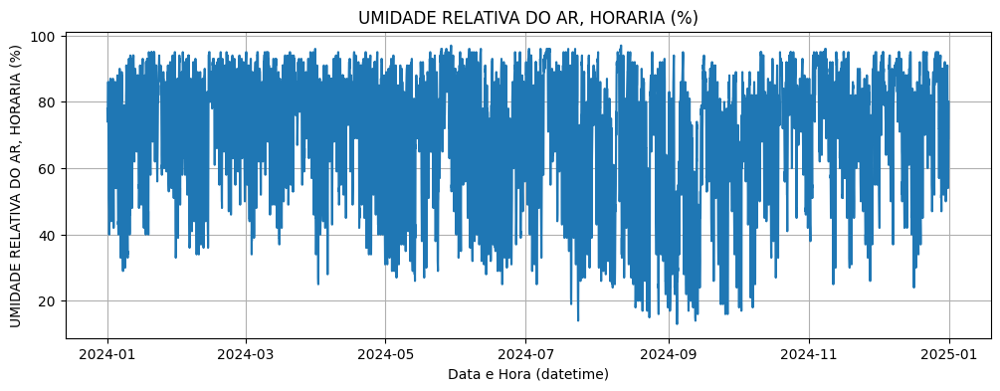

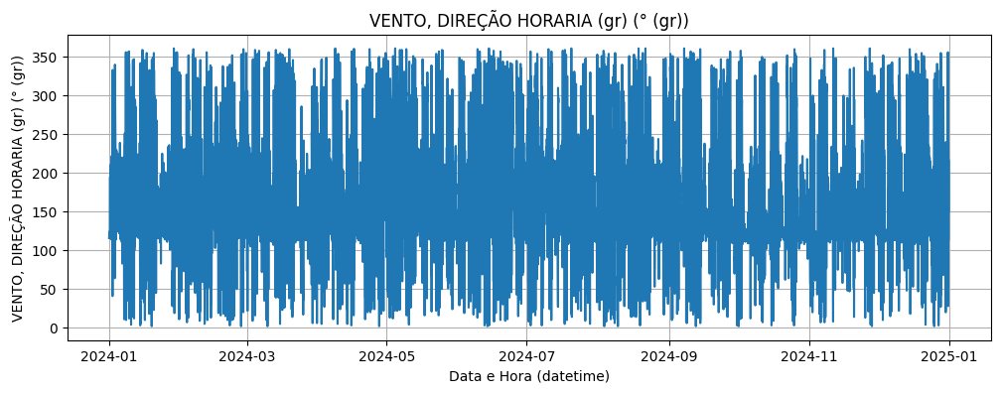

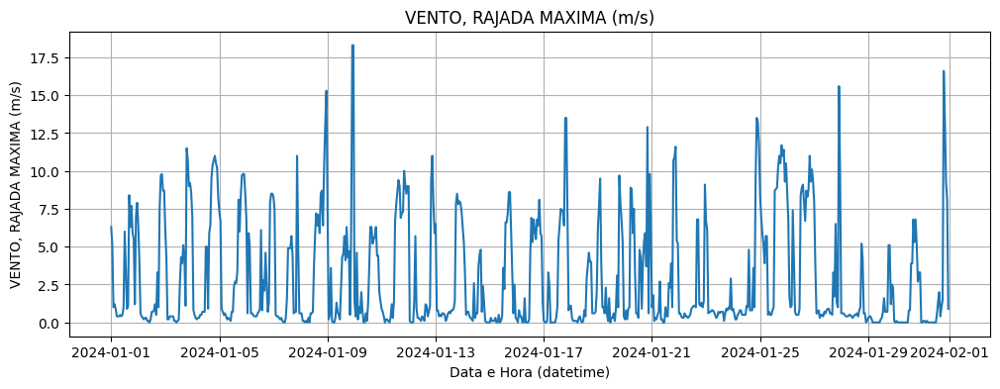

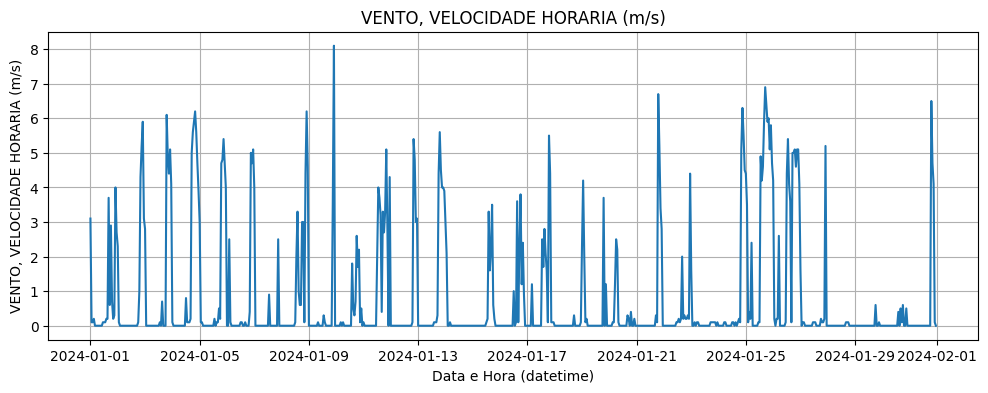

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8783 entries, 2024-01-01 00:00:00 to 2024-12-31 22:00:00
Data columns (total 18 columns):
 #   Column                                                 Non-Null Count  Dtype  
---  ------                                                 --------------  -----  
 0   PRECIPITAÇÃO TOTAL, HORÁRIO (mm) (t+1)                 8783 non-null   float64
 1   PRECIPITAÇÃO TOTAL, HORÁRIO (mm)                       8783 non-null   float64
 2   PRESSAO ATMOSFERICA AO NIVEL DA ESTACAO, HORARIA (mB)  8783 non-null   float64
 3   PRESSÃO ATMOSFERICA MAX.NA HORA ANT. (AUT) (mB)        8783 non-null   float64
 4   PRESSÃO ATMOSFERICA MIN. NA HORA ANT. (AUT) (mB)       8783 non-null   float64
 5   RADIACAO GLOBAL (Kj/m²)                                8783 non-null   float64
 6   TEMPERATURA DO AR - BULBO SECO, HORARIA (°C)           8783 non-null   float64
 7   TEMPERATURA DO PONTO DE ORVALHO (°C)                   8783 non-null   float64
 8   TEMPERATURA 

In [109]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(df.index, df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

df.info()

In [110]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2024'
output_dir = 'Datasets tratados/2024'

os.makedirs(output_dir, exist_ok=True)

df.to_csv(os.path.join(output_dir, 'Processed_Data_2024-A713_Sorocaba_Ipero.csv'), index=False)


# 1. Client-1 Dataset (Cerquilho-ETEC)⭐

## Data collection and pre-processing

In [111]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0350 - Cerquilho-ETEC/2024/INMET_SE_SP_V0350_CERQUILHO-ETEC-Dataset_01-01-2024_A_31-12-2024.csv'
file_path = 'Datasets Brutos/Estacao_V0350 - Cerquilho-ETEC/2024/INMET_SE_SP_V0350_CERQUILHO-ETEC-Dataset_01-01-2024_A_31-12-2024.csv'

# Upload CSV file into DataFrame
client1_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [112]:
print("Dataframe format:")
print(f" ↪Linhas: {client1_df.shape[0]} \n ↪Colunas: {client1_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client1_df.head()

Dataframe format:
 ↪Linhas: 8784 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2024,0,23.0,NaN,NaN,72.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,01/01/2024,100,22.2,NaN,NaN,74.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,01/01/2024,200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,01/01/2024,300,21.7,NaN,NaN,76.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,01/01/2024,400,21.7,NaN,NaN,75.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [113]:
# Data general info
print("General Dataset Information:")
print(client1_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8784 entries, 0 to 8783
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8784 non-null   object 
 1   Hora (UTC)            8784 non-null   int64  
 2   Temp. Ins. (C)        8352 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8352 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      8352 non-null   float

In [114]:
print("Descriptive statistics:")
client1_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8784.000000,8352.000000,0.0,0.0,8352.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8352.000000,0.0,0.0,0.0,8351.000000
mean,1150.000000,23.561015,NaN,NaN,70.756753,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.079610,NaN,NaN,NaN,0.094456
std,692.258061,5.752756,NaN,NaN,19.164297,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.249679,NaN,NaN,NaN,0.860222
min,0.000000,5.300000,NaN,NaN,17.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,19.700000,NaN,NaN,55.975000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
50%,1150.000000,23.100000,NaN,NaN,75.300000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
75%,1725.000000,27.800000,NaN,NaN,87.200000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
max,2300.000000,39.500000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.800000,NaN,NaN,NaN,26.600000


In [115]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client1_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client1_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client1_df['Hora (UTC)'] = client1_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client1_df['Hora Datetime'] = pd.to_datetime(client1_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client1_df['Data e Hora (datetime)'] = client1_df['ï»¿"Data"'] + ' ' + client1_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client1_df['Data e Hora (datetime)'] = pd.to_datetime(client1_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client1_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_19572\2562077892.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client1_df.loc[0, 'Hora (UTC)'] = modified_value


0   2024-01-01 00:00:00
1   2024-01-01 01:00:00
2   2024-01-01 02:00:00
3   2024-01-01 03:00:00
4   2024-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [116]:
client1_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2024,0000,23.0,NaN,NaN,72.8,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,00:00:00,2024-01-01 00:00:00
1,01/01/2024,0100,22.2,NaN,NaN,74.7,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,01:00:00,2024-01-01 01:00:00
2,01/01/2024,0200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,02:00:00,2024-01-01 02:00:00
3,01/01/2024,0300,21.7,NaN,NaN,76.4,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,03:00:00,2024-01-01 03:00:00
4,01/01/2024,0400,21.7,NaN,NaN,75.6,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,04:00:00,2024-01-01 04:00:00


In [117]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client1_df = client1_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client1_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client1_df.pop(column)          # remove the column
client1_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client1_df.shape)

client1_df.head()

DataFrame format:
(8784, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2024-01-01 00:00:00,23.0,NaN,NaN,72.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,2024-01-01 01:00:00,22.2,NaN,NaN,74.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,2024-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2024-01-01 03:00:00,21.7,NaN,NaN,76.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,2024-01-01 04:00:00,21.7,NaN,NaN,75.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [118]:
# Indexing of the 'Datetime' Date and Time
client1_df.set_index('Data e Hora (datetime)', inplace=True)

client1_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2024-01-01 00:00:00,23.0,NaN,NaN,72.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 01:00:00,22.2,NaN,NaN,74.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-01-01 03:00:00,21.7,NaN,NaN,76.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 04:00:00,21.7,NaN,NaN,75.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [119]:
# Check missing values
print("Amount of missing values per column:")
print(client1_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client1_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           432
Temp. Max. (C)          8784
Temp. Min. (C)          8784
Umi. Ins. (%)            432
Umi. Max. (%)           8784
Umi. Min. (%)           8784
Pto Orvalho Ins. (C)    8784
Pto Orvalho Max. (C)    8784
Pto Orvalho Min. (C)    8784
Pressao Ins. (hPa)      8784
Pressao Max. (hPa)      8784
Pressao Min. (hPa)      8784
Vel. Vento (m/s)         432
Dir. Vento (m/s)        8784
Raj. Vento (m/s)        8784
Radiacao (KJ/mÂ²)       8784
Chuva (mm)               433
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            4.918033
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)             4.918033
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [120]:
# Dropping columns with 100% missing values
client1_df = client1_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client1_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      4.918033
Umi. Ins. (%)       4.918033
Vel. Vento (m/s)    4.918033
Chuva (mm)          4.929417
dtype: float64


In [121]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [122]:
client1_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,23.0,72.8,0.0,0.0
2024-01-01 01:00:00,22.2,74.7,0.0,0.0
2024-01-01 02:00:00,NaN,NaN,NaN,NaN
2024-01-01 03:00:00,21.7,76.4,0.0,0.0
2024-01-01 04:00:00,21.7,75.6,0.0,0.0


In [123]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [124]:
# Filters the data by interval
client1_df_intervalo = client1_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

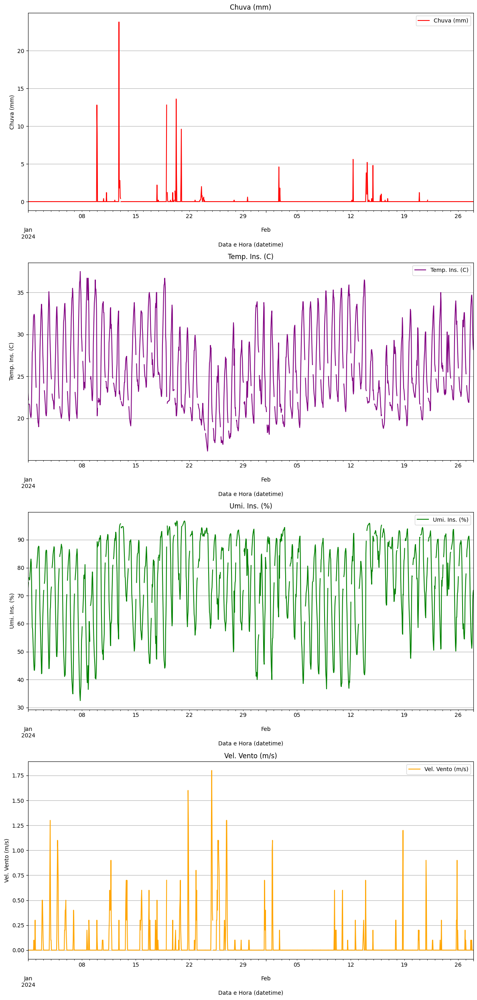

In [125]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client1_df_intervalo.plot(y=client1_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client1_df_intervalo.columns[3])
client1_df_intervalo.plot(y=client1_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client1_df_intervalo.columns[0])
client1_df_intervalo.plot(y=client1_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client1_df_intervalo.columns[1])
client1_df_intervalo.plot(y=client1_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client1_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client1_df_intervalo.columns[3])
axes[1].set_ylabel(client1_df_intervalo.columns[0])
axes[2].set_ylabel(client1_df_intervalo.columns[1])
axes[3].set_ylabel(client1_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

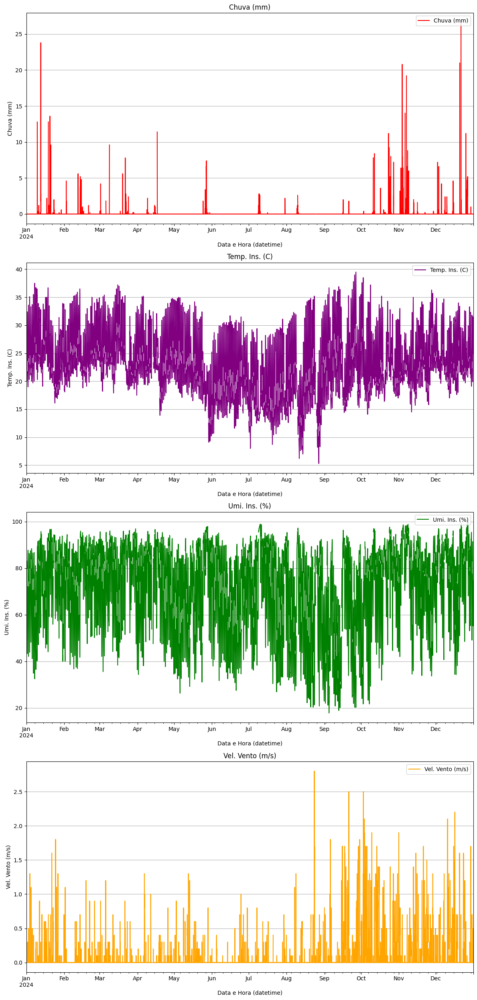

In [126]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client1_df.plot(y=client1_df.columns[3], ax=axes[0], color='red', legend=True, title=client1_df.columns[3])
client1_df.plot(y=client1_df.columns[0], ax=axes[1], color='purple', legend=True, title=client1_df.columns[0])
client1_df.plot(y=client1_df.columns[1], ax=axes[2], color='green', legend=True, title=client1_df.columns[1])
client1_df.plot(y=client1_df.columns[2], ax=axes[3], color='orange', legend=True, title=client1_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client1_df.columns[3])
axes[1].set_ylabel(client1_df.columns[0])
axes[2].set_ylabel(client1_df.columns[1])
axes[3].set_ylabel(client1_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [127]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client1_df.columns:
    if client1_df[column].isnull().any():
        client1_df[column] = client1_df[column].interpolate(method='linear')  # Interpolação linear

In [128]:
# Check missing values
print("Amount of missing values per column:")
print(client1_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client1_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [129]:
# Filters the data by interval
client1_df_intervalo = client1_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

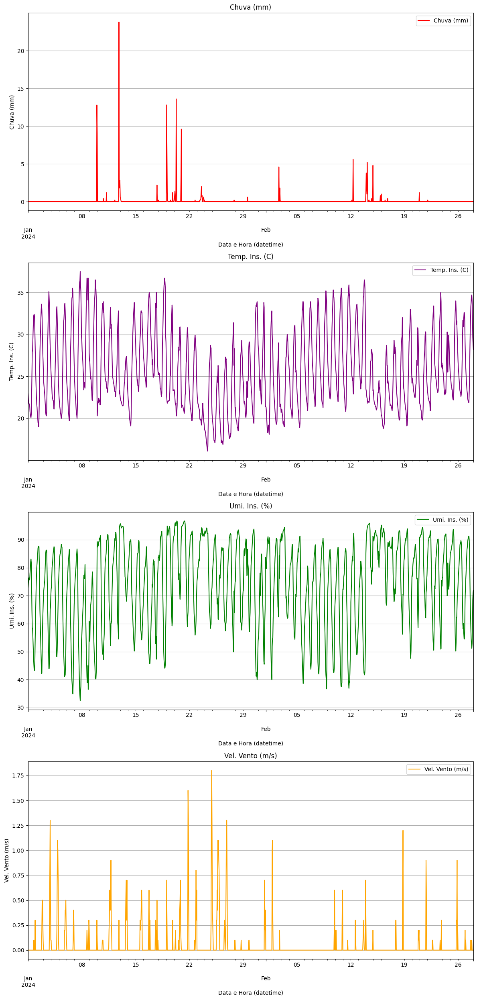

In [130]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client1_df_intervalo.plot(y=client1_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client1_df_intervalo.columns[3])
client1_df_intervalo.plot(y=client1_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client1_df_intervalo.columns[0])
client1_df_intervalo.plot(y=client1_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client1_df_intervalo.columns[1])
client1_df_intervalo.plot(y=client1_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client1_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client1_df_intervalo.columns[3])
axes[1].set_ylabel(client1_df_intervalo.columns[0])
axes[2].set_ylabel(client1_df_intervalo.columns[1])
axes[3].set_ylabel(client1_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

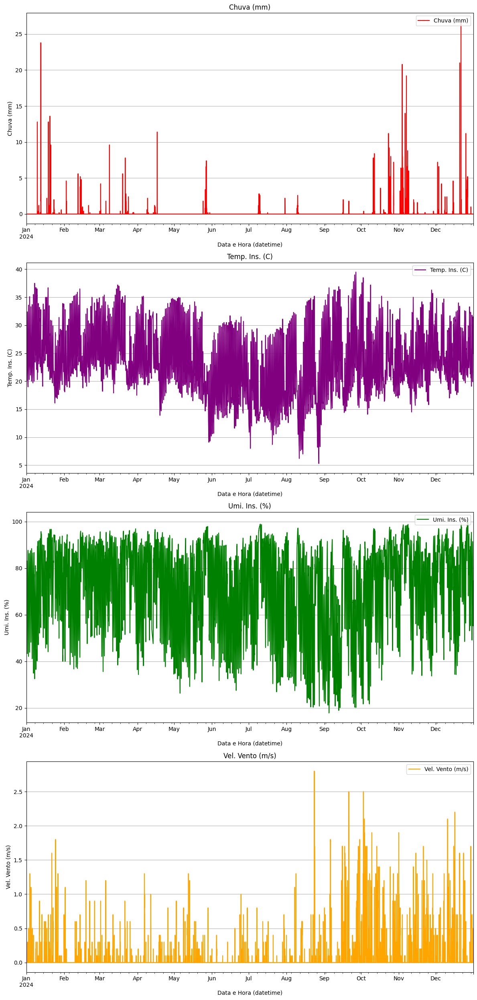

In [131]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client1_df.plot(y=client1_df.columns[3], ax=axes[0], color='red', legend=True, title=client1_df.columns[3])
client1_df.plot(y=client1_df.columns[0], ax=axes[1], color='purple', legend=True, title=client1_df.columns[0])
client1_df.plot(y=client1_df.columns[1], ax=axes[2], color='green', legend=True, title=client1_df.columns[1])
client1_df.plot(y=client1_df.columns[2], ax=axes[3], color='orange', legend=True, title=client1_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client1_df.columns[3])
axes[1].set_ylabel(client1_df.columns[0])
axes[2].set_ylabel(client1_df.columns[1])
axes[3].set_ylabel(client1_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [132]:
client1_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,23.00,72.80,0.0,0.0
2024-01-01 01:00:00,22.20,74.70,0.0,0.0
2024-01-01 02:00:00,21.95,75.55,0.0,0.0
2024-01-01 03:00:00,21.70,76.40,0.0,0.0
2024-01-01 04:00:00,21.70,75.60,0.0,0.0


In [133]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client1_df.pop(column)          # remove the column
client1_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client1_df.shape)

client1_df.head()

DataFrame format:
(8784, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,0.0,23.00,72.80,0.0
2024-01-01 01:00:00,0.0,22.20,74.70,0.0
2024-01-01 02:00:00,0.0,21.95,75.55,0.0
2024-01-01 03:00:00,0.0,21.70,76.40,0.0
2024-01-01 04:00:00,0.0,21.70,75.60,0.0


In [134]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client1_df['Chuva (mm) (t+1)'] = client1_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client1_df.pop(target_column)
client1_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client1_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client1_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2024-12-31 18:00:00,0.0,0.0,29.6,58.8,0.0
2024-12-31 19:00:00,0.0,0.0,29.0,61.3,0.0
2024-12-31 20:00:00,0.0,0.0,30.3,60.0,0.3
2024-12-31 21:00:00,0.0,0.0,28.6,60.6,0.5
2024-12-31 22:00:00,0.0,0.0,26.7,64.5,0.3


## Saving data as `.csv`

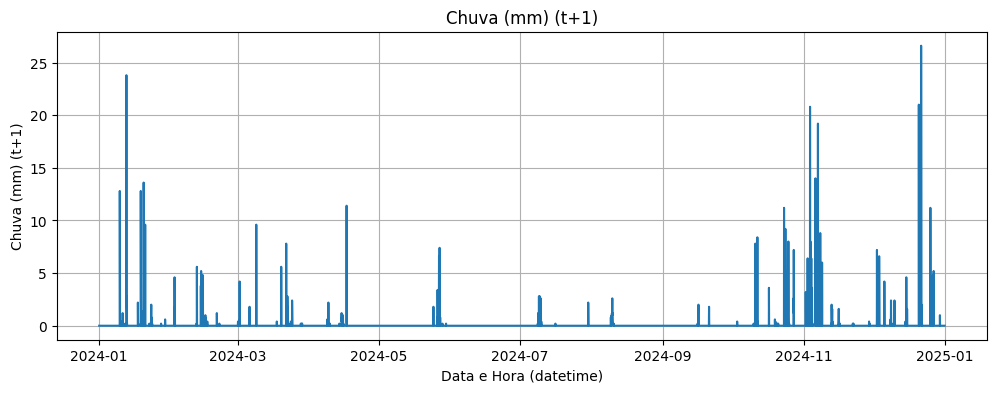

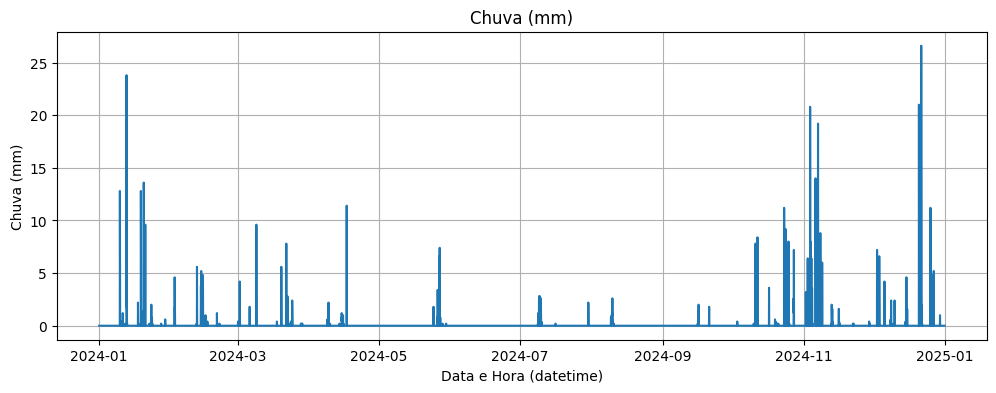

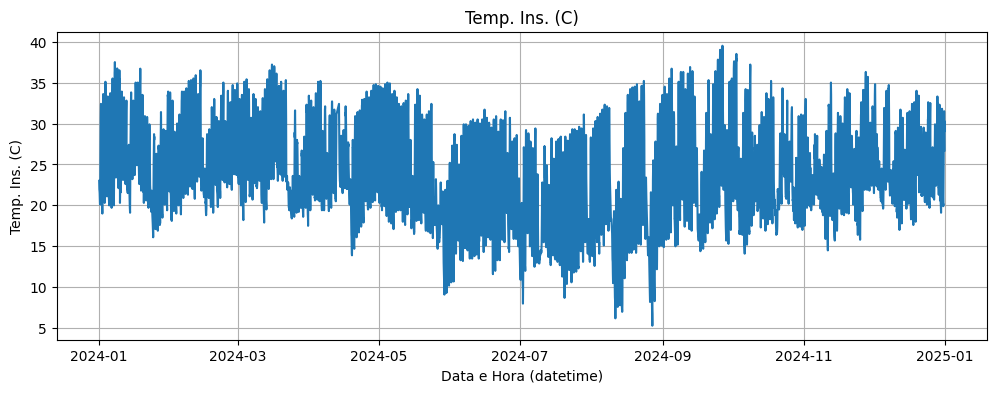

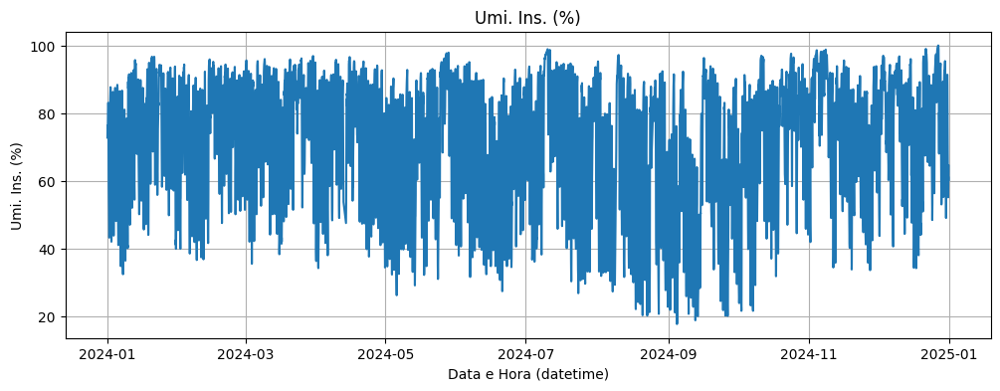

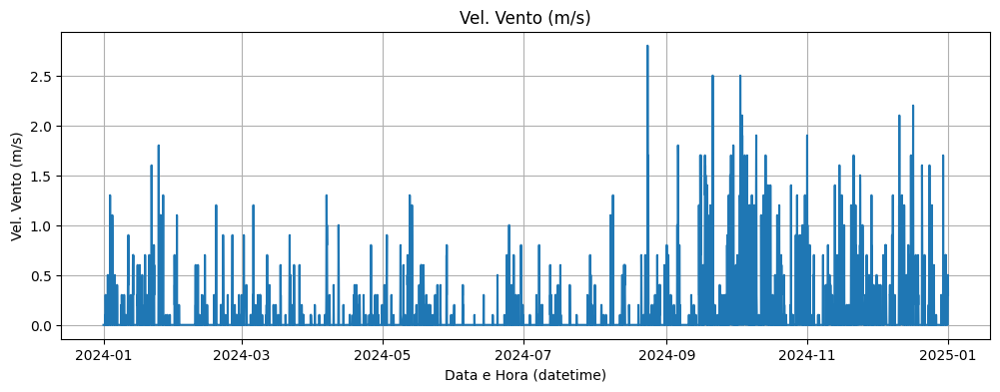

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8783 entries, 2024-01-01 00:00:00 to 2024-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8783 non-null   float64
 1   Chuva (mm)        8783 non-null   float64
 2   Temp. Ins. (C)    8783 non-null   float64
 3   Umi. Ins. (%)     8783 non-null   float64
 4   Vel. Vento (m/s)  8783 non-null   float64
dtypes: float64(5)
memory usage: 411.7 KB


In [135]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client1_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client1_df.index, client1_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client1_df.info()

In [136]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2024'
output_dir = 'Datasets tratados/2024'

os.makedirs(output_dir, exist_ok=True)

client1_df.to_csv(os.path.join(output_dir, 'Processed_Data_2024-Client-1_V0350_Cerquilho-ETEC.csv'), index=False)


# 2. Client-2 Dataset (Ibiuna)⭐

## Data collection and pre-processing

In [137]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0377 - Ibiuna/2024/INMET_SE_SP_V0377_IBIUNA-Dataset_01-01-2024_A_31-12-2024.csv'
file_path = 'Datasets Brutos/Estacao_V0377 - Ibiuna/2024/INMET_SE_SP_V0377_IBIUNA-Dataset_01-01-2024_A_31-12-2024.csv'

# Upload CSV file into DataFrame
client2_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [138]:
print("Dataframe format:")
print(f" ↪Linhas: {client2_df.shape[0]} \n ↪Colunas: {client2_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client2_df.head()

Dataframe format:
 ↪Linhas: 8784 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2024,0,18.5,NaN,NaN,83.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,01/01/2024,100,18.5,NaN,NaN,83.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,01/01/2024,200,18.5,NaN,NaN,85.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,01/01/2024,300,18.5,NaN,NaN,85.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,01/01/2024,400,18.3,NaN,NaN,82.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [139]:
# Data general info
print("General Dataset Information:")
print(client2_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8784 entries, 0 to 8783
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8784 non-null   object 
 1   Hora (UTC)            8784 non-null   int64  
 2   Temp. Ins. (C)        8272 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8272 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      8272 non-null   float

In [140]:
print("Descriptive statistics:")
client2_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8784.000000,8272.000000,0.0,0.0,8272.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8272.000000,0.0,0.0,0.0,8272.000000
mean,1150.000000,19.683511,NaN,NaN,78.777382,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.638975,NaN,NaN,NaN,0.137621
std,692.258061,5.180286,NaN,NaN,18.961389,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.106227,NaN,NaN,NaN,1.045857
min,0.000000,2.800000,NaN,NaN,18.400000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,16.200000,NaN,NaN,67.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
50%,1150.000000,19.400000,NaN,NaN,86.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
75%,1725.000000,23.100000,NaN,NaN,93.300000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.100000,NaN,NaN,NaN,0.000000
max,2300.000000,34.500000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.800000,NaN,NaN,NaN,31.400000


In [141]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client2_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client2_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client2_df['Hora (UTC)'] = client2_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client2_df['Hora Datetime'] = pd.to_datetime(client2_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client2_df['Data e Hora (datetime)'] = client2_df['ï»¿"Data"'] + ' ' + client2_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client2_df['Data e Hora (datetime)'] = pd.to_datetime(client2_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client2_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_19572\2898631049.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client2_df.loc[0, 'Hora (UTC)'] = modified_value


0   2024-01-01 00:00:00
1   2024-01-01 01:00:00
2   2024-01-01 02:00:00
3   2024-01-01 03:00:00
4   2024-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [142]:
client2_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2024,0000,18.5,NaN,NaN,83.6,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,00:00:00,2024-01-01 00:00:00
1,01/01/2024,0100,18.5,NaN,NaN,83.2,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,01:00:00,2024-01-01 01:00:00
2,01/01/2024,0200,18.5,NaN,NaN,85.2,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,02:00:00,2024-01-01 02:00:00
3,01/01/2024,0300,18.5,NaN,NaN,85.3,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,03:00:00,2024-01-01 03:00:00
4,01/01/2024,0400,18.3,NaN,NaN,82.9,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,04:00:00,2024-01-01 04:00:00


In [143]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client2_df = client2_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client2_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client2_df.pop(column)          # remove the column
client2_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client2_df.shape)

client2_df.head()

DataFrame format:
(8784, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2024-01-01 00:00:00,18.5,NaN,NaN,83.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,2024-01-01 01:00:00,18.5,NaN,NaN,83.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,2024-01-01 02:00:00,18.5,NaN,NaN,85.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,2024-01-01 03:00:00,18.5,NaN,NaN,85.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,2024-01-01 04:00:00,18.3,NaN,NaN,82.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [144]:
# Indexing of the 'Datetime' Date and Time
client2_df.set_index('Data e Hora (datetime)', inplace=True)

client2_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2024-01-01 00:00:00,18.5,NaN,NaN,83.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 01:00:00,18.5,NaN,NaN,83.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 02:00:00,18.5,NaN,NaN,85.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 03:00:00,18.5,NaN,NaN,85.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 04:00:00,18.3,NaN,NaN,82.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [145]:
# Check missing values
print("Amount of missing values per column:")
print(client2_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client2_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           512
Temp. Max. (C)          8784
Temp. Min. (C)          8784
Umi. Ins. (%)            512
Umi. Max. (%)           8784
Umi. Min. (%)           8784
Pto Orvalho Ins. (C)    8784
Pto Orvalho Max. (C)    8784
Pto Orvalho Min. (C)    8784
Pressao Ins. (hPa)      8784
Pressao Max. (hPa)      8784
Pressao Min. (hPa)      8784
Vel. Vento (m/s)         512
Dir. Vento (m/s)        8784
Raj. Vento (m/s)        8784
Radiacao (KJ/mÂ²)       8784
Chuva (mm)               512
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            5.82878
Temp. Max. (C)          100.00000
Temp. Min. (C)          100.00000
Umi. Ins. (%)             5.82878
Umi. Max. (%)           100.00000
Umi. Min. (%)           100.00000
Pto Orvalho Ins. (C)    100.00000
Pto Orvalho Max. (C)    100.00000
Pto Orvalho Min. (C)    100.00000
Pressao Ins. (hPa)      100.00000
Pressao Max. (hPa)      100.00000
Pressao Min. (hPa)      100.00000
Vel. Vento 

In [146]:
# Dropping columns with 100% missing values
client2_df = client2_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client2_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      5.82878
Umi. Ins. (%)       5.82878
Vel. Vento (m/s)    5.82878
Chuva (mm)          5.82878
dtype: float64


In [147]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [148]:
client2_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,18.5,83.6,0.0,0.0
2024-01-01 01:00:00,18.5,83.2,0.0,0.0
2024-01-01 02:00:00,18.5,85.2,0.0,0.0
2024-01-01 03:00:00,18.5,85.3,0.0,0.0
2024-01-01 04:00:00,18.3,82.9,0.0,0.0


In [149]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [150]:
# Filters the data by interval
client2_df_intervalo = client2_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

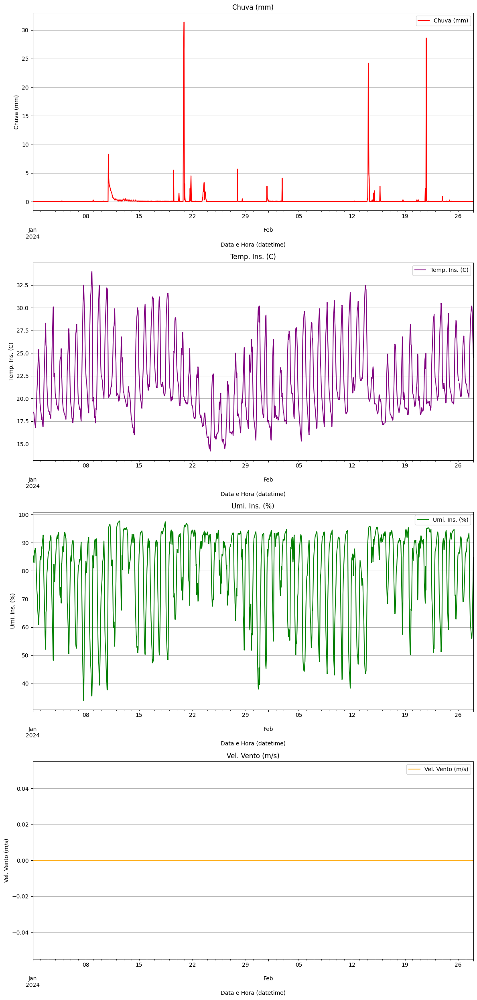

In [151]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df_intervalo.plot(y=client2_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client2_df_intervalo.columns[3])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df_intervalo.columns[0])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client2_df_intervalo.columns[1])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df_intervalo.columns[3])
axes[1].set_ylabel(client2_df_intervalo.columns[0])
axes[2].set_ylabel(client2_df_intervalo.columns[1])
axes[3].set_ylabel(client2_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

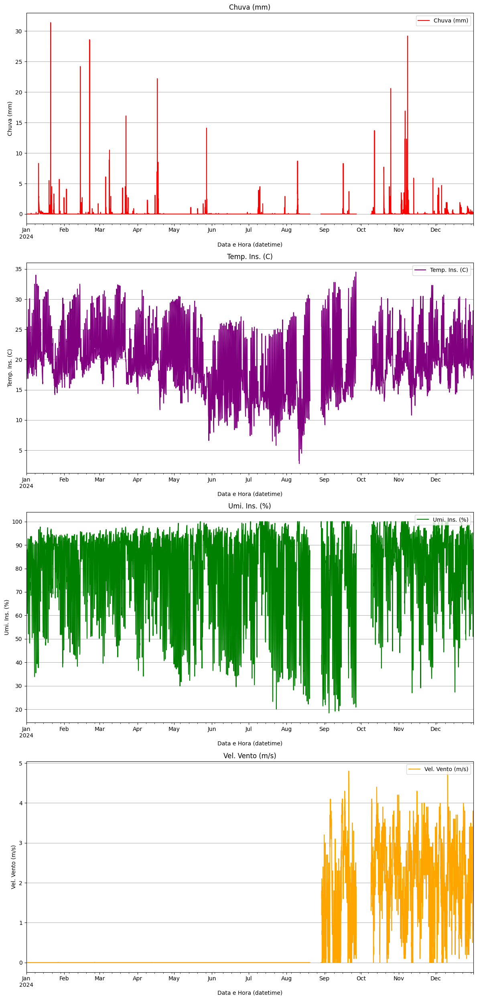

In [152]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df.plot(y=client2_df.columns[3], ax=axes[0], color='red', legend=True, title=client2_df.columns[3])
client2_df.plot(y=client2_df.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df.columns[0])
client2_df.plot(y=client2_df.columns[1], ax=axes[2], color='green', legend=True, title=client2_df.columns[1])
client2_df.plot(y=client2_df.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df.columns[3])
axes[1].set_ylabel(client2_df.columns[0])
axes[2].set_ylabel(client2_df.columns[1])
axes[3].set_ylabel(client2_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [153]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client2_df.columns:
    if client2_df[column].isnull().any():
        client2_df[column] = client2_df[column].interpolate(method='linear')  # Interpolação linear

In [154]:
# Check missing values
print("Amount of missing values per column:")
print(client2_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client2_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [155]:
# Filters the data by interval
client2_df_intervalo = client2_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

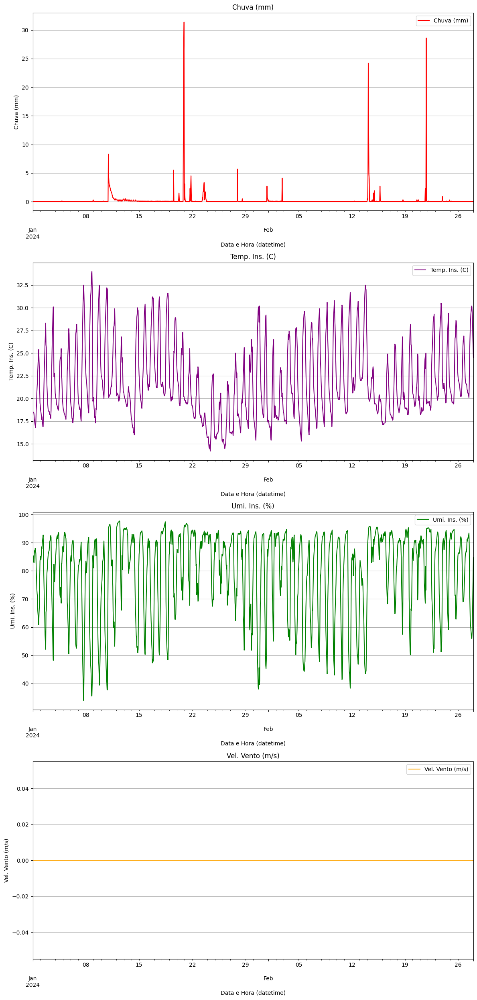

In [156]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df_intervalo.plot(y=client2_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client2_df_intervalo.columns[3])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df_intervalo.columns[0])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client2_df_intervalo.columns[1])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df_intervalo.columns[3])
axes[1].set_ylabel(client2_df_intervalo.columns[0])
axes[2].set_ylabel(client2_df_intervalo.columns[1])
axes[3].set_ylabel(client2_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

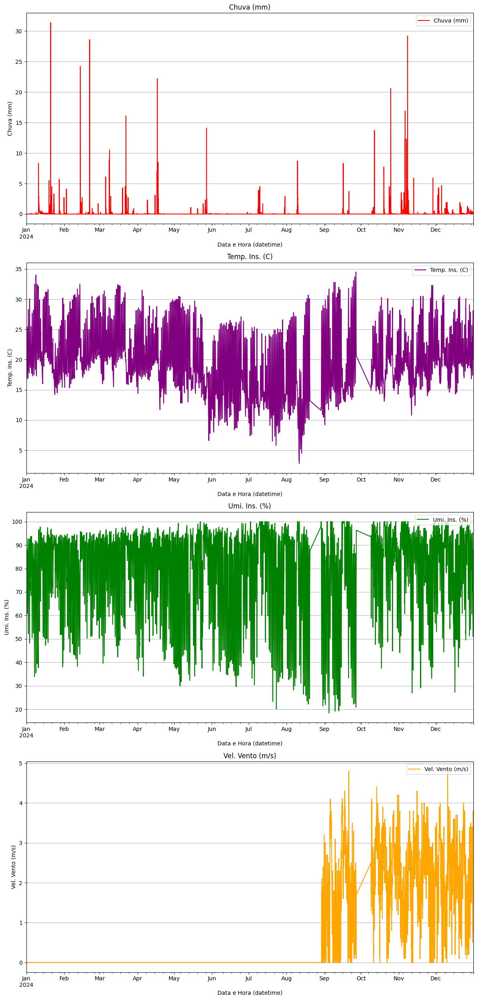

In [157]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df.plot(y=client2_df.columns[3], ax=axes[0], color='red', legend=True, title=client2_df.columns[3])
client2_df.plot(y=client2_df.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df.columns[0])
client2_df.plot(y=client2_df.columns[1], ax=axes[2], color='green', legend=True, title=client2_df.columns[1])
client2_df.plot(y=client2_df.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df.columns[3])
axes[1].set_ylabel(client2_df.columns[0])
axes[2].set_ylabel(client2_df.columns[1])
axes[3].set_ylabel(client2_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [158]:
client2_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,18.5,83.6,0.0,0.0
2024-01-01 01:00:00,18.5,83.2,0.0,0.0
2024-01-01 02:00:00,18.5,85.2,0.0,0.0
2024-01-01 03:00:00,18.5,85.3,0.0,0.0
2024-01-01 04:00:00,18.3,82.9,0.0,0.0


In [159]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client2_df.pop(column)          # remove the column
client2_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client2_df.shape)

client2_df.head()

DataFrame format:
(8784, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,0.0,18.5,83.6,0.0
2024-01-01 01:00:00,0.0,18.5,83.2,0.0
2024-01-01 02:00:00,0.0,18.5,85.2,0.0
2024-01-01 03:00:00,0.0,18.5,85.3,0.0
2024-01-01 04:00:00,0.0,18.3,82.9,0.0


In [160]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client2_df['Chuva (mm) (t+1)'] = client2_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client2_df.pop(target_column)
client2_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client2_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client2_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2024-12-31 18:00:00,0.3,0.3,23.4,73.2,3.8
2024-12-31 19:00:00,0.1,0.3,21.8,81.8,3.0
2024-12-31 20:00:00,0.1,0.1,20.8,87.9,2.0
2024-12-31 21:00:00,0.1,0.1,20.8,86.8,2.4
2024-12-31 22:00:00,0.1,0.1,20.7,85.8,2.3


## Saving data as `.csv`

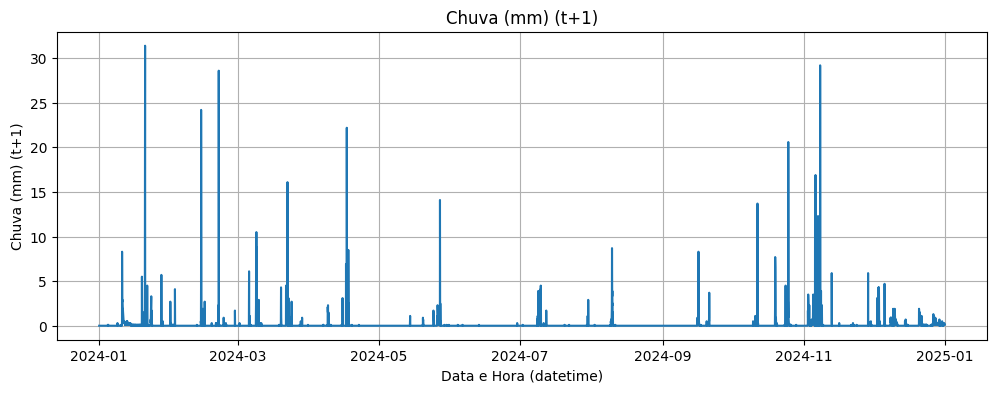

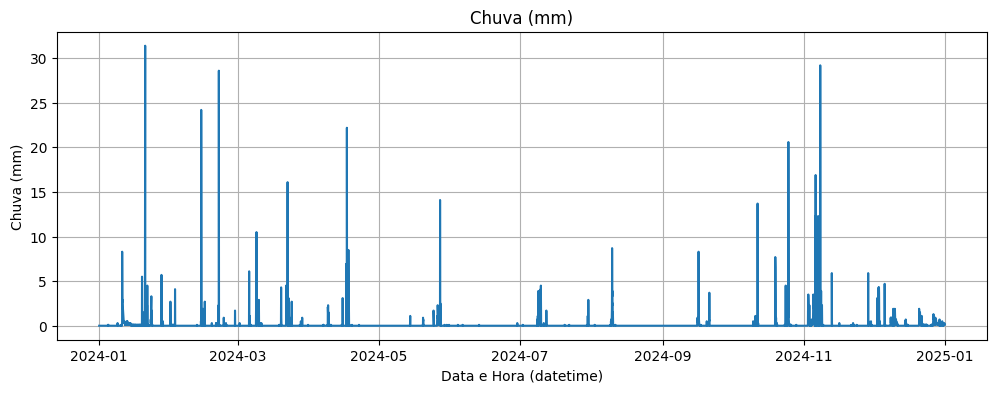

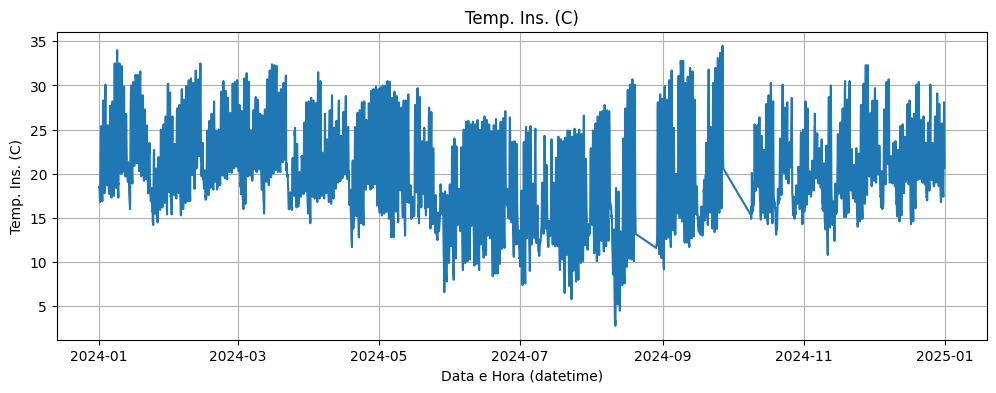

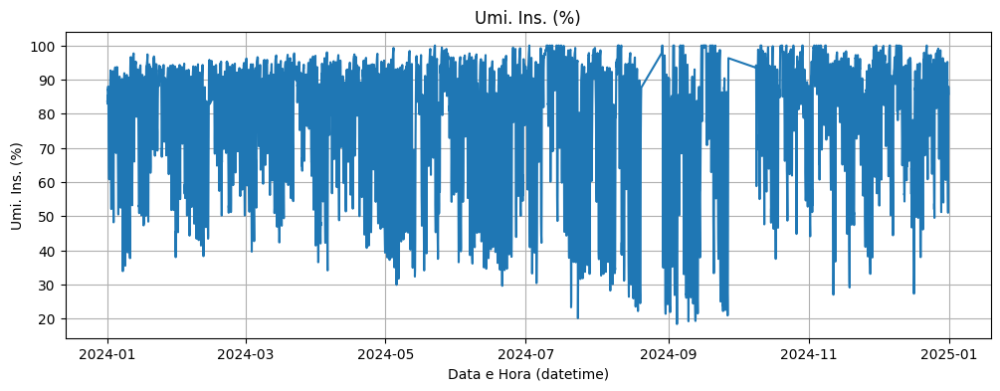

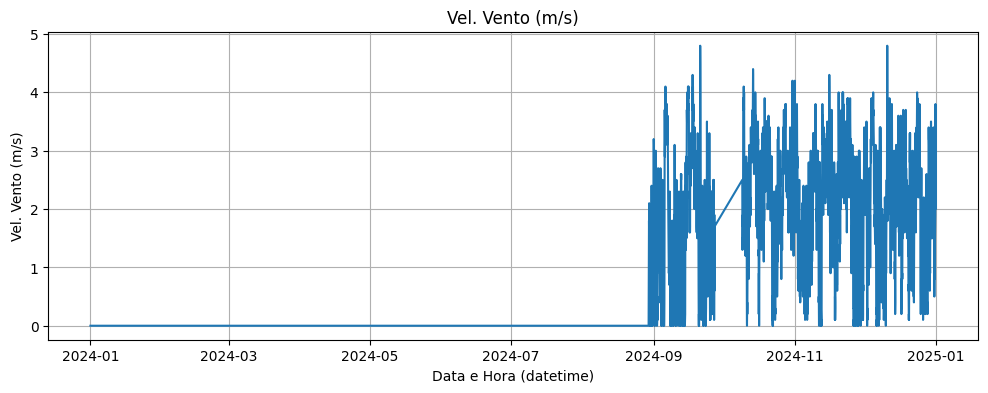

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8783 entries, 2024-01-01 00:00:00 to 2024-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8783 non-null   float64
 1   Chuva (mm)        8783 non-null   float64
 2   Temp. Ins. (C)    8783 non-null   float64
 3   Umi. Ins. (%)     8783 non-null   float64
 4   Vel. Vento (m/s)  8783 non-null   float64
dtypes: float64(5)
memory usage: 411.7 KB


In [161]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client2_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client2_df.index, client2_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client2_df.info()

In [162]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2024'
output_dir = 'Datasets tratados/2024'

os.makedirs(output_dir, exist_ok=True)

client2_df.to_csv(os.path.join(output_dir, 'Processed_Data_2024-Client-2_V0377_Ibiuna.csv'), index=False)

# 3. Client- Dataset (Itu)⭐

## Data collection and pre-processing

In [163]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0397 - Itu/2024/INMET_SE_SP_V0397_ITU-Dataset_01-01-2024_A_31-12-2024.csv'
file_path = 'Datasets Brutos/Estacao_V0397 - Itu/2024/INMET_SE_SP_V0397_ITU-Dataset_01-01-2024_A_31-12-2024.csv'

# Upload CSV file into DataFrame
client3_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [164]:
print("Dataframe format:")
print(f" ↪Linhas: {client3_df.shape[0]} \n ↪Colunas: {client3_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client3_df.head()

Dataframe format:
 ↪Linhas: 8784 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2024,0,20.6,NaN,NaN,78.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.4,NaN,NaN,NaN,0.0
1,01/01/2024,100,20.3,NaN,NaN,79.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.6,NaN,NaN,NaN,0.0
2,01/01/2024,200,20.5,NaN,NaN,78.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.6,NaN,NaN,NaN,0.0
3,01/01/2024,300,20.2,NaN,NaN,77.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.8,NaN,NaN,NaN,0.0
4,01/01/2024,400,20.0,NaN,NaN,76.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.4,NaN,NaN,NaN,0.0


In [165]:
# Data general info
print("General Dataset Information:")
print(client3_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8784 entries, 0 to 8783
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8784 non-null   object 
 1   Hora (UTC)            8784 non-null   int64  
 2   Temp. Ins. (C)        8085 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8075 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      8085 non-null   float

In [166]:
print("Descriptive statistics:")
client3_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8784.000000,8085.000000,0.0,0.0,8075.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8085.000000,0.0,0.0,0.0,8085.000000
mean,1150.000000,22.369623,NaN,NaN,71.986898,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.929103,NaN,NaN,NaN,0.156908
std,692.258061,4.954184,NaN,NaN,22.712241,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.983708,NaN,NaN,NaN,1.293756
min,0.000000,5.900000,NaN,NaN,12.900000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,19.000000,NaN,NaN,53.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.300000,NaN,NaN,NaN,0.000000
50%,1150.000000,21.900000,NaN,NaN,75.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.600000,NaN,NaN,NaN,0.000000
75%,1725.000000,25.800000,NaN,NaN,92.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.400000,NaN,NaN,NaN,0.000000
max,2300.000000,36.600000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.900000,NaN,NaN,NaN,49.500000


In [167]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client3_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client3_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client3_df['Hora (UTC)'] = client3_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client3_df['Hora Datetime'] = pd.to_datetime(client3_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client3_df['Data e Hora (datetime)'] = client3_df['ï»¿"Data"'] + ' ' + client3_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client3_df['Data e Hora (datetime)'] = pd.to_datetime(client3_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client3_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_19572\3394291670.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client3_df.loc[0, 'Hora (UTC)'] = modified_value


0   2024-01-01 00:00:00
1   2024-01-01 01:00:00
2   2024-01-01 02:00:00
3   2024-01-01 03:00:00
4   2024-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [168]:
client3_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2024,0000,20.6,NaN,NaN,78.6,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,7.4,NaN,NaN,NaN,0.0,00:00:00,2024-01-01 00:00:00
1,01/01/2024,0100,20.3,NaN,NaN,79.7,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,6.6,NaN,NaN,NaN,0.0,01:00:00,2024-01-01 01:00:00
2,01/01/2024,0200,20.5,NaN,NaN,78.3,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,5.6,NaN,NaN,NaN,0.0,02:00:00,2024-01-01 02:00:00
3,01/01/2024,0300,20.2,NaN,NaN,77.8,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,4.8,NaN,NaN,NaN,0.0,03:00:00,2024-01-01 03:00:00
4,01/01/2024,0400,20.0,NaN,NaN,76.8,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,4.4,NaN,NaN,NaN,0.0,04:00:00,2024-01-01 04:00:00


In [169]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client3_df = client3_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client3_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client3_df.pop(column)          # remove the column
client3_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client3_df.shape)

client3_df.head()

DataFrame format:
(8784, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2024-01-01 00:00:00,20.6,NaN,NaN,78.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.4,NaN,NaN,NaN,0.0
1,2024-01-01 01:00:00,20.3,NaN,NaN,79.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.6,NaN,NaN,NaN,0.0
2,2024-01-01 02:00:00,20.5,NaN,NaN,78.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.6,NaN,NaN,NaN,0.0
3,2024-01-01 03:00:00,20.2,NaN,NaN,77.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.8,NaN,NaN,NaN,0.0
4,2024-01-01 04:00:00,20.0,NaN,NaN,76.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.4,NaN,NaN,NaN,0.0


In [170]:
# Indexing of the 'Datetime' Date and Time
client3_df.set_index('Data e Hora (datetime)', inplace=True)

client3_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2024-01-01 00:00:00,20.6,NaN,NaN,78.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.4,NaN,NaN,NaN,0.0
2024-01-01 01:00:00,20.3,NaN,NaN,79.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.6,NaN,NaN,NaN,0.0
2024-01-01 02:00:00,20.5,NaN,NaN,78.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.6,NaN,NaN,NaN,0.0
2024-01-01 03:00:00,20.2,NaN,NaN,77.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.8,NaN,NaN,NaN,0.0
2024-01-01 04:00:00,20.0,NaN,NaN,76.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.4,NaN,NaN,NaN,0.0


In [171]:
# Check missing values
print("Amount of missing values per column:")
print(client3_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client3_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           699
Temp. Max. (C)          8784
Temp. Min. (C)          8784
Umi. Ins. (%)            709
Umi. Max. (%)           8784
Umi. Min. (%)           8784
Pto Orvalho Ins. (C)    8784
Pto Orvalho Max. (C)    8784
Pto Orvalho Min. (C)    8784
Pressao Ins. (hPa)      8784
Pressao Max. (hPa)      8784
Pressao Min. (hPa)      8784
Vel. Vento (m/s)         699
Dir. Vento (m/s)        8784
Raj. Vento (m/s)        8784
Radiacao (KJ/mÂ²)       8784
Chuva (mm)               699
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            7.957650
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)             8.071494
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [172]:
# Dropping columns with 100% missing values
client3_df = client3_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client3_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      7.957650
Umi. Ins. (%)       8.071494
Vel. Vento (m/s)    7.957650
Chuva (mm)          7.957650
dtype: float64


In [173]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [174]:
client3_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,20.6,78.6,7.4,0.0
2024-01-01 01:00:00,20.3,79.7,6.6,0.0
2024-01-01 02:00:00,20.5,78.3,5.6,0.0
2024-01-01 03:00:00,20.2,77.8,4.8,0.0
2024-01-01 04:00:00,20.0,76.8,4.4,0.0


In [175]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [176]:
# Filters the data by interval
client3_df_intervalo = client3_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

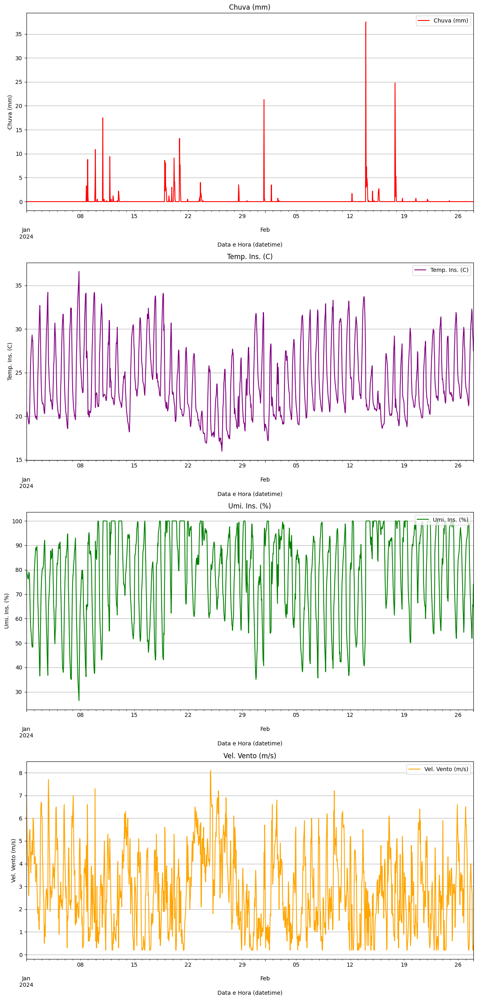

In [177]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client3_df_intervalo.plot(y=client3_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client3_df_intervalo.columns[3])
client3_df_intervalo.plot(y=client3_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client3_df_intervalo.columns[0])
client3_df_intervalo.plot(y=client3_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client3_df_intervalo.columns[1])
client3_df_intervalo.plot(y=client3_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client3_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client3_df_intervalo.columns[3])
axes[1].set_ylabel(client3_df_intervalo.columns[0])
axes[2].set_ylabel(client3_df_intervalo.columns[1])
axes[3].set_ylabel(client3_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

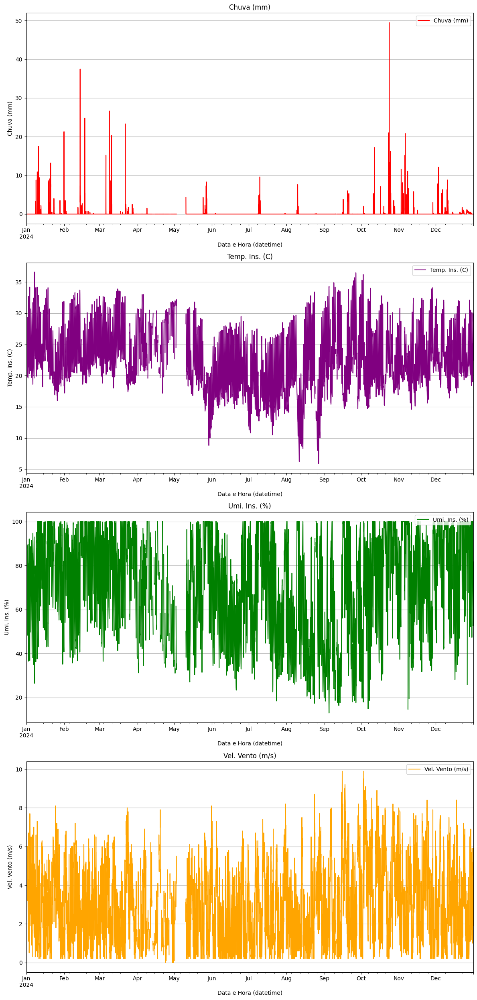

In [178]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client3_df.plot(y=client3_df.columns[3], ax=axes[0], color='red', legend=True, title=client3_df.columns[3])
client3_df.plot(y=client3_df.columns[0], ax=axes[1], color='purple', legend=True, title=client3_df.columns[0])
client3_df.plot(y=client3_df.columns[1], ax=axes[2], color='green', legend=True, title=client3_df.columns[1])
client3_df.plot(y=client3_df.columns[2], ax=axes[3], color='orange', legend=True, title=client3_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client3_df.columns[3])
axes[1].set_ylabel(client3_df.columns[0])
axes[2].set_ylabel(client3_df.columns[1])
axes[3].set_ylabel(client3_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [179]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client3_df.columns:
    if client3_df[column].isnull().any():
        client3_df[column] = client3_df[column].interpolate(method='linear')  # Interpolação linear

In [180]:
# Check missing values
print("Amount of missing values per column:")
print(client3_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client3_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [181]:
# Filters the data by interval
client3_df_intervalo = client3_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

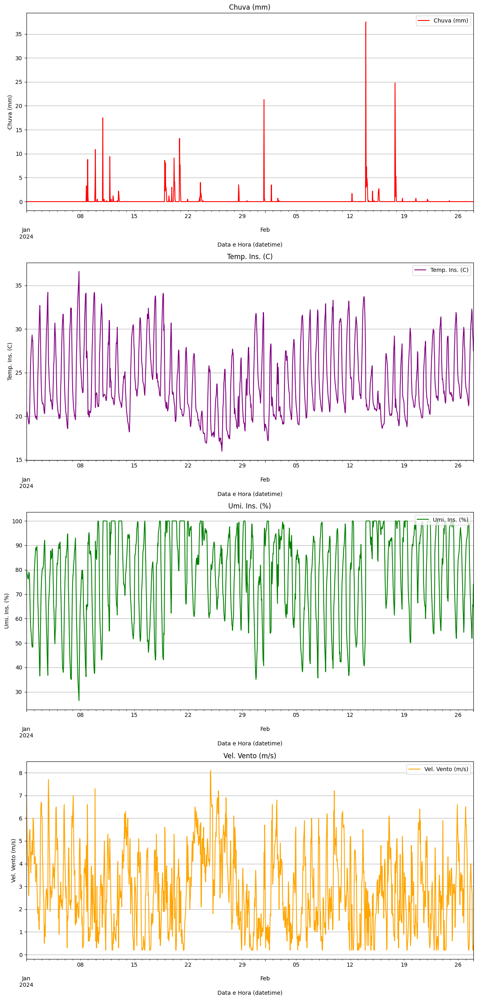

In [182]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client3_df_intervalo.plot(y=client3_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client3_df_intervalo.columns[3])
client3_df_intervalo.plot(y=client3_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client3_df_intervalo.columns[0])
client3_df_intervalo.plot(y=client3_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client3_df_intervalo.columns[1])
client3_df_intervalo.plot(y=client3_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client3_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client3_df_intervalo.columns[3])
axes[1].set_ylabel(client3_df_intervalo.columns[0])
axes[2].set_ylabel(client3_df_intervalo.columns[1])
axes[3].set_ylabel(client3_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

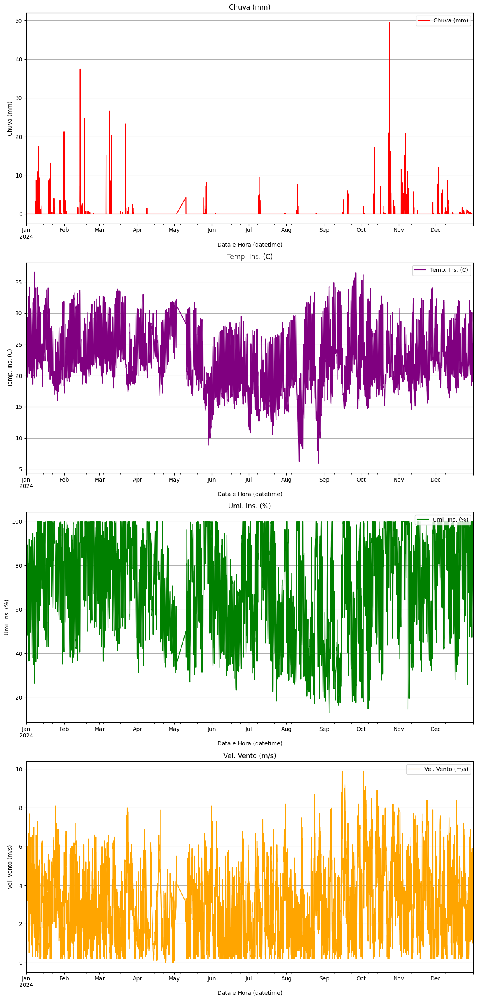

In [183]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client3_df.plot(y=client3_df.columns[3], ax=axes[0], color='red', legend=True, title=client3_df.columns[3])
client3_df.plot(y=client3_df.columns[0], ax=axes[1], color='purple', legend=True, title=client3_df.columns[0])
client3_df.plot(y=client3_df.columns[1], ax=axes[2], color='green', legend=True, title=client3_df.columns[1])
client3_df.plot(y=client3_df.columns[2], ax=axes[3], color='orange', legend=True, title=client3_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client3_df.columns[3])
axes[1].set_ylabel(client3_df.columns[0])
axes[2].set_ylabel(client3_df.columns[1])
axes[3].set_ylabel(client3_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [184]:
client3_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,20.6,78.6,7.4,0.0
2024-01-01 01:00:00,20.3,79.7,6.6,0.0
2024-01-01 02:00:00,20.5,78.3,5.6,0.0
2024-01-01 03:00:00,20.2,77.8,4.8,0.0
2024-01-01 04:00:00,20.0,76.8,4.4,0.0


In [185]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client3_df.pop(column)          # remove the column
client3_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client3_df.shape)

client3_df.head()

DataFrame format:
(8784, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,0.0,20.6,78.6,7.4
2024-01-01 01:00:00,0.0,20.3,79.7,6.6
2024-01-01 02:00:00,0.0,20.5,78.3,5.6
2024-01-01 03:00:00,0.0,20.2,77.8,4.8
2024-01-01 04:00:00,0.0,20.0,76.8,4.4


In [186]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client3_df['Chuva (mm) (t+1)'] = client3_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client3_df.pop(target_column)
client3_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client3_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client3_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2024-12-31 18:00:00,0.0,0.0,29.2,53.4,2.1
2024-12-31 19:00:00,0.0,0.0,28.2,58.4,2.5
2024-12-31 20:00:00,0.0,0.0,25.3,70.6,5.2
2024-12-31 21:00:00,0.0,0.0,24.6,72.1,4.5
2024-12-31 22:00:00,0.0,0.0,23.7,76.2,5.9


## Saving data as `.csv`

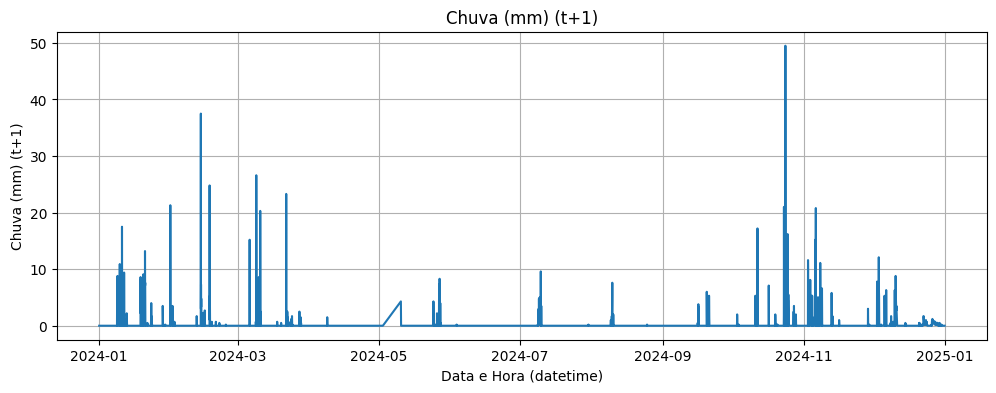

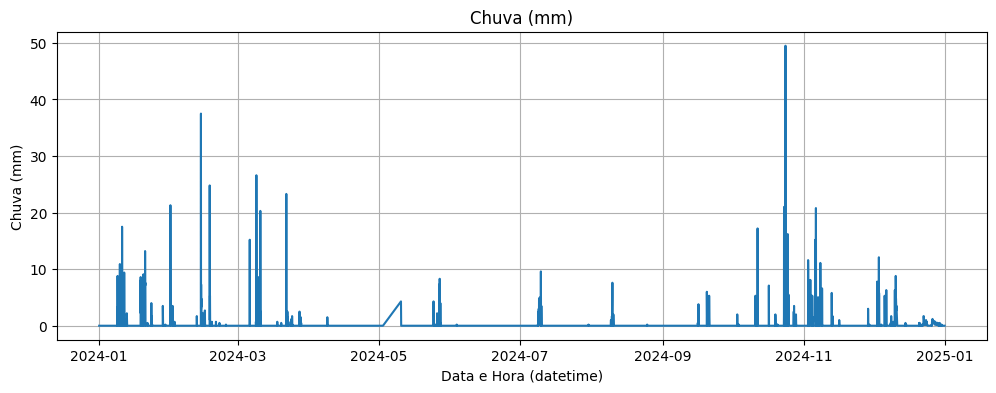

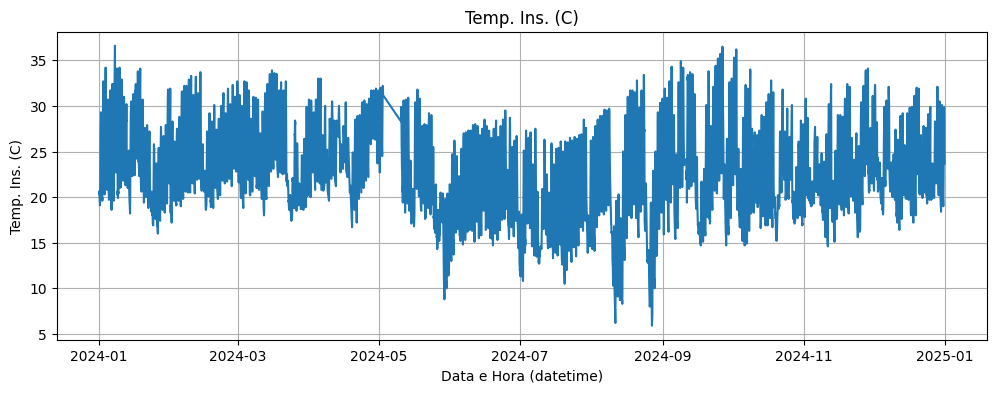

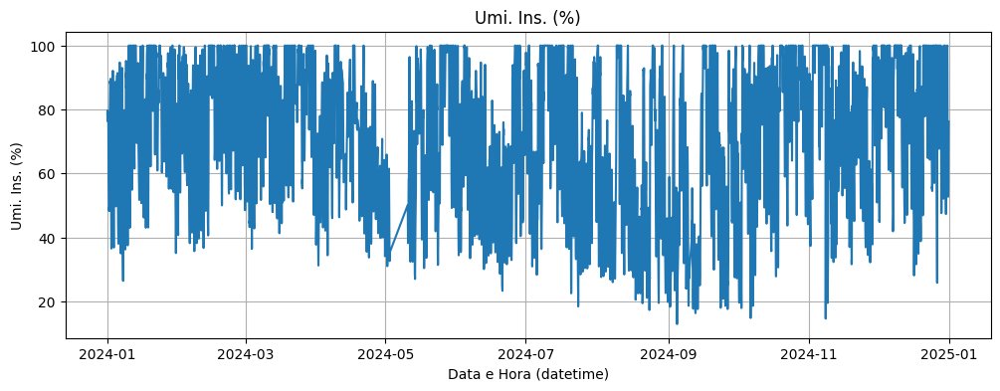

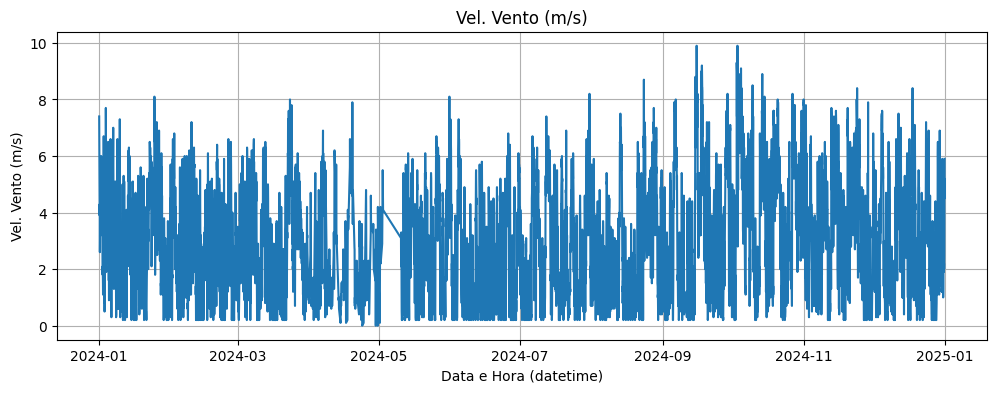

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8783 entries, 2024-01-01 00:00:00 to 2024-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8783 non-null   float64
 1   Chuva (mm)        8783 non-null   float64
 2   Temp. Ins. (C)    8783 non-null   float64
 3   Umi. Ins. (%)     8783 non-null   float64
 4   Vel. Vento (m/s)  8783 non-null   float64
dtypes: float64(5)
memory usage: 411.7 KB


In [187]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client3_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client3_df.index, client3_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client3_df.info()

In [188]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2024'
output_dir = 'Datasets tratados/2024'

os.makedirs(output_dir, exist_ok=True)

client3_df.to_csv(os.path.join(output_dir, 'Processed_Data_2024-Client-3_V0397_Itu.csv'), index=False)

# 4. Client- Dataset (Piedade-ETEC)⭐

## Data collection and pre-processing

In [189]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0455 - Piedade-ETEC/2024/INMET_SE_SP_V0455_PIEDADE-ETEC-Dataset_01-01-2024_A_31-12-202.csv'
file_path = 'Datasets Brutos/Estacao_V0455 - Piedade-ETEC/2024/INMET_SE_SP_V0455_PIEDADE-ETEC-Dataset_01-01-2024_A_31-12-202.csv'

# Upload CSV file into DataFrame
client_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [190]:
print("Dataframe format:")
print(f" ↪Linhas: {client_df.shape[0]} \n ↪Colunas: {client_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client_df.head()

Dataframe format:
 ↪Linhas: 8784 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2024,0,19.6,NaN,NaN,84.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.8,NaN,NaN,NaN,0.0
1,01/01/2024,100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,01/01/2024,200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,01/01/2024,300,19.5,NaN,NaN,86.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.9,NaN,NaN,NaN,0.0
4,01/01/2024,400,19.6,NaN,NaN,85.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.9,NaN,NaN,NaN,0.0


In [191]:
# Data general info
print("General Dataset Information:")
print(client_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8784 entries, 0 to 8783
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8784 non-null   object 
 1   Hora (UTC)            8784 non-null   int64  
 2   Temp. Ins. (C)        8297 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8297 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      6464 non-null   float

In [192]:
print("Descriptive statistics:")
client_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8784.000000,8297.000000,0.0,0.0,8297.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6464.000000,0.0,0.0,0.0,8297.000000
mean,1150.000000,20.915704,NaN,NaN,79.089840,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.505956,NaN,NaN,NaN,0.099096
std,692.258061,5.428292,NaN,NaN,16.761076,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.599383,NaN,NaN,NaN,0.921149
min,0.000000,2.700000,NaN,NaN,20.100000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,17.300000,NaN,NaN,69.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
50%,1150.000000,20.400000,NaN,NaN,85.200000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.300000,NaN,NaN,NaN,0.000000
75%,1725.000000,24.700000,NaN,NaN,91.400000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.800000,NaN,NaN,NaN,0.000000
max,2300.000000,36.100000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.400000,NaN,NaN,NaN,36.400000


In [193]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client_df['Hora (UTC)'] = client_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client_df['Hora Datetime'] = pd.to_datetime(client_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client_df['Data e Hora (datetime)'] = client_df['ï»¿"Data"'] + ' ' + client_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client_df['Data e Hora (datetime)'] = pd.to_datetime(client_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_19572\497734369.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client_df.loc[0, 'Hora (UTC)'] = modified_value


0   2024-01-01 00:00:00
1   2024-01-01 01:00:00
2   2024-01-01 02:00:00
3   2024-01-01 03:00:00
4   2024-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [194]:
client_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2024,0000,19.6,NaN,NaN,84.6,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.8,NaN,NaN,NaN,0.0,00:00:00,2024-01-01 00:00:00
1,01/01/2024,0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,01:00:00,2024-01-01 01:00:00
2,01/01/2024,0200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,02:00:00,2024-01-01 02:00:00
3,01/01/2024,0300,19.5,NaN,NaN,86.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.9,NaN,NaN,NaN,0.0,03:00:00,2024-01-01 03:00:00
4,01/01/2024,0400,19.6,NaN,NaN,85.8,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.9,NaN,NaN,NaN,0.0,04:00:00,2024-01-01 04:00:00


In [195]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client_df = client_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8784, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2024-01-01 00:00:00,19.6,NaN,NaN,84.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.8,NaN,NaN,NaN,0.0
1,2024-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2024-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2024-01-01 03:00:00,19.5,NaN,NaN,86.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.9,NaN,NaN,NaN,0.0
4,2024-01-01 04:00:00,19.6,NaN,NaN,85.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.9,NaN,NaN,NaN,0.0


In [196]:
# Indexing of the 'Datetime' Date and Time
client_df.set_index('Data e Hora (datetime)', inplace=True)

client_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2024-01-01 00:00:00,19.6,NaN,NaN,84.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.8,NaN,NaN,NaN,0.0
2024-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-01-01 03:00:00,19.5,NaN,NaN,86.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.9,NaN,NaN,NaN,0.0
2024-01-01 04:00:00,19.6,NaN,NaN,85.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.9,NaN,NaN,NaN,0.0


In [197]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           487
Temp. Max. (C)          8784
Temp. Min. (C)          8784
Umi. Ins. (%)            487
Umi. Max. (%)           8784
Umi. Min. (%)           8784
Pto Orvalho Ins. (C)    8784
Pto Orvalho Max. (C)    8784
Pto Orvalho Min. (C)    8784
Pressao Ins. (hPa)      8784
Pressao Max. (hPa)      8784
Pressao Min. (hPa)      8784
Vel. Vento (m/s)        2320
Dir. Vento (m/s)        8784
Raj. Vento (m/s)        8784
Radiacao (KJ/mÂ²)       8784
Chuva (mm)               487
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            5.544171
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)             5.544171
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [198]:
# Dropping columns with 100% missing values
client_df = client_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)       5.544171
Umi. Ins. (%)        5.544171
Vel. Vento (m/s)    26.411658
Chuva (mm)           5.544171
dtype: float64


In [199]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [200]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,19.6,84.6,0.8,0.0
2024-01-01 01:00:00,NaN,NaN,NaN,NaN
2024-01-01 02:00:00,NaN,NaN,NaN,NaN
2024-01-01 03:00:00,19.5,86.0,0.9,0.0
2024-01-01 04:00:00,19.6,85.8,0.9,0.0


In [201]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [202]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

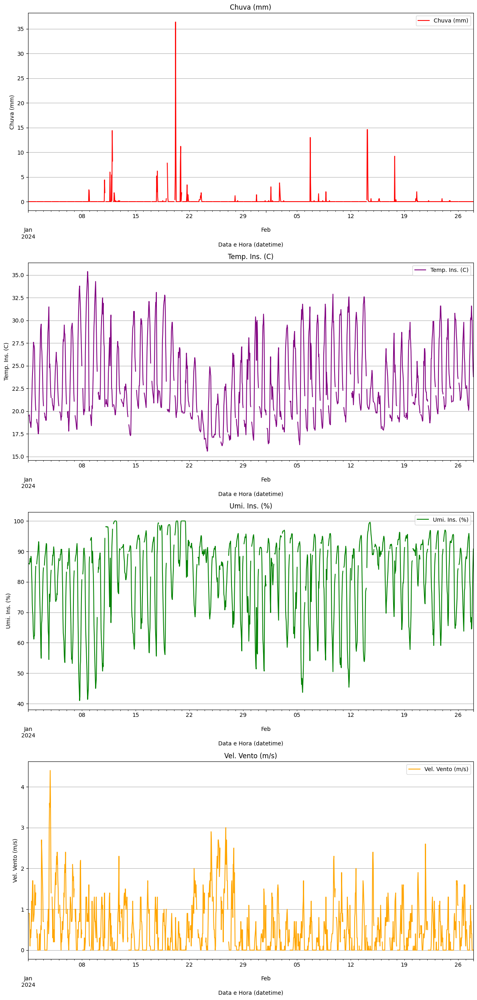

In [203]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

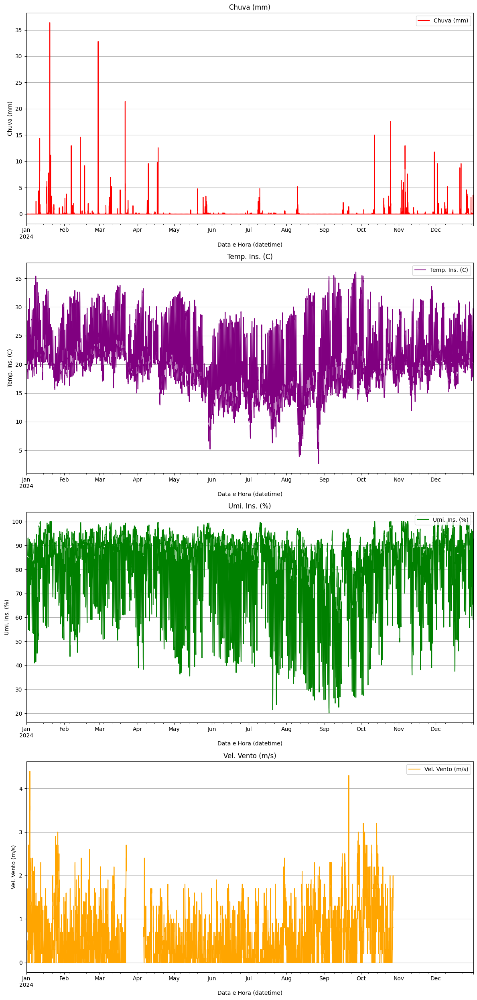

In [204]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [205]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client_df.columns:
    if client_df[column].isnull().any():
        client_df[column] = client_df[column].interpolate(method='linear')  # Interpolação linear

In [206]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [207]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

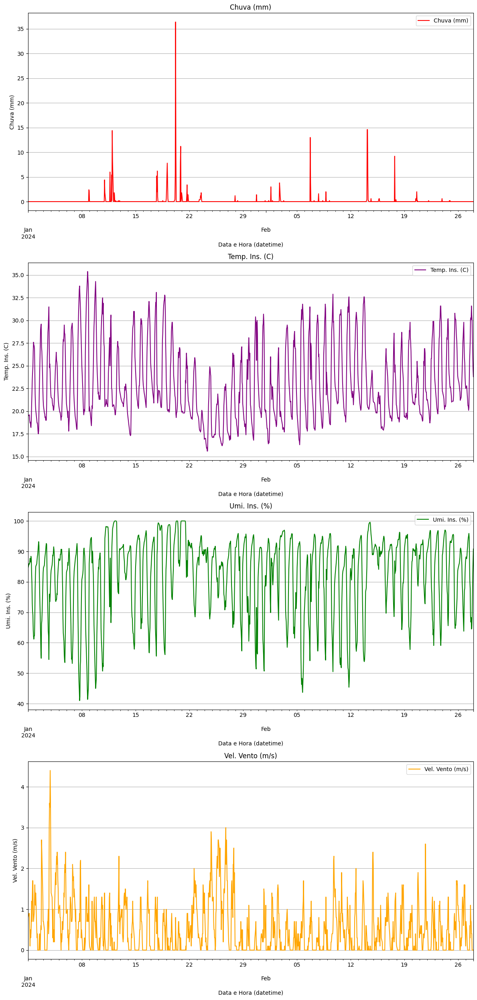

In [208]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

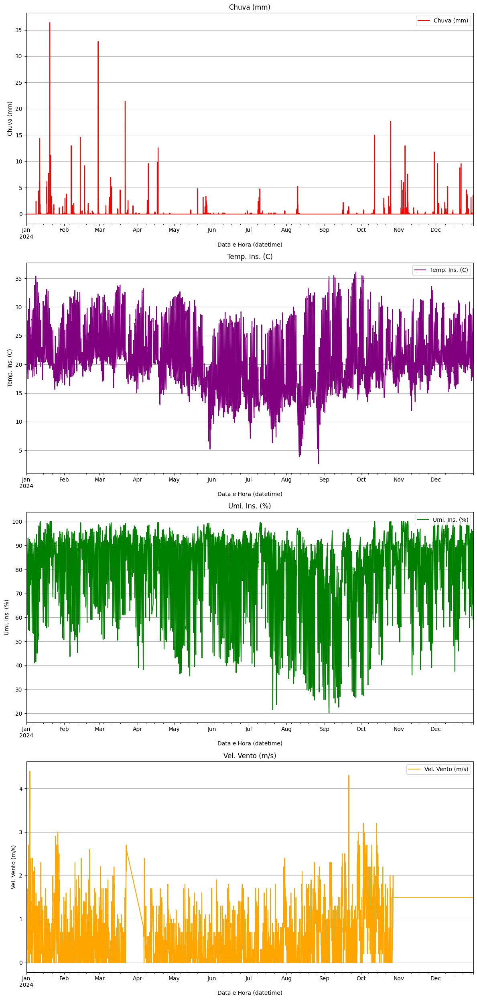

In [209]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [210]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,19.600000,84.600000,0.800000,0.0
2024-01-01 01:00:00,19.566667,85.066667,0.833333,0.0
2024-01-01 02:00:00,19.533333,85.533333,0.866667,0.0
2024-01-01 03:00:00,19.500000,86.000000,0.900000,0.0
2024-01-01 04:00:00,19.600000,85.800000,0.900000,0.0


In [211]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8784, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,0.0,19.600000,84.600000,0.800000
2024-01-01 01:00:00,0.0,19.566667,85.066667,0.833333
2024-01-01 02:00:00,0.0,19.533333,85.533333,0.866667
2024-01-01 03:00:00,0.0,19.500000,86.000000,0.900000
2024-01-01 04:00:00,0.0,19.600000,85.800000,0.900000


In [212]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client_df['Chuva (mm) (t+1)'] = client_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client_df.pop(target_column)
client_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2024-12-31 18:00:00,3.6,0.0,26.0,70.2,1.5
2024-12-31 19:00:00,0.0,3.6,21.5,79.8,1.5
2024-12-31 20:00:00,0.0,0.0,21.1,91.9,1.5
2024-12-31 21:00:00,0.0,0.0,21.8,92.7,1.5
2024-12-31 22:00:00,0.0,0.0,21.5,90.5,1.5


## Saving data as `.csv`

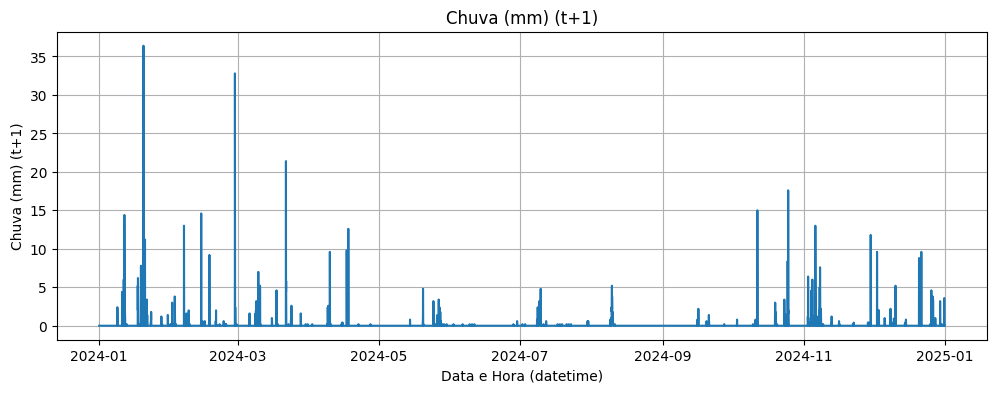

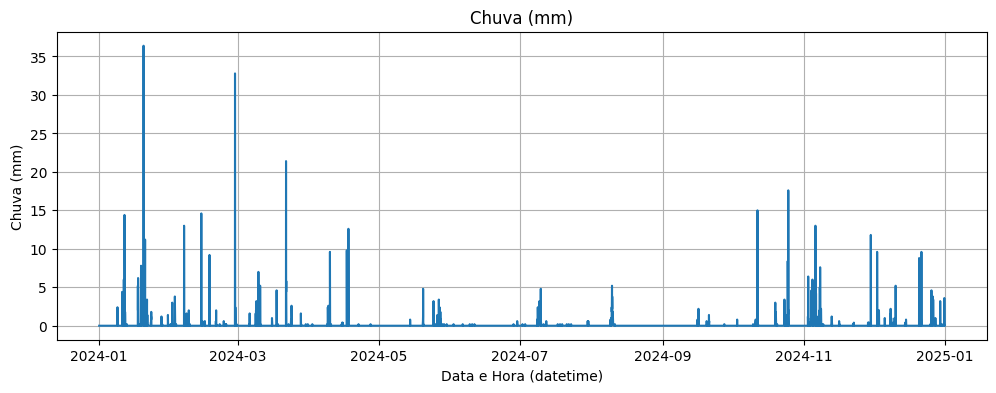

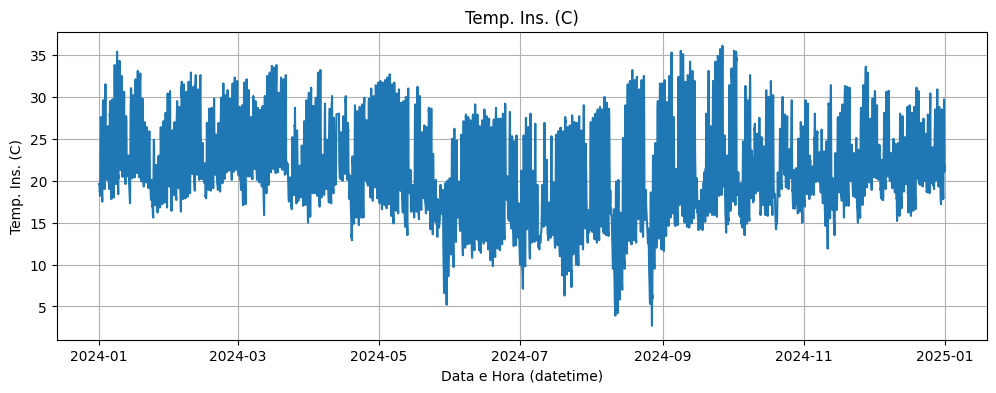

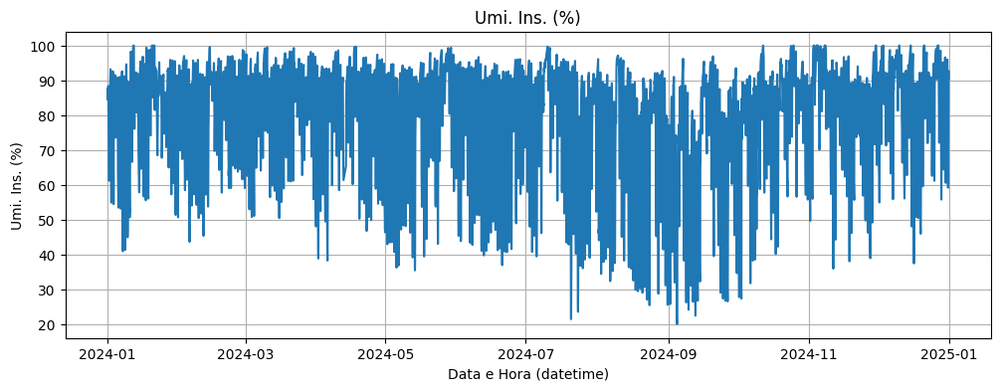

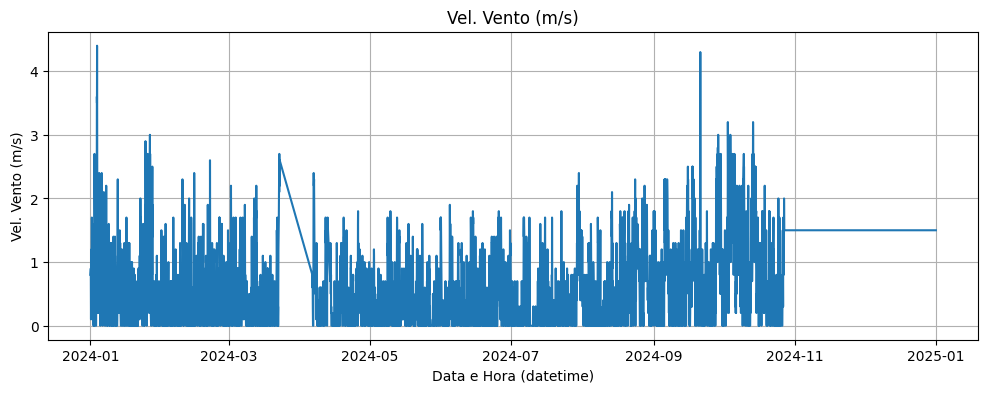

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8783 entries, 2024-01-01 00:00:00 to 2024-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8783 non-null   float64
 1   Chuva (mm)        8783 non-null   float64
 2   Temp. Ins. (C)    8783 non-null   float64
 3   Umi. Ins. (%)     8783 non-null   float64
 4   Vel. Vento (m/s)  8783 non-null   float64
dtypes: float64(5)
memory usage: 411.7 KB


In [213]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client_df.index, client_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client_df.info()

In [214]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2024'
output_dir = 'Datasets tratados/2024'

os.makedirs(output_dir, exist_ok=True)

client_df.to_csv(os.path.join(output_dir, 'Processed_Data_2024-Client-4_V0455_Piedade-ETEC.csv'), index=False)


# 5. Client- Dataset (Porto Feliz)⭐

## Data collection and pre-processing

In [215]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0462 - Porto Feliz/2024/INMET_SE_SP_V0462_PORTO_FELIZ-Dataset_01-01-2024_A_31-12-2024.csv'
file_path = 'Datasets Brutos/Estacao_V0462 - Porto Feliz/2024/INMET_SE_SP_V0462_PORTO_FELIZ-Dataset_01-01-2024_A_31-12-2024.csv'

# Upload CSV file into DataFrame
client_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [216]:
print("Dataframe format:")
print(f" ↪Linhas: {client_df.shape[0]} \n ↪Colunas: {client_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client_df.head()

Dataframe format:
 ↪Linhas: 8784 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2024,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,01/01/2024,100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,01/01/2024,200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,01/01/2024,300,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,01/01/2024,400,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [217]:
# Data general info
print("General Dataset Information:")
print(client_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8784 entries, 0 to 8783
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8784 non-null   object 
 1   Hora (UTC)            8784 non-null   int64  
 2   Temp. Ins. (C)        5548 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         5548 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      5601 non-null   float

In [218]:
print("Descriptive statistics:")
client_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8784.000000,5548.000000,0.0,0.0,5548.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5601.000000,0.0,0.0,0.0,5602.00000
mean,1150.000000,22.511932,NaN,NaN,65.894935,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.273915,NaN,NaN,NaN,0.16935
std,692.258061,5.591066,NaN,NaN,20.159948,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.553527,NaN,NaN,NaN,1.05778
min,0.000000,6.200000,NaN,NaN,12.600000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.00000
25%,575.000000,18.700000,NaN,NaN,51.100000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.00000
50%,1150.000000,22.000000,NaN,NaN,69.950000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.00000
75%,1725.000000,26.300000,NaN,NaN,80.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.200000,NaN,NaN,NaN,0.00000
max,2300.000000,39.100000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.800000,NaN,NaN,NaN,30.60000


In [219]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client_df['Hora (UTC)'] = client_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client_df['Hora Datetime'] = pd.to_datetime(client_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client_df['Data e Hora (datetime)'] = client_df['ï»¿"Data"'] + ' ' + client_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client_df['Data e Hora (datetime)'] = pd.to_datetime(client_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_19572\497734369.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client_df.loc[0, 'Hora (UTC)'] = modified_value


0   2024-01-01 00:00:00
1   2024-01-01 01:00:00
2   2024-01-01 02:00:00
3   2024-01-01 03:00:00
4   2024-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [220]:
client_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2024,0000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,00:00:00,2024-01-01 00:00:00
1,01/01/2024,0100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,01:00:00,2024-01-01 01:00:00
2,01/01/2024,0200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,02:00:00,2024-01-01 02:00:00
3,01/01/2024,0300,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,03:00:00,2024-01-01 03:00:00
4,01/01/2024,0400,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,04:00:00,2024-01-01 04:00:00


In [221]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client_df = client_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8784, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2024-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2024-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2024-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2024-01-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2024-01-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [222]:
# Indexing of the 'Datetime' Date and Time
client_df.set_index('Data e Hora (datetime)', inplace=True)

client_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2024-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-01-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-01-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [223]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)          3236
Temp. Max. (C)          8784
Temp. Min. (C)          8784
Umi. Ins. (%)           3236
Umi. Max. (%)           8784
Umi. Min. (%)           8784
Pto Orvalho Ins. (C)    8784
Pto Orvalho Max. (C)    8784
Pto Orvalho Min. (C)    8784
Pressao Ins. (hPa)      8784
Pressao Max. (hPa)      8784
Pressao Min. (hPa)      8784
Vel. Vento (m/s)        3183
Dir. Vento (m/s)        8784
Raj. Vento (m/s)        8784
Radiacao (KJ/mÂ²)       8784
Chuva (mm)              3182
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)           36.839709
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)            36.839709
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [224]:
# Dropping columns with 100% missing values
client_df = client_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      36.839709
Umi. Ins. (%)       36.839709
Vel. Vento (m/s)    36.236339
Chuva (mm)          36.224954
dtype: float64


In [225]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [226]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,NaN,NaN,NaN,NaN
2024-01-01 01:00:00,NaN,NaN,NaN,NaN
2024-01-01 02:00:00,NaN,NaN,NaN,NaN
2024-01-01 03:00:00,NaN,NaN,NaN,NaN
2024-01-01 04:00:00,NaN,NaN,NaN,NaN


In [227]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [228]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

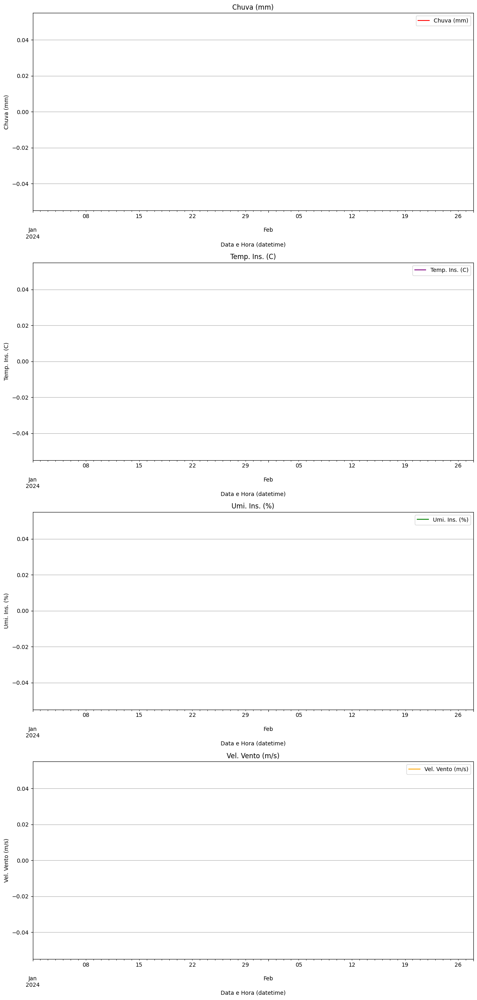

In [229]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

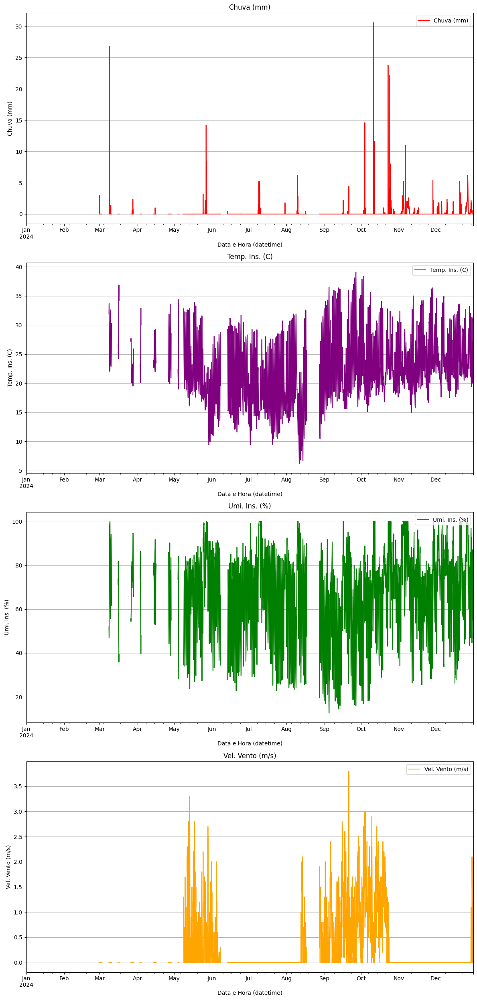

In [230]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [231]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client_df.columns:
    if client_df[column].isnull().any():
        client_df[column] = client_df[column].interpolate(method='linear')  # Interpolação linear

In [232]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      1623
Umi. Ins. (%)       1623
Vel. Vento (m/s)    1431
Chuva (mm)          1431
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      18.476776
Umi. Ins. (%)       18.476776
Vel. Vento (m/s)    16.290984
Chuva (mm)          16.290984
dtype: float64


Checking the main features visually

In [233]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

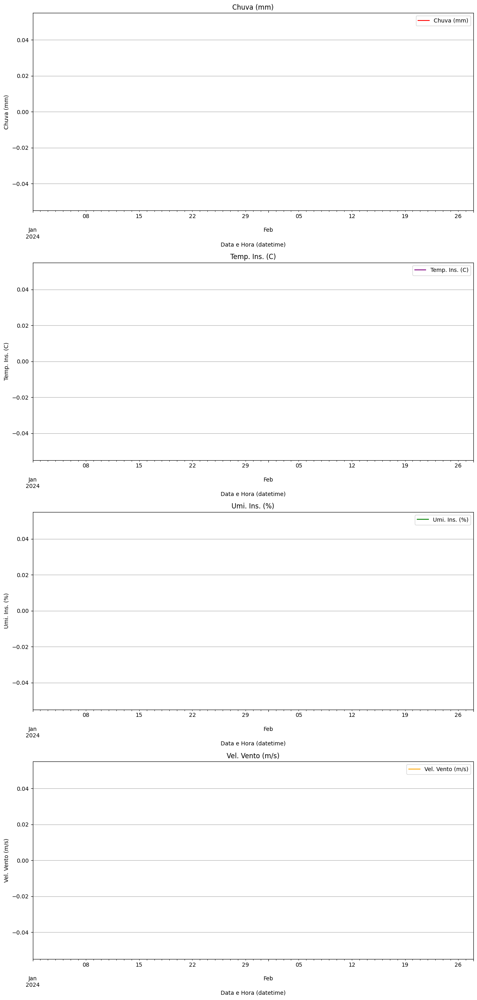

In [234]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

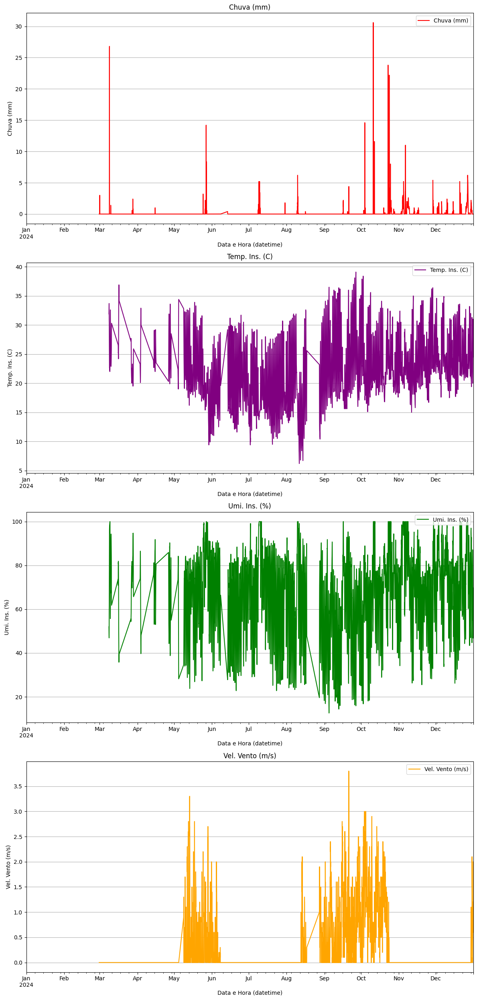

In [235]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [236]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,NaN,NaN,NaN,NaN
2024-01-01 01:00:00,NaN,NaN,NaN,NaN
2024-01-01 02:00:00,NaN,NaN,NaN,NaN
2024-01-01 03:00:00,NaN,NaN,NaN,NaN
2024-01-01 04:00:00,NaN,NaN,NaN,NaN


In [237]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8784, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,NaN,NaN,NaN,NaN
2024-01-01 01:00:00,NaN,NaN,NaN,NaN
2024-01-01 02:00:00,NaN,NaN,NaN,NaN
2024-01-01 03:00:00,NaN,NaN,NaN,NaN
2024-01-01 04:00:00,NaN,NaN,NaN,NaN


In [238]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client_df['Chuva (mm) (t+1)'] = client_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client_df.pop(target_column)
client_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2024-12-31 18:00:00,0.0,0.0,30.6,47.9,0.6
2024-12-31 19:00:00,0.0,0.0,29.7,51.2,0.6
2024-12-31 20:00:00,0.0,0.0,28.8,56.7,1.5
2024-12-31 21:00:00,0.0,0.0,27.3,61.2,1.7
2024-12-31 22:00:00,0.0,0.0,26.2,64.1,2.0


## Saving data as `.csv`

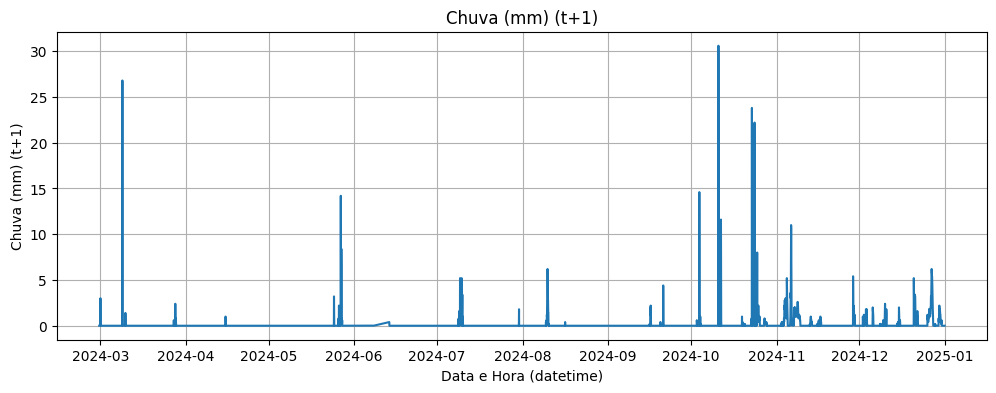

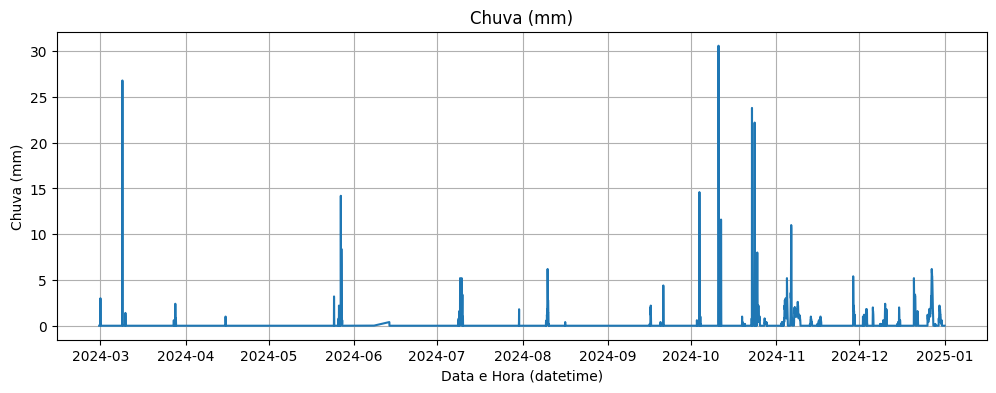

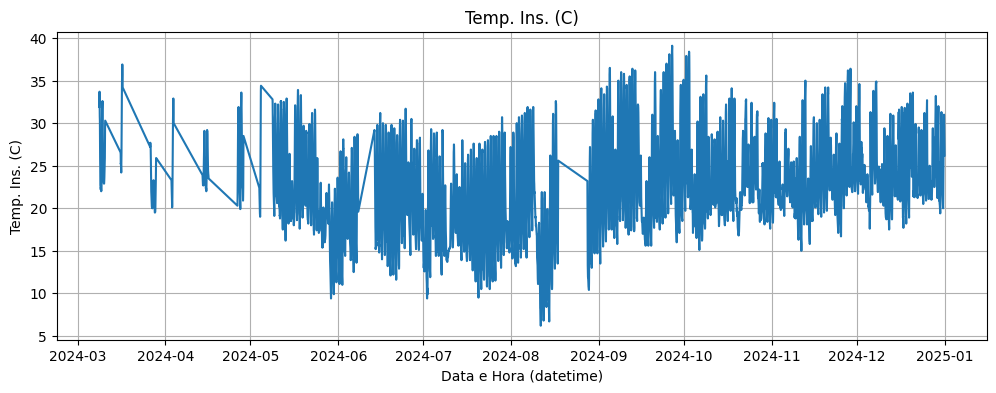

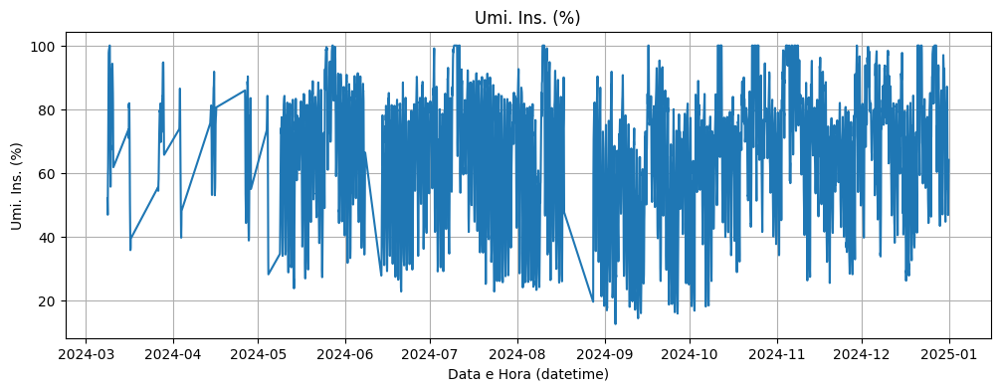

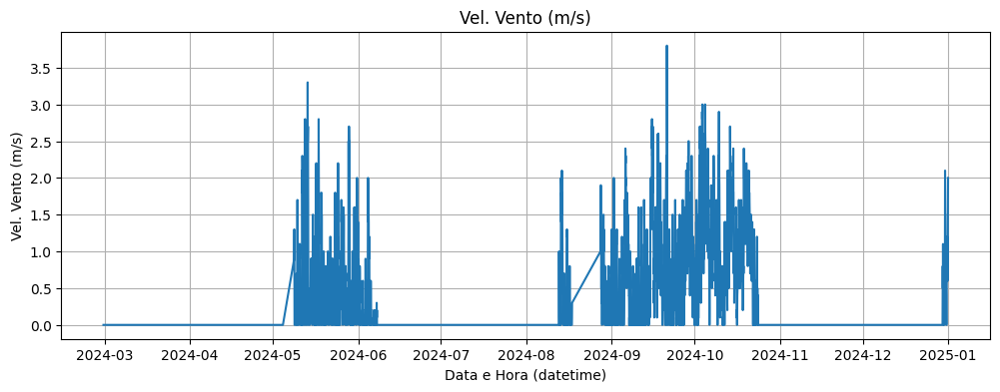

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 7353 entries, 2024-02-29 14:00:00 to 2024-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  7353 non-null   float64
 1   Chuva (mm)        7352 non-null   float64
 2   Temp. Ins. (C)    7160 non-null   float64
 3   Umi. Ins. (%)     7160 non-null   float64
 4   Vel. Vento (m/s)  7352 non-null   float64
dtypes: float64(5)
memory usage: 344.7 KB


In [239]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client_df.index, client_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client_df.info()

In [240]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2024'
output_dir = 'Datasets tratados/2024'

os.makedirs(output_dir, exist_ok=True)

client_df.to_csv(os.path.join(output_dir, 'Processed_Data_2024-Client-5_V0462_Porto_Feliz.csv'), index=False)


# 6. Client- Dataset (Sarapui)⭐

## Data collection and pre-processing

In [241]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0492 - Sarapui/2024/INMET_SE_SP_V0492_SARAPUI-Dataset_01-01-2024_A_31-12-2024.csv'
file_path = 'Datasets Brutos/Estacao_V0492 - Sarapui/2024/INMET_SE_SP_V0492_SARAPUI-Dataset_01-01-2024_A_31-12-2024.csv'

# Upload CSV file into DataFrame
client_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [242]:
print("Dataframe format:")
print(f" ↪Linhas: {client_df.shape[0]} \n ↪Colunas: {client_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client_df.head()

Dataframe format:
 ↪Linhas: 8784 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2024,0,20.6,NaN,NaN,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,01/01/2024,100,20.2,NaN,NaN,77.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,01/01/2024,200,20.7,NaN,NaN,75.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,01/01/2024,300,21.0,NaN,NaN,75.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,01/01/2024,400,21.1,NaN,NaN,74.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [243]:
# Data general info
print("General Dataset Information:")
print(client_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8784 entries, 0 to 8783
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8784 non-null   object 
 1   Hora (UTC)            8784 non-null   int64  
 2   Temp. Ins. (C)        8242 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8242 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      8764 non-null   float

In [244]:
print("Descriptive statistics:")
client_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8784.000000,8242.000000,0.0,0.0,8242.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8764.000000,0.0,0.0,0.0,8764.000000
mean,1150.000000,22.013759,NaN,NaN,72.909439,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.390838,NaN,NaN,NaN,0.140199
std,692.258061,5.447208,NaN,NaN,18.966435,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.639974,NaN,NaN,NaN,1.240360
min,0.000000,5.100000,NaN,NaN,16.700000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,18.400000,NaN,NaN,59.700000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
50%,1150.000000,21.700000,NaN,NaN,78.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
75%,1725.000000,25.700000,NaN,NaN,87.200000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.700000,NaN,NaN,NaN,0.000000
max,2300.000000,37.700000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.000000,NaN,NaN,NaN,52.800000


In [245]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client_df['Hora (UTC)'] = client_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client_df['Hora Datetime'] = pd.to_datetime(client_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client_df['Data e Hora (datetime)'] = client_df['ï»¿"Data"'] + ' ' + client_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client_df['Data e Hora (datetime)'] = pd.to_datetime(client_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_19572\497734369.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client_df.loc[0, 'Hora (UTC)'] = modified_value


0   2024-01-01 00:00:00
1   2024-01-01 01:00:00
2   2024-01-01 02:00:00
3   2024-01-01 03:00:00
4   2024-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [246]:
client_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2024,0000,20.6,NaN,NaN,76.1,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,00:00:00,2024-01-01 00:00:00
1,01/01/2024,0100,20.2,NaN,NaN,77.2,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,01:00:00,2024-01-01 01:00:00
2,01/01/2024,0200,20.7,NaN,NaN,75.7,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,02:00:00,2024-01-01 02:00:00
3,01/01/2024,0300,21.0,NaN,NaN,75.5,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,03:00:00,2024-01-01 03:00:00
4,01/01/2024,0400,21.1,NaN,NaN,74.1,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,04:00:00,2024-01-01 04:00:00


In [247]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client_df = client_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8784, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2024-01-01 00:00:00,20.6,NaN,NaN,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,2024-01-01 01:00:00,20.2,NaN,NaN,77.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,2024-01-01 02:00:00,20.7,NaN,NaN,75.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,2024-01-01 03:00:00,21.0,NaN,NaN,75.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,2024-01-01 04:00:00,21.1,NaN,NaN,74.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [248]:
# Indexing of the 'Datetime' Date and Time
client_df.set_index('Data e Hora (datetime)', inplace=True)

client_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2024-01-01 00:00:00,20.6,NaN,NaN,76.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 01:00:00,20.2,NaN,NaN,77.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 02:00:00,20.7,NaN,NaN,75.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 03:00:00,21.0,NaN,NaN,75.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 04:00:00,21.1,NaN,NaN,74.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [249]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           542
Temp. Max. (C)          8784
Temp. Min. (C)          8784
Umi. Ins. (%)            542
Umi. Max. (%)           8784
Umi. Min. (%)           8784
Pto Orvalho Ins. (C)    8784
Pto Orvalho Max. (C)    8784
Pto Orvalho Min. (C)    8784
Pressao Ins. (hPa)      8784
Pressao Max. (hPa)      8784
Pressao Min. (hPa)      8784
Vel. Vento (m/s)          20
Dir. Vento (m/s)        8784
Raj. Vento (m/s)        8784
Radiacao (KJ/mÂ²)       8784
Chuva (mm)                20
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            6.170310
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)             6.170310
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [250]:
# Dropping columns with 100% missing values
client_df = client_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      6.170310
Umi. Ins. (%)       6.170310
Vel. Vento (m/s)    0.227687
Chuva (mm)          0.227687
dtype: float64


In [251]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [252]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,20.6,76.1,0.0,0.0
2024-01-01 01:00:00,20.2,77.2,0.0,0.0
2024-01-01 02:00:00,20.7,75.7,0.0,0.0
2024-01-01 03:00:00,21.0,75.5,0.0,0.0
2024-01-01 04:00:00,21.1,74.1,0.0,0.0


In [253]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [254]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

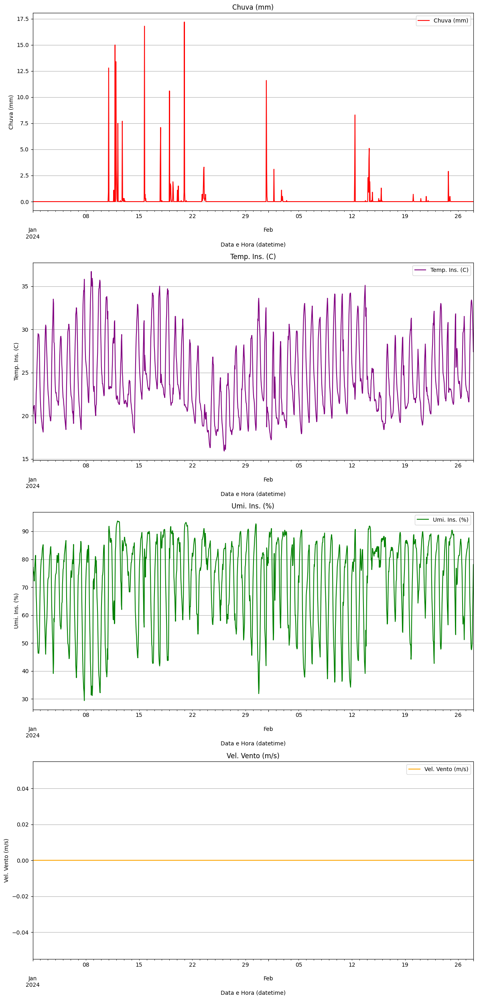

In [255]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

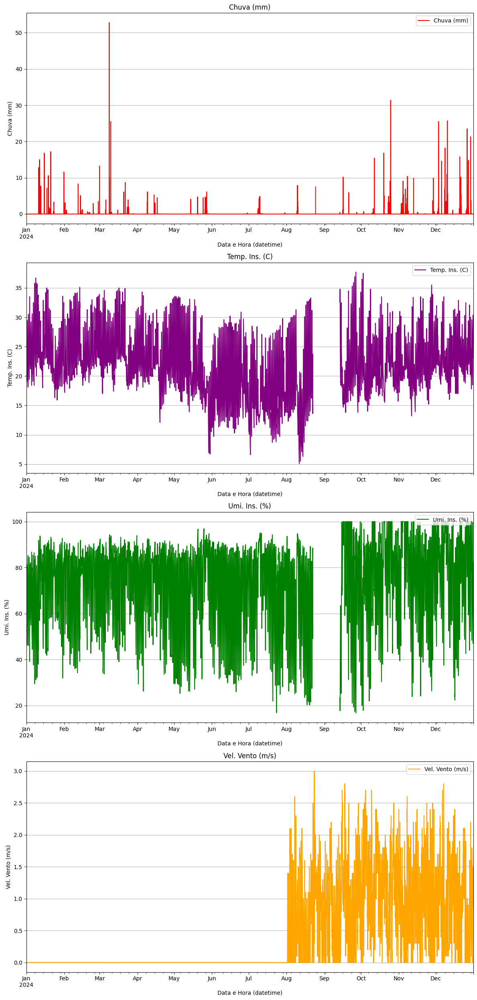

In [256]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [257]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client_df.columns:
    if client_df[column].isnull().any():
        client_df[column] = client_df[column].interpolate(method='linear')  # Interpolação linear

In [258]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [259]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

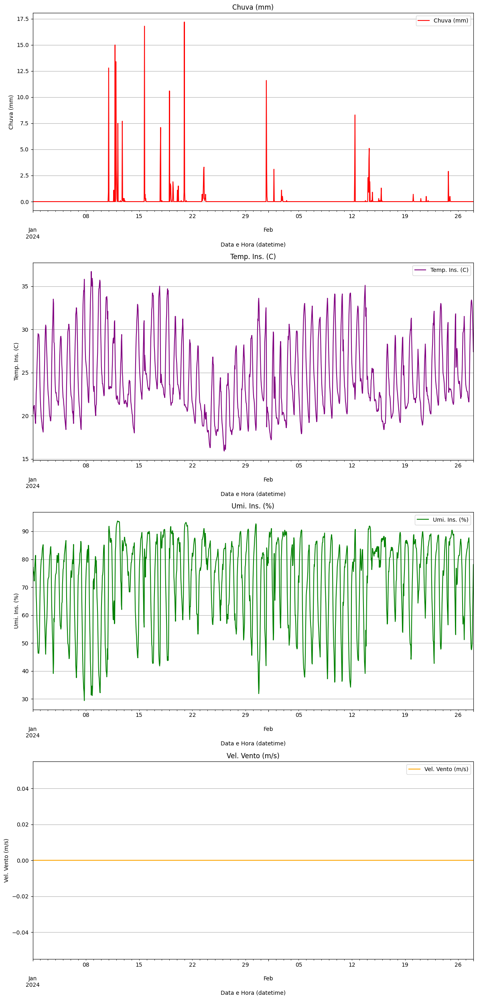

In [260]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

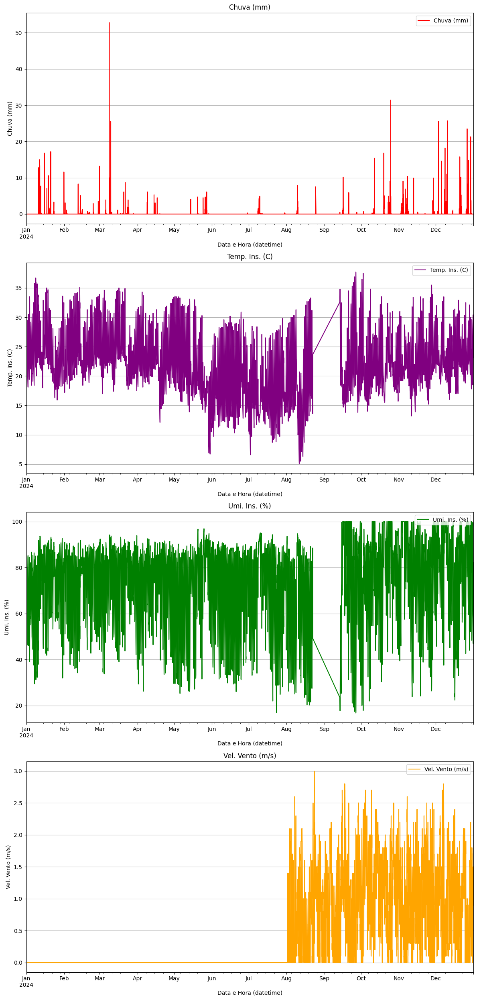

In [261]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [262]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,20.6,76.1,0.0,0.0
2024-01-01 01:00:00,20.2,77.2,0.0,0.0
2024-01-01 02:00:00,20.7,75.7,0.0,0.0
2024-01-01 03:00:00,21.0,75.5,0.0,0.0
2024-01-01 04:00:00,21.1,74.1,0.0,0.0


In [263]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8784, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,0.0,20.6,76.1,0.0
2024-01-01 01:00:00,0.0,20.2,77.2,0.0
2024-01-01 02:00:00,0.0,20.7,75.7,0.0
2024-01-01 03:00:00,0.0,21.0,75.5,0.0
2024-01-01 04:00:00,0.0,21.1,74.1,0.0


In [264]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client_df['Chuva (mm) (t+1)'] = client_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client_df.pop(target_column)
client_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2024-12-31 18:00:00,0.0,0.0,28.3,59.4,0.9
2024-12-31 19:00:00,0.0,0.0,23.6,69.0,1.5
2024-12-31 20:00:00,0.0,0.0,23.1,73.0,0.9
2024-12-31 21:00:00,0.0,0.0,24.3,79.3,1.4
2024-12-31 22:00:00,0.0,0.0,24.5,79.3,1.1


## Saving data as `.csv`

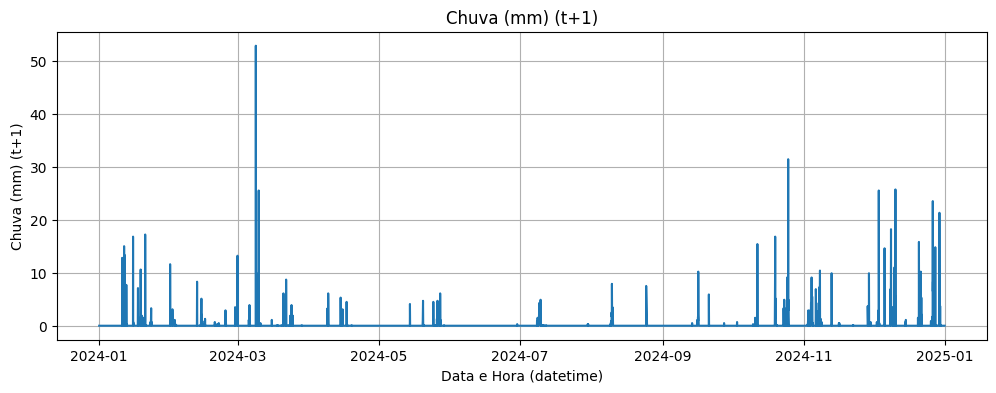

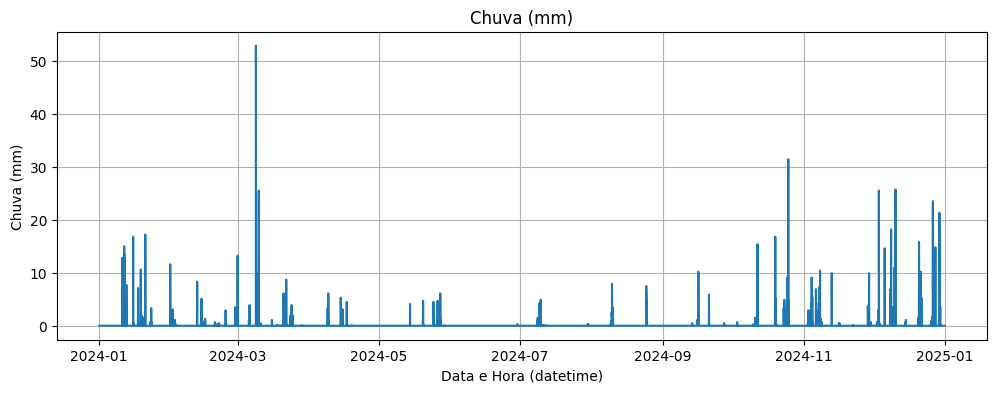

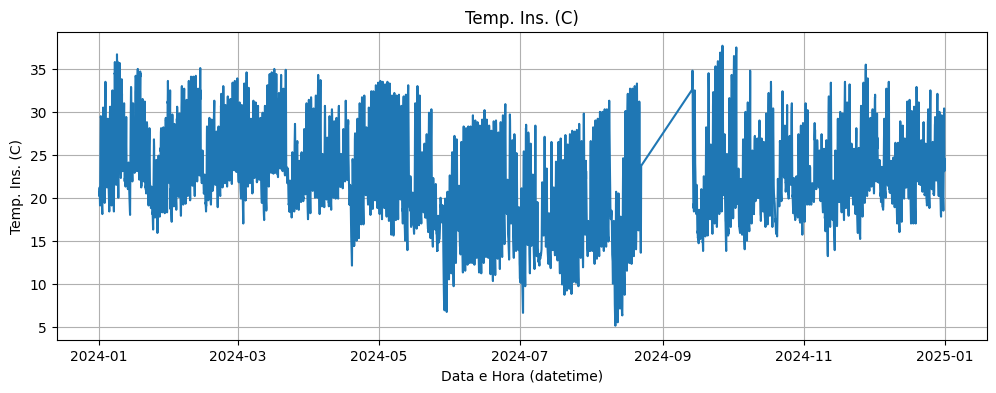

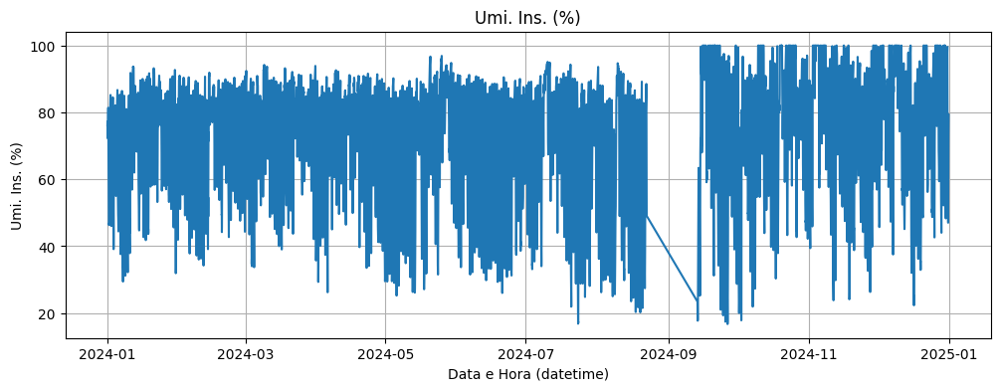

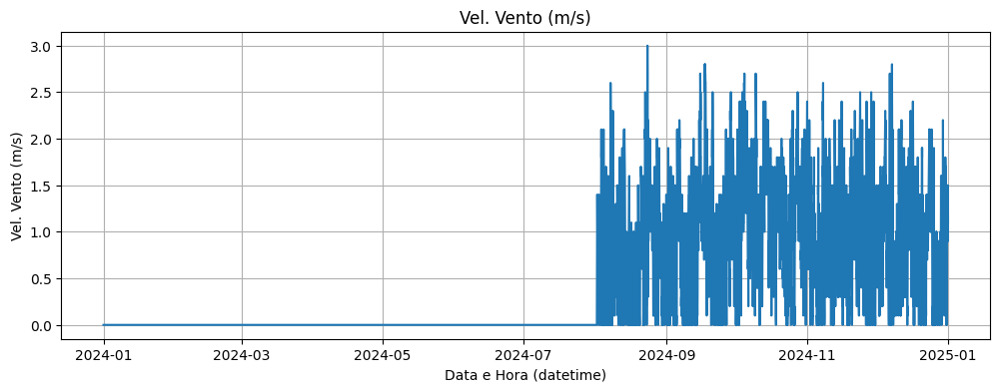

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8783 entries, 2024-01-01 00:00:00 to 2024-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8783 non-null   float64
 1   Chuva (mm)        8783 non-null   float64
 2   Temp. Ins. (C)    8783 non-null   float64
 3   Umi. Ins. (%)     8783 non-null   float64
 4   Vel. Vento (m/s)  8783 non-null   float64
dtypes: float64(5)
memory usage: 411.7 KB


In [265]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client_df.index, client_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client_df.info()

In [266]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2024'
output_dir = 'Datasets tratados/2024'

os.makedirs(output_dir, exist_ok=True)

client_df.to_csv(os.path.join(output_dir, 'Processed_Data_2024-Client-6_V0492_Sarapui.csv'), index=False)


# 7. Client- Dataset (Sorocaba)⭐

## Data collection and pre-processing

In [267]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0498 - Sorocaba/2024/INMET_SE_SP_V0498_SOROCABA-Dataset_01-01-2024_A_31-12-2024.csv'
file_path = 'Datasets Brutos/Estacao_V0498 - Sorocaba/2024/INMET_SE_SP_V0498_SOROCABA-Dataset_01-01-2024_A_31-12-2024.csv'

# Upload CSV file into DataFrame
client_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [268]:
print("Dataframe format:")
print(f" ↪Linhas: {client_df.shape[0]} \n ↪Colunas: {client_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client_df.head()

Dataframe format:
 ↪Linhas: 8784 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2024,0,21.6,NaN,NaN,70.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,01/01/2024,100,21.4,NaN,NaN,69.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,01/01/2024,200,21.6,NaN,NaN,69.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,01/01/2024,300,21.5,NaN,NaN,70.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,01/01/2024,400,21.3,NaN,NaN,70.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [269]:
# Data general info
print("General Dataset Information:")
print(client_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8784 entries, 0 to 8783
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8784 non-null   object 
 1   Hora (UTC)            8784 non-null   int64  
 2   Temp. Ins. (C)        8104 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8185 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      8184 non-null   float

In [270]:
print("Descriptive statistics:")
client_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8784.000000,8104.000000,0.0,0.0,8185.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8184.000000,0.0,0.0,0.0,8185.000000
mean,1150.000000,22.815684,NaN,NaN,66.574478,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.615946,NaN,NaN,NaN,0.142834
std,692.258061,5.389257,NaN,NaN,17.879710,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.744820,NaN,NaN,NaN,1.382882
min,0.000000,0.500000,NaN,NaN,14.400000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,19.400000,NaN,NaN,54.300000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
50%,1150.000000,22.400000,NaN,NaN,69.100000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.400000,NaN,NaN,NaN,0.000000
75%,1725.000000,26.500000,NaN,NaN,79.500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,0.000000
max,2300.000000,43.800000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.400000,NaN,NaN,NaN,64.000000


In [271]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client_df['Hora (UTC)'] = client_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client_df['Hora Datetime'] = pd.to_datetime(client_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client_df['Data e Hora (datetime)'] = client_df['ï»¿"Data"'] + ' ' + client_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client_df['Data e Hora (datetime)'] = pd.to_datetime(client_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_19572\497734369.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client_df.loc[0, 'Hora (UTC)'] = modified_value


0   2024-01-01 00:00:00
1   2024-01-01 01:00:00
2   2024-01-01 02:00:00
3   2024-01-01 03:00:00
4   2024-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [272]:
client_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2024,0000,21.6,NaN,NaN,70.2,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,00:00:00,2024-01-01 00:00:00
1,01/01/2024,0100,21.4,NaN,NaN,69.8,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,01:00:00,2024-01-01 01:00:00
2,01/01/2024,0200,21.6,NaN,NaN,69.5,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,02:00:00,2024-01-01 02:00:00
3,01/01/2024,0300,21.5,NaN,NaN,70.7,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,03:00:00,2024-01-01 03:00:00
4,01/01/2024,0400,21.3,NaN,NaN,70.5,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,04:00:00,2024-01-01 04:00:00


In [273]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client_df = client_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8784, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2024-01-01 00:00:00,21.6,NaN,NaN,70.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,2024-01-01 01:00:00,21.4,NaN,NaN,69.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,2024-01-01 02:00:00,21.6,NaN,NaN,69.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,2024-01-01 03:00:00,21.5,NaN,NaN,70.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,2024-01-01 04:00:00,21.3,NaN,NaN,70.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [274]:
# Indexing of the 'Datetime' Date and Time
client_df.set_index('Data e Hora (datetime)', inplace=True)

client_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2024-01-01 00:00:00,21.6,NaN,NaN,70.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 01:00:00,21.4,NaN,NaN,69.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 02:00:00,21.6,NaN,NaN,69.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 03:00:00,21.5,NaN,NaN,70.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 04:00:00,21.3,NaN,NaN,70.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [275]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           680
Temp. Max. (C)          8784
Temp. Min. (C)          8784
Umi. Ins. (%)            599
Umi. Max. (%)           8784
Umi. Min. (%)           8784
Pto Orvalho Ins. (C)    8784
Pto Orvalho Max. (C)    8784
Pto Orvalho Min. (C)    8784
Pressao Ins. (hPa)      8784
Pressao Max. (hPa)      8784
Pressao Min. (hPa)      8784
Vel. Vento (m/s)         600
Dir. Vento (m/s)        8784
Raj. Vento (m/s)        8784
Radiacao (KJ/mÂ²)       8784
Chuva (mm)               599
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            7.741348
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)             6.819217
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [276]:
# Dropping columns with 100% missing values
client_df = client_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      7.741348
Umi. Ins. (%)       6.819217
Vel. Vento (m/s)    6.830601
Chuva (mm)          6.819217
dtype: float64


In [277]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [278]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,21.6,70.2,0.0,0.0
2024-01-01 01:00:00,21.4,69.8,0.0,0.0
2024-01-01 02:00:00,21.6,69.5,0.0,0.0
2024-01-01 03:00:00,21.5,70.7,0.0,0.0
2024-01-01 04:00:00,21.3,70.5,0.0,0.0


In [279]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [280]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

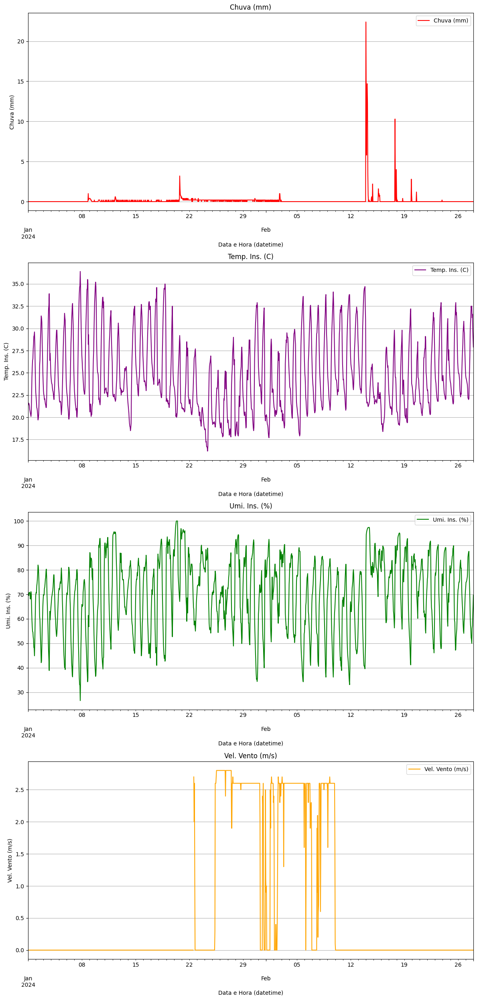

In [281]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

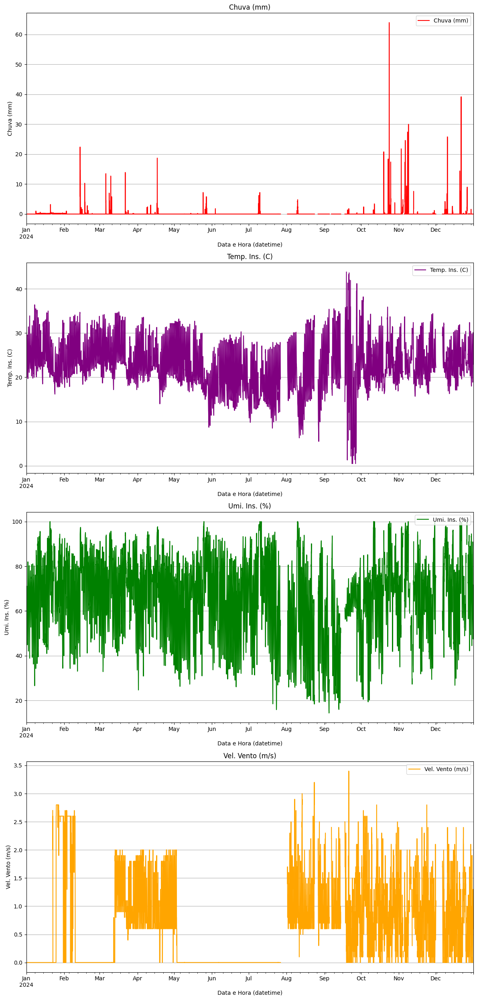

In [282]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [283]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client_df.columns:
    if client_df[column].isnull().any():
        client_df[column] = client_df[column].interpolate(method='linear')  # Interpolação linear

In [284]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [285]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

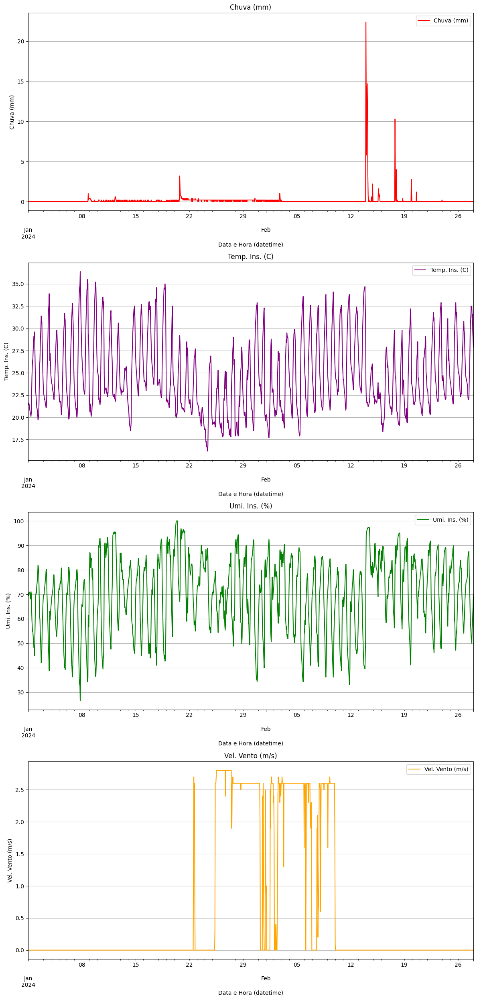

In [286]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

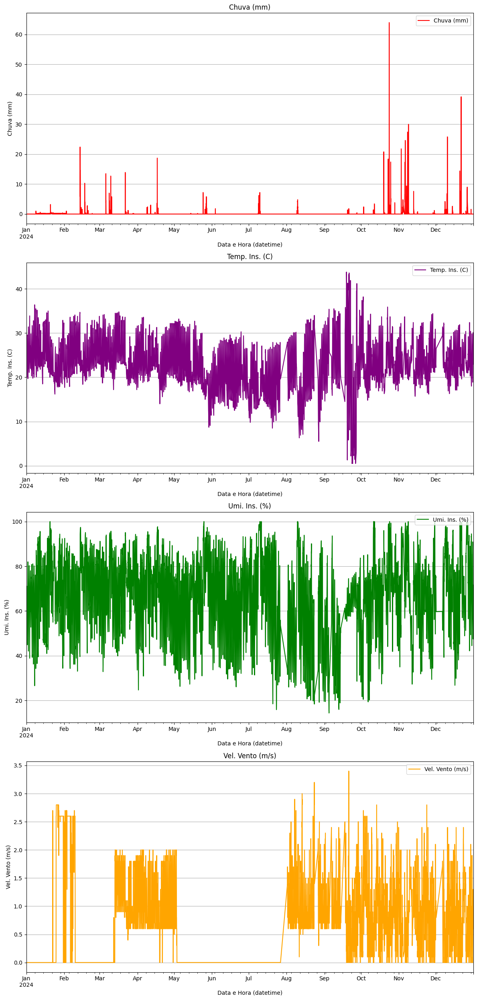

In [287]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [288]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,21.6,70.2,0.0,0.0
2024-01-01 01:00:00,21.4,69.8,0.0,0.0
2024-01-01 02:00:00,21.6,69.5,0.0,0.0
2024-01-01 03:00:00,21.5,70.7,0.0,0.0
2024-01-01 04:00:00,21.3,70.5,0.0,0.0


In [289]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8784, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,0.0,21.6,70.2,0.0
2024-01-01 01:00:00,0.0,21.4,69.8,0.0
2024-01-01 02:00:00,0.0,21.6,69.5,0.0
2024-01-01 03:00:00,0.0,21.5,70.7,0.0
2024-01-01 04:00:00,0.0,21.3,70.5,0.0


In [290]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client_df['Chuva (mm) (t+1)'] = client_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client_df.pop(target_column)
client_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2024-12-31 18:00:00,0.0,0.0,29.8,48.1,0.6
2024-12-31 19:00:00,0.0,0.0,27.2,58.2,1.0
2024-12-31 20:00:00,0.0,0.0,25.2,62.3,1.3
2024-12-31 21:00:00,0.0,0.0,24.7,68.6,0.9
2024-12-31 22:00:00,0.0,0.0,24.2,68.6,1.1


## Saving data as `.csv`

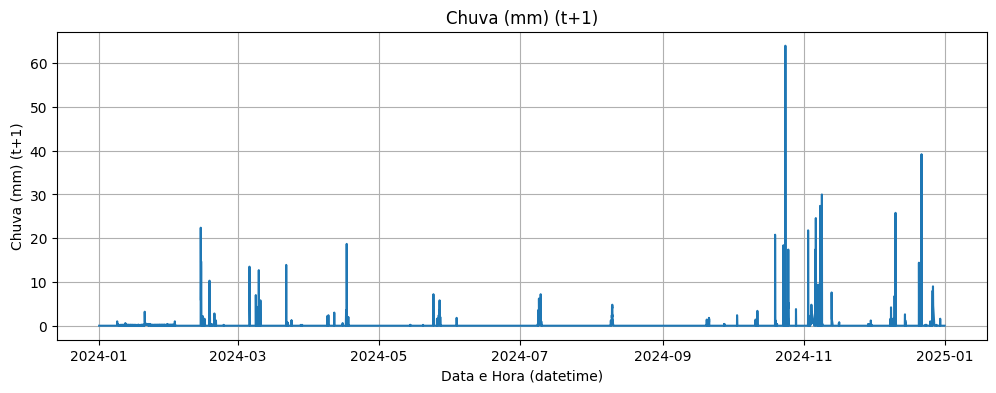

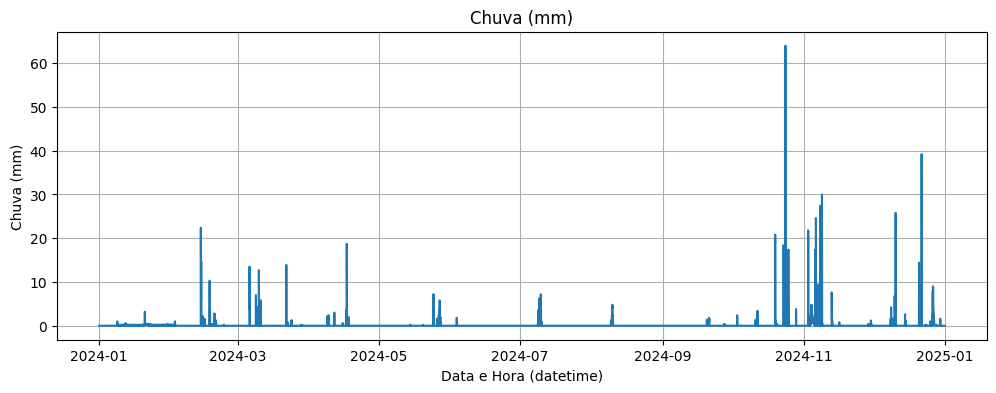

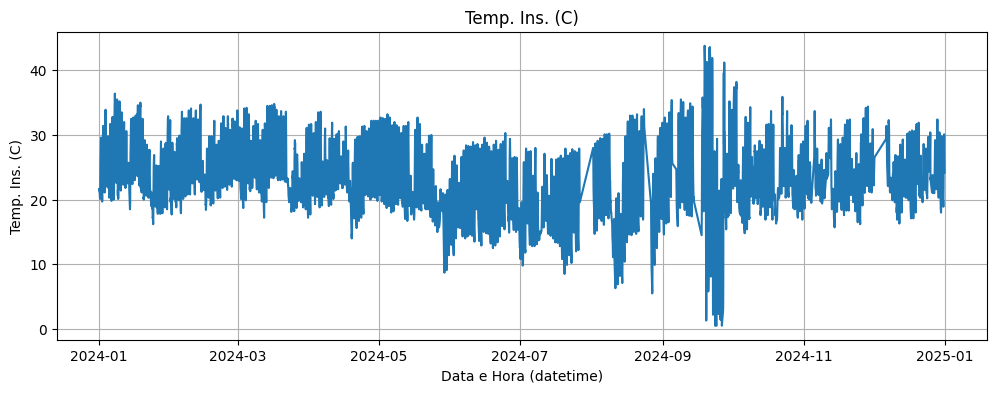

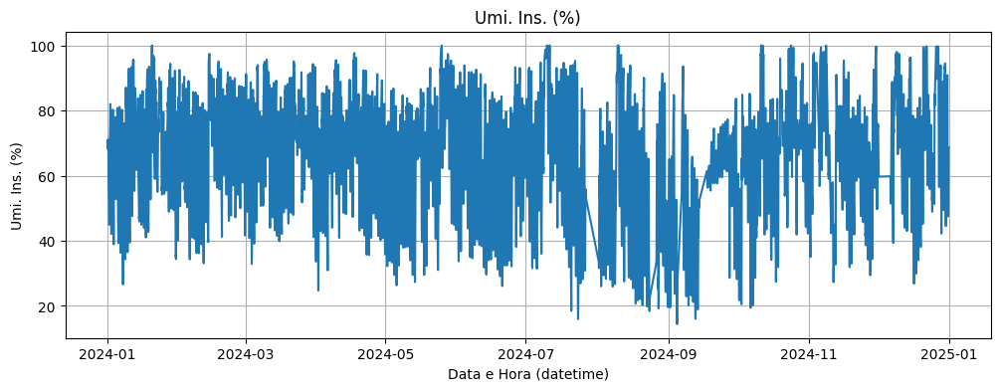

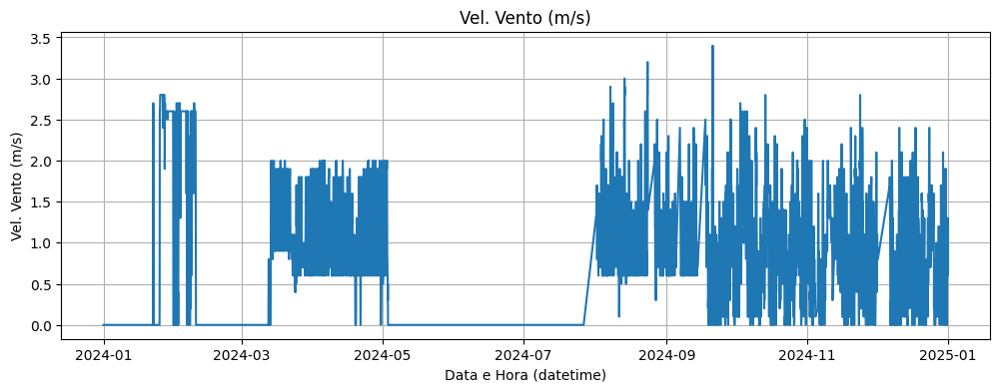

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8783 entries, 2024-01-01 00:00:00 to 2024-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8783 non-null   float64
 1   Chuva (mm)        8783 non-null   float64
 2   Temp. Ins. (C)    8783 non-null   float64
 3   Umi. Ins. (%)     8783 non-null   float64
 4   Vel. Vento (m/s)  8783 non-null   float64
dtypes: float64(5)
memory usage: 411.7 KB


In [291]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client_df.index, client_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client_df.info()

In [292]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2024'
output_dir = 'Datasets tratados/2024'

os.makedirs(output_dir, exist_ok=True)

client_df.to_csv(os.path.join(output_dir, 'Processed_Data_2024-Client-7_V0498_Sorocaba.csv'), index=False)


# 8. Client- Dataset (Tatui)⭐

## Data collection and pre-processing

In [293]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0507 - Tatui/2024/INMET_SE_SP_V0507_TATUI-Dataset_01-01-2024_A_31-12-2024.csv'
file_path = 'Datasets Brutos/Estacao_V0507 - Tatui/2024/INMET_SE_SP_V0507_TATUI-Dataset_01-01-2024_A_31-12-2024.csv'

# Upload CSV file into DataFrame
client_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [294]:
print("Dataframe format:")
print(f" ↪Linhas: {client_df.shape[0]} \n ↪Colunas: {client_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client_df.head()

Dataframe format:
 ↪Linhas: 8784 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2024,0,21.4,NaN,NaN,77.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.7,NaN,NaN,NaN,0.0
1,01/01/2024,100,20.7,NaN,NaN,78.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.5,NaN,NaN,NaN,0.0
2,01/01/2024,200,20.4,NaN,NaN,80.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,0.0
3,01/01/2024,300,19.9,NaN,NaN,84.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,0.0
4,01/01/2024,400,18.9,NaN,NaN,91.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.4,NaN,NaN,NaN,0.0


In [295]:
# Data general info
print("General Dataset Information:")
print(client_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8784 entries, 0 to 8783
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8784 non-null   object 
 1   Hora (UTC)            8784 non-null   int64  
 2   Temp. Ins. (C)        8300 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8300 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      8300 non-null   float

In [296]:
print("Descriptive statistics:")
client_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8784.000000,8300.000000,0.0,0.0,8300.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8300.000000,0.0,0.0,0.0,8300.000000
mean,1150.000000,21.290434,NaN,NaN,78.429964,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.381940,NaN,NaN,NaN,0.108048
std,692.258061,5.731078,NaN,NaN,21.923367,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.014594,NaN,NaN,NaN,0.861280
min,0.000000,3.000000,NaN,NaN,12.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,0.000000
25%,575.000000,17.600000,NaN,NaN,63.100000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.500000,NaN,NaN,NaN,0.000000
50%,1150.000000,21.000000,NaN,NaN,85.200000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.300000,NaN,NaN,NaN,0.000000
75%,1725.000000,25.200000,NaN,NaN,99.200000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.000000,NaN,NaN,NaN,0.000000
max,2300.000000,37.200000,NaN,NaN,100.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.400000,NaN,NaN,NaN,19.000000


In [297]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client_df['Hora (UTC)'] = client_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client_df['Hora Datetime'] = pd.to_datetime(client_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client_df['Data e Hora (datetime)'] = client_df['ï»¿"Data"'] + ' ' + client_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client_df['Data e Hora (datetime)'] = pd.to_datetime(client_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_19572\497734369.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client_df.loc[0, 'Hora (UTC)'] = modified_value


0   2024-01-01 00:00:00
1   2024-01-01 01:00:00
2   2024-01-01 02:00:00
3   2024-01-01 03:00:00
4   2024-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [298]:
client_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2024,0000,21.4,NaN,NaN,77.5,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.7,NaN,NaN,NaN,0.0,00:00:00,2024-01-01 00:00:00
1,01/01/2024,0100,20.7,NaN,NaN,78.8,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.5,NaN,NaN,NaN,0.0,01:00:00,2024-01-01 01:00:00
2,01/01/2024,0200,20.4,NaN,NaN,80.6,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.0,NaN,NaN,NaN,0.0,02:00:00,2024-01-01 02:00:00
3,01/01/2024,0300,19.9,NaN,NaN,84.1,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.0,NaN,NaN,NaN,0.0,03:00:00,2024-01-01 03:00:00
4,01/01/2024,0400,18.9,NaN,NaN,91.9,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.4,NaN,NaN,NaN,0.0,04:00:00,2024-01-01 04:00:00


In [299]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client_df = client_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8784, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2024-01-01 00:00:00,21.4,NaN,NaN,77.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.7,NaN,NaN,NaN,0.0
1,2024-01-01 01:00:00,20.7,NaN,NaN,78.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.5,NaN,NaN,NaN,0.0
2,2024-01-01 02:00:00,20.4,NaN,NaN,80.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,0.0
3,2024-01-01 03:00:00,19.9,NaN,NaN,84.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,0.0
4,2024-01-01 04:00:00,18.9,NaN,NaN,91.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.4,NaN,NaN,NaN,0.0


In [300]:
# Indexing of the 'Datetime' Date and Time
client_df.set_index('Data e Hora (datetime)', inplace=True)

client_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2024-01-01 00:00:00,21.4,NaN,NaN,77.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.7,NaN,NaN,NaN,0.0
2024-01-01 01:00:00,20.7,NaN,NaN,78.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.5,NaN,NaN,NaN,0.0
2024-01-01 02:00:00,20.4,NaN,NaN,80.6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,0.0
2024-01-01 03:00:00,19.9,NaN,NaN,84.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,0.0
2024-01-01 04:00:00,18.9,NaN,NaN,91.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.4,NaN,NaN,NaN,0.0


In [301]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           484
Temp. Max. (C)          8784
Temp. Min. (C)          8784
Umi. Ins. (%)            484
Umi. Max. (%)           8784
Umi. Min. (%)           8784
Pto Orvalho Ins. (C)    8784
Pto Orvalho Max. (C)    8784
Pto Orvalho Min. (C)    8784
Pressao Ins. (hPa)      8784
Pressao Max. (hPa)      8784
Pressao Min. (hPa)      8784
Vel. Vento (m/s)         484
Dir. Vento (m/s)        8784
Raj. Vento (m/s)        8784
Radiacao (KJ/mÂ²)       8784
Chuva (mm)               484
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            5.510018
Temp. Max. (C)          100.000000
Temp. Min. (C)          100.000000
Umi. Ins. (%)             5.510018
Umi. Max. (%)           100.000000
Umi. Min. (%)           100.000000
Pto Orvalho Ins. (C)    100.000000
Pto Orvalho Max. (C)    100.000000
Pto Orvalho Min. (C)    100.000000
Pressao Ins. (hPa)      100.000000
Pressao Max. (hPa)      100.000000
Pressao Min. (hPa)      100.000000

In [302]:
# Dropping columns with 100% missing values
client_df = client_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      5.510018
Umi. Ins. (%)       5.510018
Vel. Vento (m/s)    5.510018
Chuva (mm)          5.510018
dtype: float64


In [303]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [304]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,21.4,77.5,1.7,0.0
2024-01-01 01:00:00,20.7,78.8,1.5,0.0
2024-01-01 02:00:00,20.4,80.6,1.0,0.0
2024-01-01 03:00:00,19.9,84.1,1.0,0.0
2024-01-01 04:00:00,18.9,91.9,0.4,0.0


In [305]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [306]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

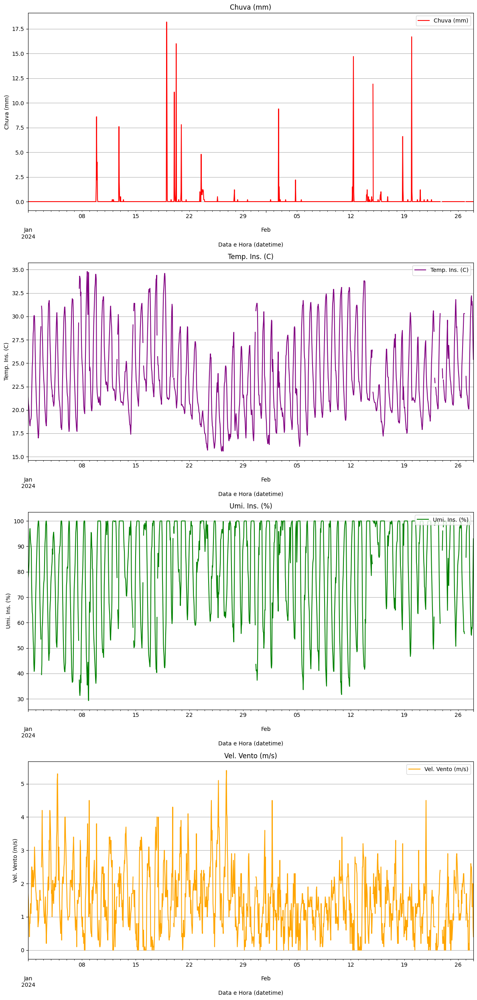

In [307]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

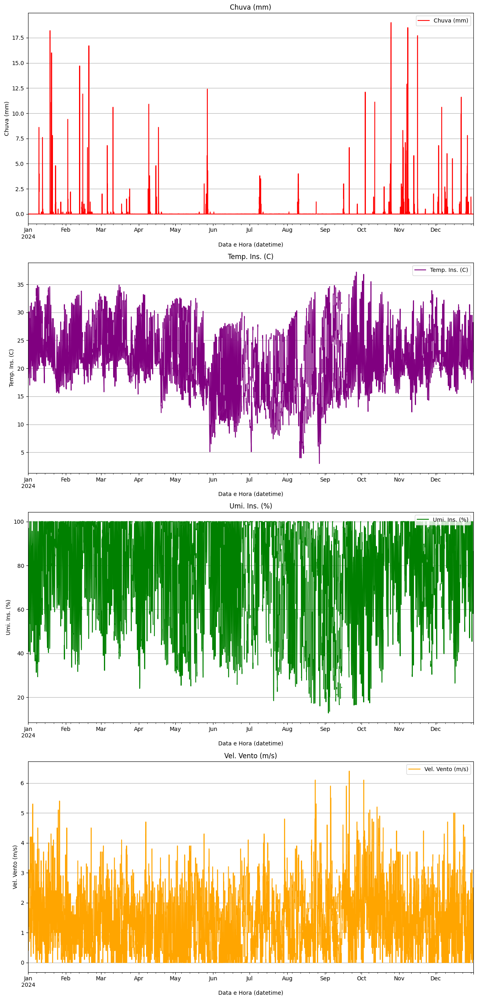

In [308]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [309]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client_df.columns:
    if client_df[column].isnull().any():
        client_df[column] = client_df[column].interpolate(method='linear')  # Interpolação linear

In [310]:
# Check missing values
print("Amount of missing values per column:")
print(client_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [311]:
# Filters the data by interval
client_df_intervalo = client_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

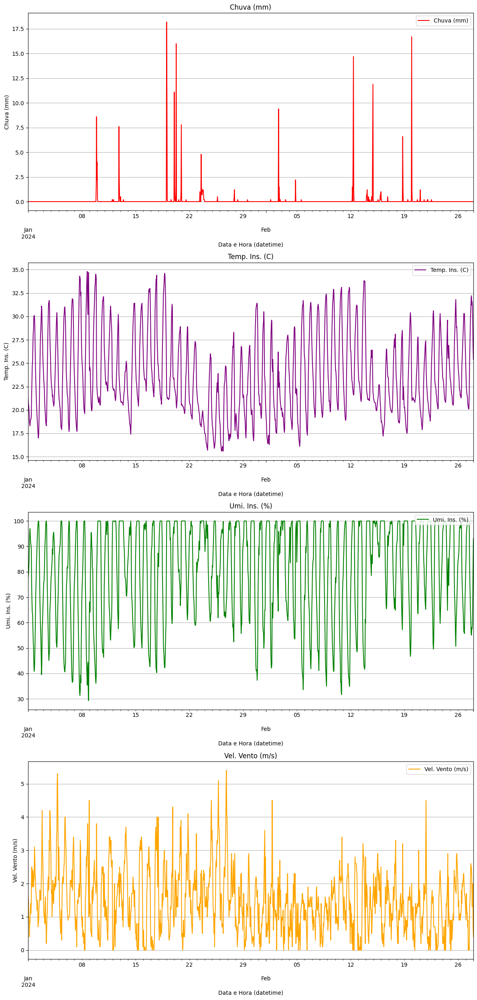

In [312]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df_intervalo.plot(y=client_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client_df_intervalo.columns[3])
client_df_intervalo.plot(y=client_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client_df_intervalo.columns[0])
client_df_intervalo.plot(y=client_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client_df_intervalo.columns[1])
client_df_intervalo.plot(y=client_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df_intervalo.columns[3])
axes[1].set_ylabel(client_df_intervalo.columns[0])
axes[2].set_ylabel(client_df_intervalo.columns[1])
axes[3].set_ylabel(client_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

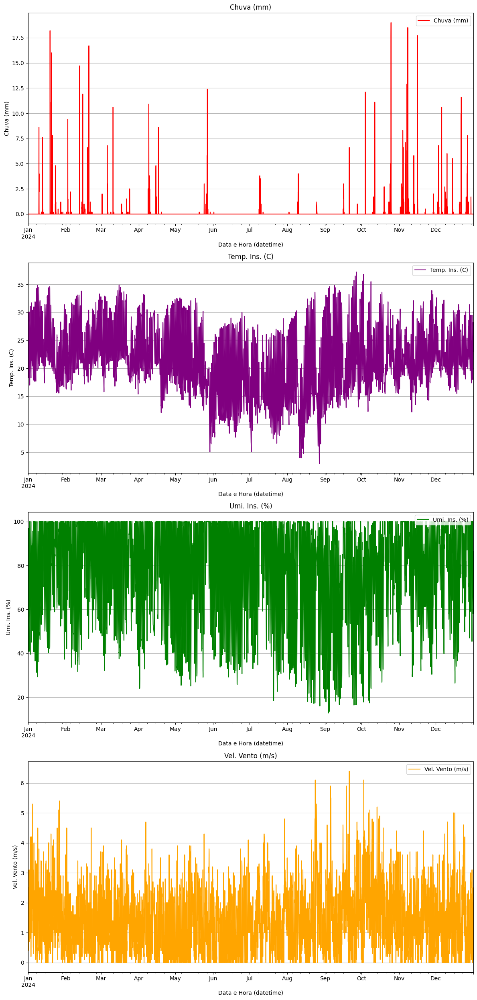

In [313]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client_df.plot(y=client_df.columns[3], ax=axes[0], color='red', legend=True, title=client_df.columns[3])
client_df.plot(y=client_df.columns[0], ax=axes[1], color='purple', legend=True, title=client_df.columns[0])
client_df.plot(y=client_df.columns[1], ax=axes[2], color='green', legend=True, title=client_df.columns[1])
client_df.plot(y=client_df.columns[2], ax=axes[3], color='orange', legend=True, title=client_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client_df.columns[3])
axes[1].set_ylabel(client_df.columns[0])
axes[2].set_ylabel(client_df.columns[1])
axes[3].set_ylabel(client_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [314]:
client_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,21.4,77.5,1.7,0.0
2024-01-01 01:00:00,20.7,78.8,1.5,0.0
2024-01-01 02:00:00,20.4,80.6,1.0,0.0
2024-01-01 03:00:00,19.9,84.1,1.0,0.0
2024-01-01 04:00:00,18.9,91.9,0.4,0.0


In [315]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client_df.pop(column)          # remove the column
client_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client_df.shape)

client_df.head()

DataFrame format:
(8784, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,0.0,21.4,77.5,1.7
2024-01-01 01:00:00,0.0,20.7,78.8,1.5
2024-01-01 02:00:00,0.0,20.4,80.6,1.0
2024-01-01 03:00:00,0.0,19.9,84.1,1.0
2024-01-01 04:00:00,0.0,18.9,91.9,0.4


In [316]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client_df['Chuva (mm) (t+1)'] = client_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client_df.pop(target_column)
client_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2024-12-31 18:00:00,0.0,0.0,27.6,66.1,0.1
2024-12-31 19:00:00,0.0,0.0,26.4,74.0,0.4
2024-12-31 20:00:00,0.0,0.0,26.7,68.8,2.5
2024-12-31 21:00:00,0.0,0.0,26.3,66.6,1.6
2024-12-31 22:00:00,0.0,0.0,24.5,77.2,2.0


## Saving data as `.csv`

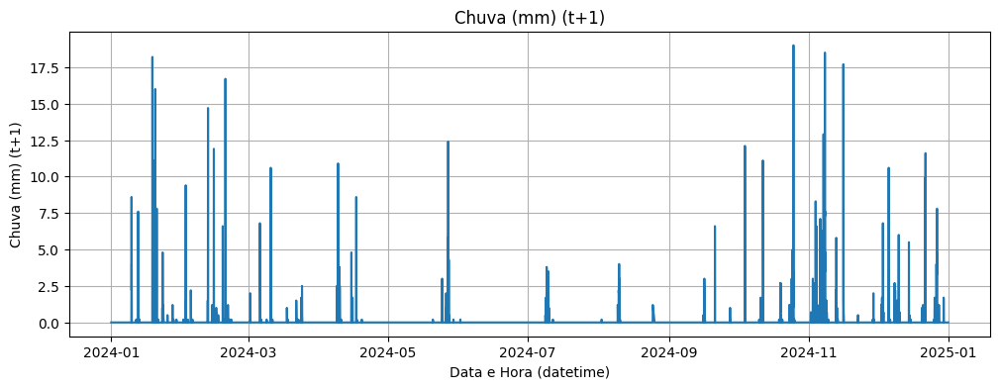

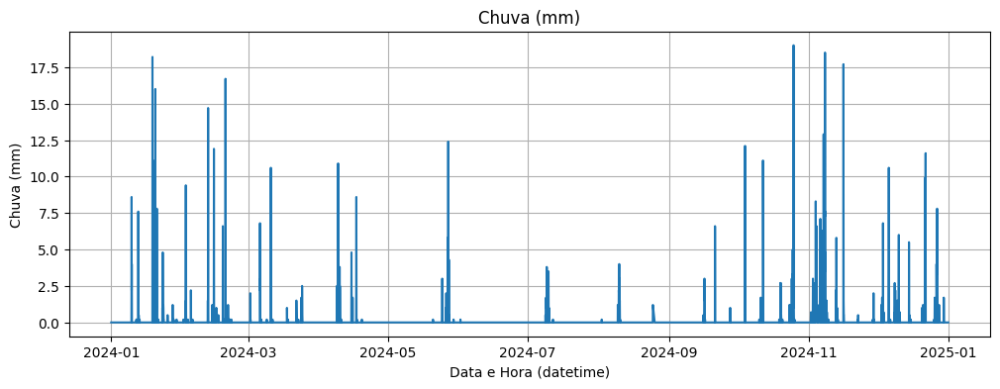

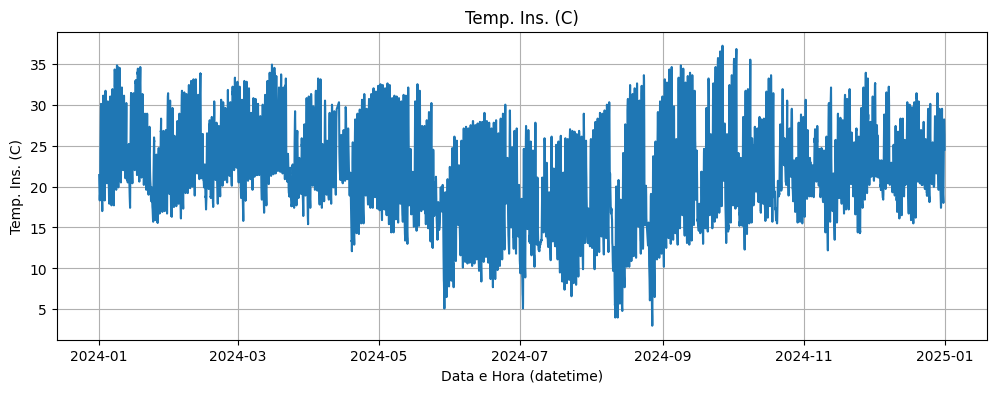

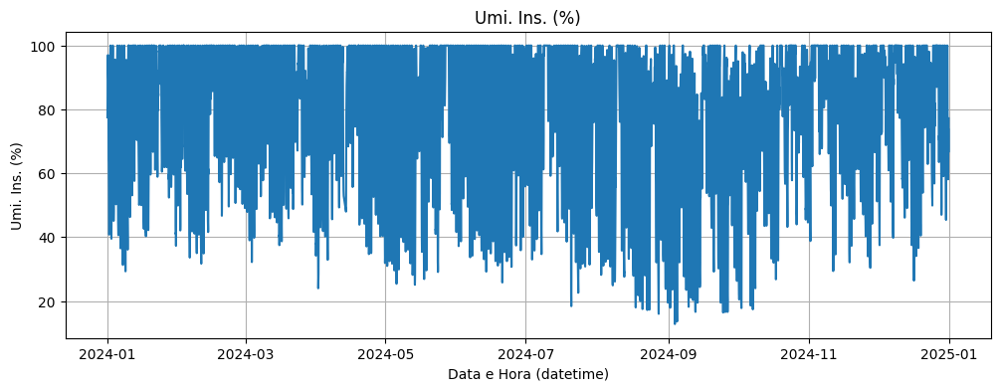

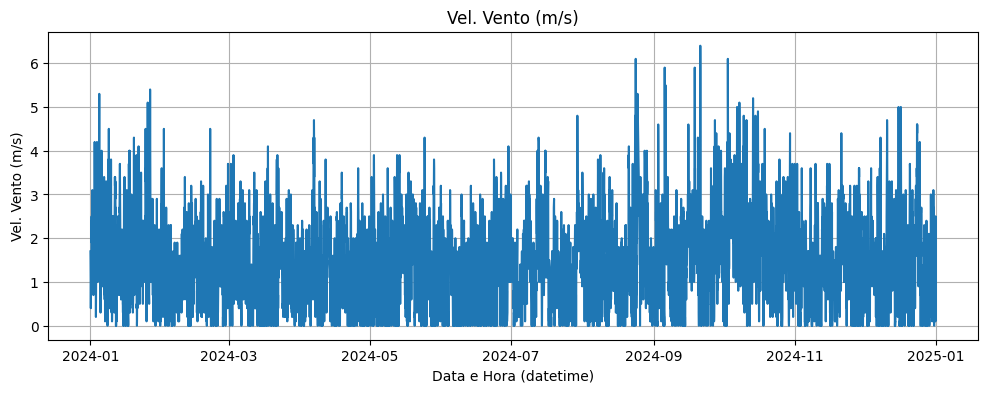

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8783 entries, 2024-01-01 00:00:00 to 2024-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8783 non-null   float64
 1   Chuva (mm)        8783 non-null   float64
 2   Temp. Ins. (C)    8783 non-null   float64
 3   Umi. Ins. (%)     8783 non-null   float64
 4   Vel. Vento (m/s)  8783 non-null   float64
dtypes: float64(5)
memory usage: 411.7 KB


In [317]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client_df.index, client_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client_df.info()

In [318]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2024'
output_dir = 'Datasets tratados/2024'

os.makedirs(output_dir, exist_ok=True)

client_df.to_csv(os.path.join(output_dir, 'Processed_Data_2024-Client-8_V0507_Tatui.csv'), index=False)


# 10. Client- Dataset (São Roque)⭐

## Data collection and pre-processing

In [334]:
# --------------------------
# Getting Clients dataset
# -------------------------
# Dataset path
# file_path = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets Brutos/Estacao_V0533 - Sao Roque/2024/INMET_SE_SP_V0533_SAO_ROQUE-Dataset_01-01-2024_A_31-12-2024.csv'
file_path = 'Datasets Brutos/Estacao_V0533 - Sao Roque/2024/INMET_SE_SP_V0533_SAO_ROQUE-Dataset_01-01-2024_A_31-12-2024.csv'

# Upload CSV file into DataFrame
client2_df = pd.read_csv(file_path, encoding='latin-1', sep=';', decimal=',')

In [335]:
print("Dataframe format:")
print(f" ↪Linhas: {client2_df.shape[0]} \n ↪Colunas: {client2_df.shape[1]}")

print("\n---\n")

print("First 5 lines of the dataset:")
client2_df.head()

Dataframe format:
 ↪Linhas: 8784 
 ↪Colunas: 19

---

First 5 lines of the dataset:


,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,01/01/2024,0,21.3,NaN,NaN,77.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,01/01/2024,100,21.5,NaN,NaN,76.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,01/01/2024,200,20.9,NaN,NaN,78.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,01/01/2024,300,20.7,NaN,NaN,77.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,01/01/2024,400,20.5,NaN,NaN,78.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [336]:
# Data general info
print("General Dataset Information:")
print(client2_df.info())

General Dataset Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8784 entries, 0 to 8783
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ï»¿"Data"             8784 non-null   object 
 1   Hora (UTC)            8784 non-null   int64  
 2   Temp. Ins. (C)        8588 non-null   float64
 3   Temp. Max. (C)        0 non-null      float64
 4   Temp. Min. (C)        0 non-null      float64
 5   Umi. Ins. (%)         8588 non-null   float64
 6   Umi. Max. (%)         0 non-null      float64
 7   Umi. Min. (%)         0 non-null      float64
 8   Pto Orvalho Ins. (C)  0 non-null      float64
 9   Pto Orvalho Max. (C)  0 non-null      float64
 10  Pto Orvalho Min. (C)  0 non-null      float64
 11  Pressao Ins. (hPa)    0 non-null      float64
 12  Pressao Max. (hPa)    0 non-null      float64
 13  Pressao Min. (hPa)    0 non-null      float64
 14  Vel. Vento (m/s)      8588 non-null   float

In [337]:
print("Descriptive statistics:")
client2_df.describe()

Descriptive statistics:


,Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
count,8784.000000,8588.000000,0.0,0.0,8588.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8588.0,0.0,0.0,0.0,8588.000000
mean,1150.000000,22.490009,NaN,NaN,71.880706,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.133302
std,692.258061,5.950763,NaN,NaN,15.791646,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,1.004334
min,0.000000,1.800000,NaN,NaN,16.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.000000
25%,575.000000,18.500000,NaN,NaN,63.100000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.000000
50%,1150.000000,22.100000,NaN,NaN,78.800000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.000000
75%,1725.000000,26.700000,NaN,NaN,83.900000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.000000
max,2300.000000,37.900000,NaN,NaN,88.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,25.900000


In [338]:
# --------------------
# Data Pre-Processing
# --------------------

# Replacing [0, 'Hora (UTC)'] value from '0' to '000'
first_value = str(client2_df['Hora (UTC)'].iloc[0])
modified_value = first_value.replace('0', '000', 1) if first_value == '0' else first_value
client2_df.loc[0, 'Hora (UTC)'] = modified_value

# Replacing ['Hora (UTC)'] column to fit '0' + 'Number' format
client2_df['Hora (UTC)'] = client2_df['Hora (UTC)'].apply(lambda x: str(x).zfill(4))


# Convert the UTC format to datetime format (only hour and minute)
client2_df['Hora Datetime'] = pd.to_datetime(client2_df['Hora (UTC)'], format='%H%M').dt.time

# Joining "Data" and "Hora Datetime" columns to create a "Data e Hora Datetime" column
client2_df['Data e Hora (datetime)'] = client2_df['ï»¿"Data"'] + ' ' + client2_df['Hora Datetime'].astype(str)

# Convert the "Data e Hora (datetime)" column to Datetime type
client2_df['Data e Hora (datetime)'] = pd.to_datetime(client2_df['Data e Hora (datetime)'], format='%d/%m/%Y %H:%M:%S')

client2_df['Data e Hora (datetime)'].head()


C:\Users\rafae\AppData\Local\Temp\ipykernel_19572\2898631049.py:8: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '000' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  client2_df.loc[0, 'Hora (UTC)'] = modified_value


0   2024-01-01 00:00:00
1   2024-01-01 01:00:00
2   2024-01-01 02:00:00
3   2024-01-01 03:00:00
4   2024-01-01 04:00:00
Name: Data e Hora (datetime), dtype: datetime64[ns]

In [339]:
client2_df.head()

,"ï»¿""Data""",Hora (UTC),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),...,Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm),Hora Datetime,Data e Hora (datetime)
0,01/01/2024,0000,21.3,NaN,NaN,77.1,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,00:00:00,2024-01-01 00:00:00
1,01/01/2024,0100,21.5,NaN,NaN,76.3,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,01:00:00,2024-01-01 01:00:00
2,01/01/2024,0200,20.9,NaN,NaN,78.3,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,02:00:00,2024-01-01 02:00:00
3,01/01/2024,0300,20.7,NaN,NaN,77.9,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,03:00:00,2024-01-01 03:00:00
4,01/01/2024,0400,20.5,NaN,NaN,78.5,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,04:00:00,2024-01-01 04:00:00


In [340]:
# Removing "ï»¿"Data"", "Hora (UTC)", "Hora Datetime" columns
client2_df = client2_df.drop(columns=['ï»¿"Data"', 'Hora (UTC)', 'Hora Datetime'])
# client2_df.head() # Displaying the head after dropping is not needed as it will be shown after inserting the column

# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Data e Hora (datetime)'
removed_column = client2_df.pop(column)          # remove the column
client2_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client2_df.shape)

client2_df.head()

DataFrame format:
(8784, 18)


,Data e Hora (datetime),Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
0,2024-01-01 00:00:00,21.3,NaN,NaN,77.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
1,2024-01-01 01:00:00,21.5,NaN,NaN,76.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2,2024-01-01 02:00:00,20.9,NaN,NaN,78.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
3,2024-01-01 03:00:00,20.7,NaN,NaN,77.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
4,2024-01-01 04:00:00,20.5,NaN,NaN,78.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [341]:
# Indexing of the 'Datetime' Date and Time
client2_df.set_index('Data e Hora (datetime)', inplace=True)

client2_df.head()

,Temp. Ins. (C),Temp. Max. (C),Temp. Min. (C),Umi. Ins. (%),Umi. Max. (%),Umi. Min. (%),Pto Orvalho Ins. (C),Pto Orvalho Max. (C),Pto Orvalho Min. (C),Pressao Ins. (hPa),Pressao Max. (hPa),Pressao Min. (hPa),Vel. Vento (m/s),Dir. Vento (m/s),Raj. Vento (m/s),Radiacao (KJ/mÂ²),Chuva (mm)
Data e Hora (datetime),,,,,,,,,,,,,,,,,
2024-01-01 00:00:00,21.3,NaN,NaN,77.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 01:00:00,21.5,NaN,NaN,76.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 02:00:00,20.9,NaN,NaN,78.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 03:00:00,20.7,NaN,NaN,77.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0
2024-01-01 04:00:00,20.5,NaN,NaN,78.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0


In [342]:
# Check missing values
print("Amount of missing values per column:")
print(client2_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client2_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)           196
Temp. Max. (C)          8784
Temp. Min. (C)          8784
Umi. Ins. (%)            196
Umi. Max. (%)           8784
Umi. Min. (%)           8784
Pto Orvalho Ins. (C)    8784
Pto Orvalho Max. (C)    8784
Pto Orvalho Min. (C)    8784
Pressao Ins. (hPa)      8784
Pressao Max. (hPa)      8784
Pressao Min. (hPa)      8784
Vel. Vento (m/s)         196
Dir. Vento (m/s)        8784
Raj. Vento (m/s)        8784
Radiacao (KJ/mÂ²)       8784
Chuva (mm)               196
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)            2.23133
Temp. Max. (C)          100.00000
Temp. Min. (C)          100.00000
Umi. Ins. (%)             2.23133
Umi. Max. (%)           100.00000
Umi. Min. (%)           100.00000
Pto Orvalho Ins. (C)    100.00000
Pto Orvalho Max. (C)    100.00000
Pto Orvalho Min. (C)    100.00000
Pressao Ins. (hPa)      100.00000
Pressao Max. (hPa)      100.00000
Pressao Min. (hPa)      100.00000
Vel. Vento 

In [343]:
# Dropping columns with 100% missing values
client2_df = client2_df.dropna(axis=1, how='all')

# Check missing values
print("Percentage of missing values:")
print(client2_df.isnull().mean() * 100)

Percentage of missing values:
Temp. Ins. (C)      2.23133
Umi. Ins. (%)       2.23133
Vel. Vento (m/s)    2.23133
Chuva (mm)          2.23133
dtype: float64


In [344]:
# pd.set_option('display.max_rows', None)  # Mostra todas as linhas

In [345]:
client2_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,21.3,77.1,0.0,0.0
2024-01-01 01:00:00,21.5,76.3,0.0,0.0
2024-01-01 02:00:00,20.9,78.3,0.0,0.0
2024-01-01 03:00:00,20.7,77.9,0.0,0.0
2024-01-01 04:00:00,20.5,78.5,0.0,0.0


In [346]:
# pd.set_option('display.max_columns', None)  # (Opcional) Mostra todas as colunas

----- Visualization of Client-1 dataset -----

In [347]:
# Filters the data by interval
client2_df_intervalo = client2_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

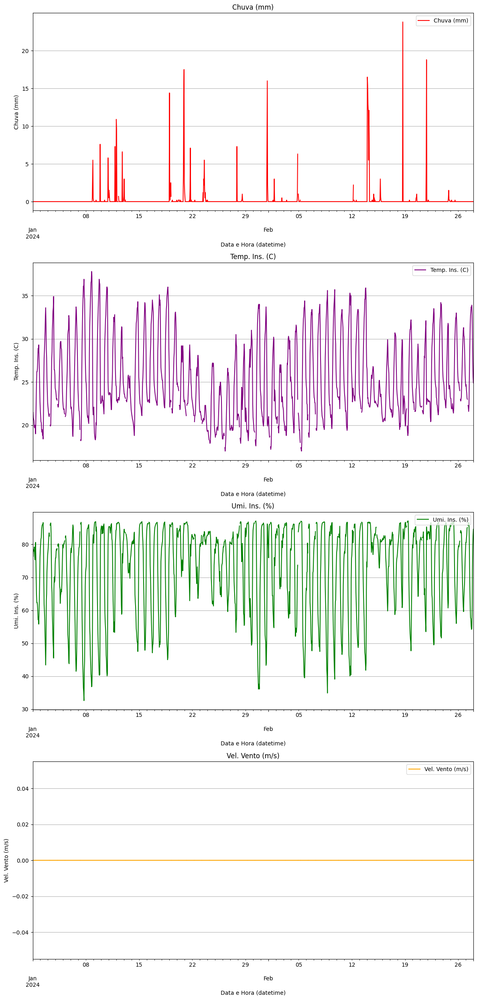

In [348]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df_intervalo.plot(y=client2_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client2_df_intervalo.columns[3])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df_intervalo.columns[0])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client2_df_intervalo.columns[1])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df_intervalo.columns[3])
axes[1].set_ylabel(client2_df_intervalo.columns[0])
axes[2].set_ylabel(client2_df_intervalo.columns[1])
axes[3].set_ylabel(client2_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

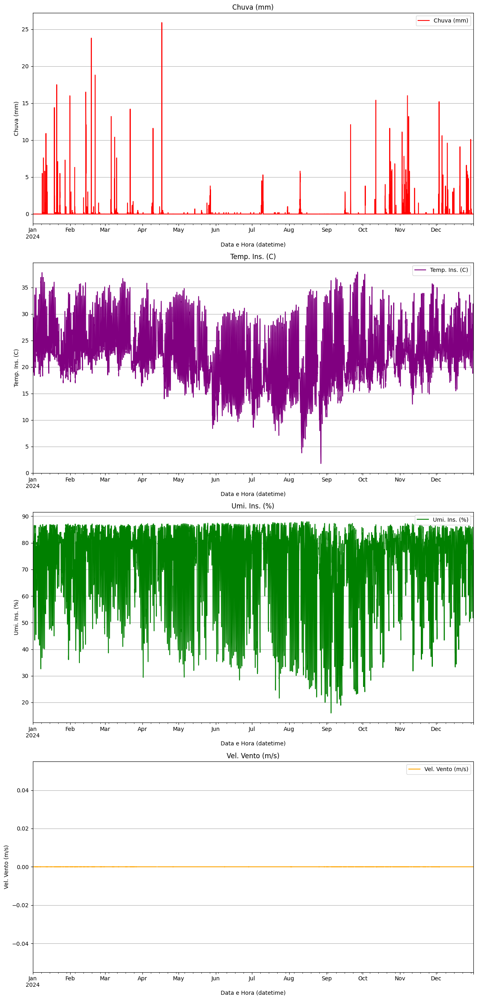

In [349]:
# ------------------------------------
# All data period 
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df.plot(y=client2_df.columns[3], ax=axes[0], color='red', legend=True, title=client2_df.columns[3])
client2_df.plot(y=client2_df.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df.columns[0])
client2_df.plot(y=client2_df.columns[1], ax=axes[2], color='green', legend=True, title=client2_df.columns[1])
client2_df.plot(y=client2_df.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df.columns[3])
axes[1].set_ylabel(client2_df.columns[0])
axes[2].set_ylabel(client2_df.columns[1])
axes[3].set_ylabel(client2_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

In [350]:
# Fill missing values (~=5%) performing the interpolation only on columns with NaN
for column in client2_df.columns:
    if client2_df[column].isnull().any():
        client2_df[column] = client2_df[column].interpolate(method='linear')  # Interpolação linear

In [351]:
# Check missing values
print("Amount of missing values per column:")
print(client2_df.isnull().sum())

print("\n --- \n")

print("Percentage of missing values:")
print(client2_df.isnull().mean() * 100)

Amount of missing values per column:
Temp. Ins. (C)      0
Umi. Ins. (%)       0
Vel. Vento (m/s)    0
Chuva (mm)          0
dtype: int64

 --- 

Percentage of missing values:
Temp. Ins. (C)      0.0
Umi. Ins. (%)       0.0
Vel. Vento (m/s)    0.0
Chuva (mm)          0.0
dtype: float64


Checking the main features visually

In [352]:
# Filters the data by interval
client2_df_intervalo = client2_df.loc['2024-01-01 00:00:00':'2024-02-28 00:00:00']

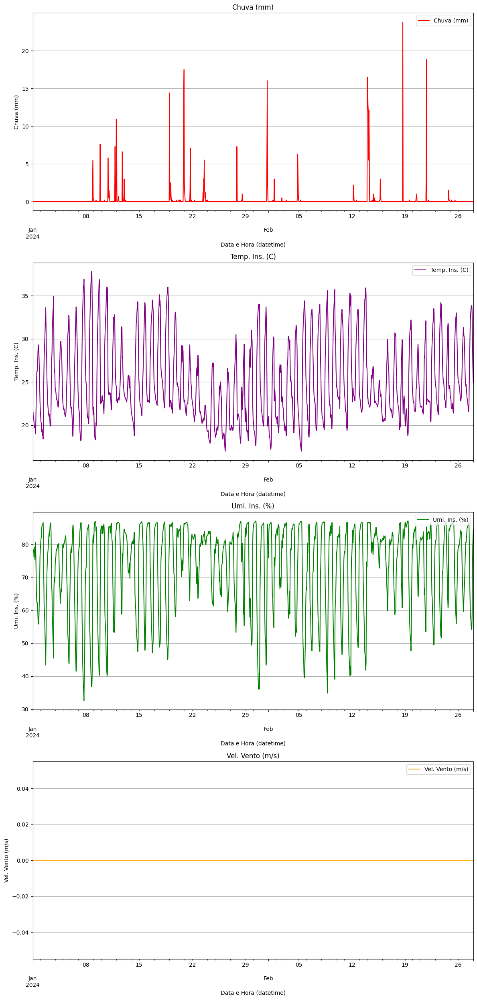

In [353]:
# ------------------------------------
# For January and February only
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df_intervalo.plot(y=client2_df_intervalo.columns[3], ax=axes[0], color='red', legend=True, title=client2_df_intervalo.columns[3])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df_intervalo.columns[0])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[1], ax=axes[2], color='green', legend=True, title=client2_df_intervalo.columns[1])
client2_df_intervalo.plot(y=client2_df_intervalo.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df_intervalo.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df_intervalo.columns[3])
axes[1].set_ylabel(client2_df_intervalo.columns[0])
axes[2].set_ylabel(client2_df_intervalo.columns[1])
axes[3].set_ylabel(client2_df_intervalo.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

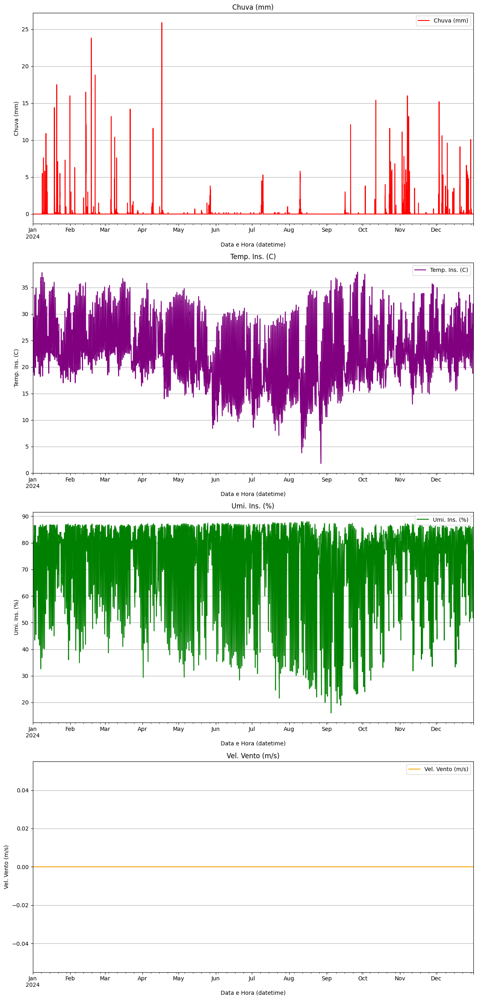

In [354]:
# ------------------------------------
# For All period
# ------------------------------------

# Creating subplots manually with adjustments
fig, axes = plt.subplots(nrows=4, ncols=1, figsize=(12, 25), gridspec_kw={'height_ratios': [5, 5, 5, 5]})       # `height_ratios` defines the relative heights of the subplots

# Adding plots individually
client2_df.plot(y=client2_df.columns[3], ax=axes[0], color='red', legend=True, title=client2_df.columns[3])
client2_df.plot(y=client2_df.columns[0], ax=axes[1], color='purple', legend=True, title=client2_df.columns[0])
client2_df.plot(y=client2_df.columns[1], ax=axes[2], color='green', legend=True, title=client2_df.columns[1])
client2_df.plot(y=client2_df.columns[2], ax=axes[3], color='orange', legend=True, title=client2_df.columns[2])

# Iterate over each subplot
for ax in axes:
  ax.grid(axis='y')             # Activate grid for the y-axis
  ax.legend(loc='upper right')  # Move legend to the upper right corner

# Adjusting axis labels
axes[0].set_ylabel(client2_df.columns[3])
axes[1].set_ylabel(client2_df.columns[0])
axes[2].set_ylabel(client2_df.columns[1])
axes[3].set_ylabel(client2_df.columns[2])
#axes[3].set_xlabel('Date and Time')  # Only the last plot needs an X-axis label

# Adjusting spacing between plots
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

## Target feature and implementation of Sliding Window

In [355]:
client2_df.head()

,Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s),Chuva (mm)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,21.3,77.1,0.0,0.0
2024-01-01 01:00:00,21.5,76.3,0.0,0.0
2024-01-01 02:00:00,20.9,78.3,0.0,0.0
2024-01-01 03:00:00,20.7,77.9,0.0,0.0
2024-01-01 04:00:00,20.5,78.5,0.0,0.0


In [356]:
# Changing the position of the "Data e Hora Datetime" column in the dataframe
column = 'Chuva (mm)'
removed_column = client2_df.pop(column)          # remove the column
client2_df.insert(0, column, removed_column)     # insert the column in the new position

# Display the DataFrame format and the resulting DataFrame
print("DataFrame format:")
print(client2_df.shape)

client2_df.head()

DataFrame format:
(8784, 4)


,Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,
2024-01-01 00:00:00,0.0,21.3,77.1,0.0
2024-01-01 01:00:00,0.0,21.5,76.3,0.0
2024-01-01 02:00:00,0.0,20.9,78.3,0.0
2024-01-01 03:00:00,0.0,20.7,77.9,0.0
2024-01-01 04:00:00,0.0,20.5,78.5,0.0


In [357]:
# ----------------------------------------------------------------------
# Creating the Target feature 'Chuva (mm) (t+1)'
# ----------------------------------------------------------------------

client2_df['Chuva (mm) (t+1)'] = client2_df['Chuva (mm)'].shift(-1)

# Shift the new target column to the beginning of the DataFrame
target_column = 'Chuva (mm) (t+1)'
removed_target_column = client2_df.pop(target_column)
client2_df.insert(0, target_column, removed_target_column)

# Remove NaN value from target
client2_df.dropna(subset=['Chuva (mm) (t+1)'], inplace=True)

client2_df.tail()

,Chuva (mm) (t+1),Chuva (mm),Temp. Ins. (C),Umi. Ins. (%),Vel. Vento (m/s)
Data e Hora (datetime),,,,,
2024-12-31 18:00:00,0.0,0.0,29.5,56.5,0.0
2024-12-31 19:00:00,0.0,0.0,26.8,67.3,0.0
2024-12-31 20:00:00,0.0,0.0,25.3,72.3,0.0
2024-12-31 21:00:00,0.0,0.0,25.1,72.5,0.0
2024-12-31 22:00:00,0.0,0.0,24.5,73.5,0.0


## Saving data as `.csv`

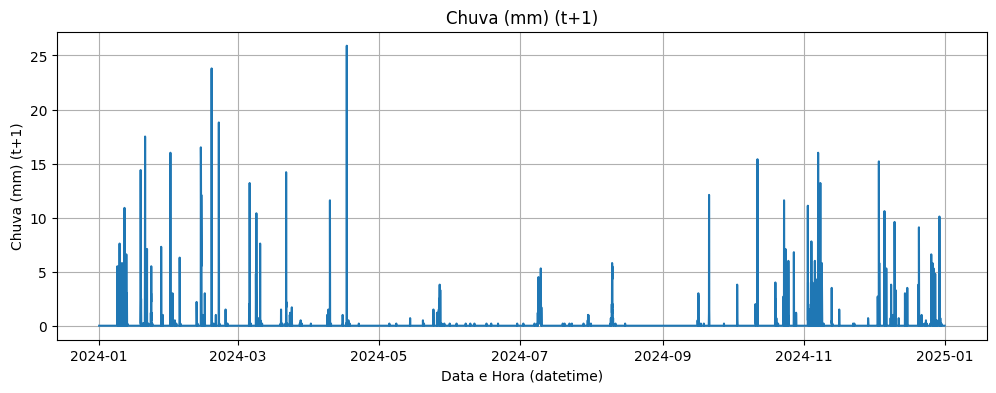

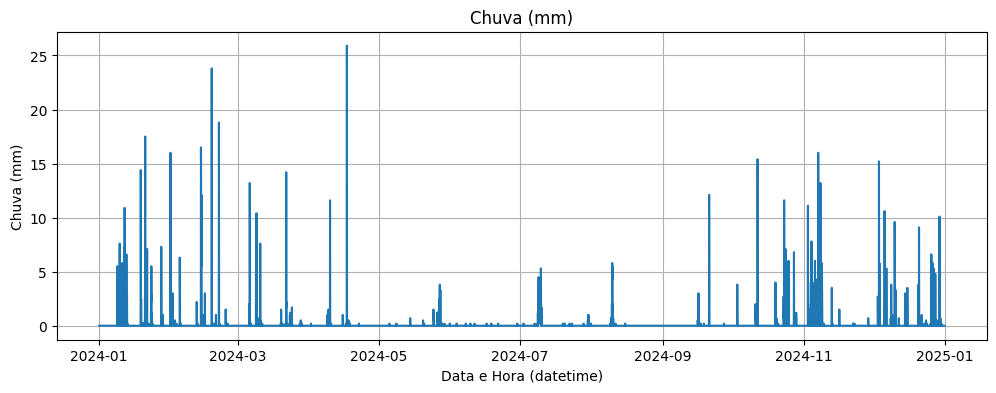

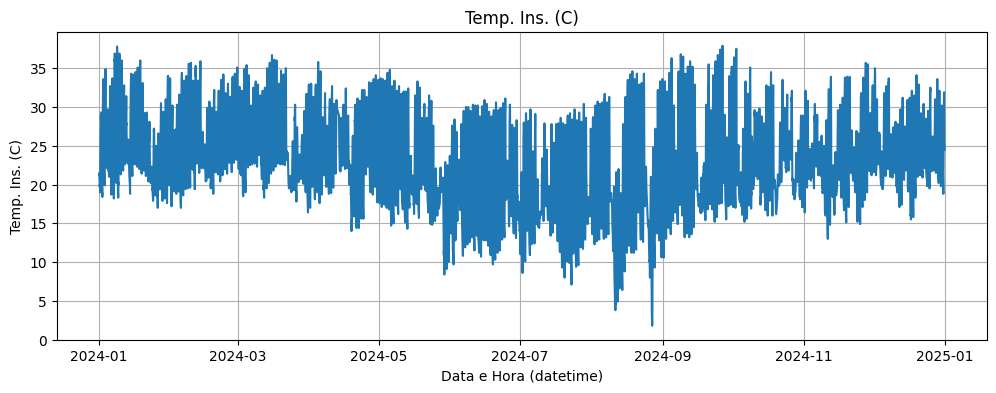

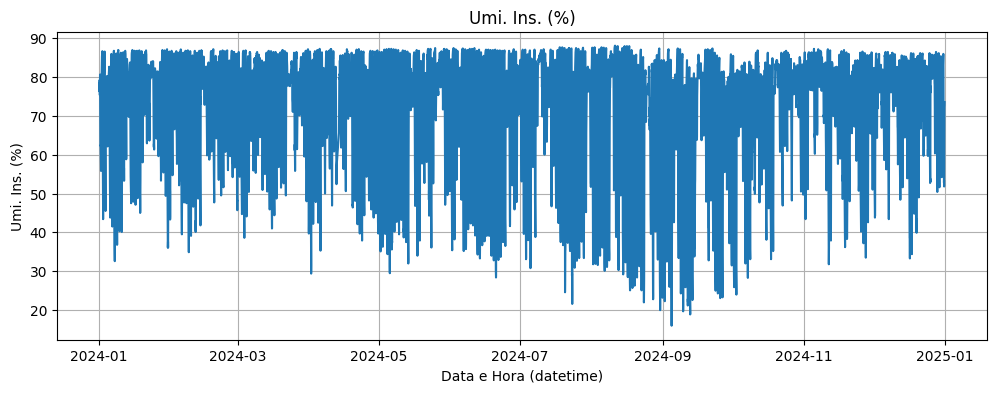

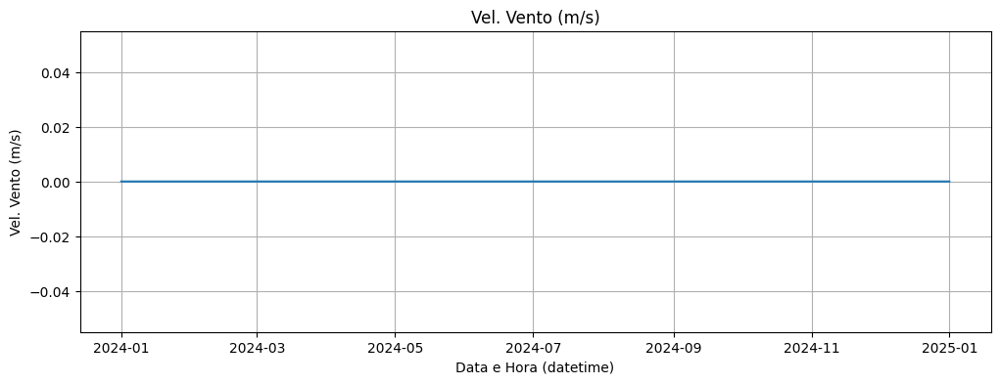

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8783 entries, 2024-01-01 00:00:00 to 2024-12-31 22:00:00
Data columns (total 5 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Chuva (mm) (t+1)  8783 non-null   float64
 1   Chuva (mm)        8783 non-null   float64
 2   Temp. Ins. (C)    8783 non-null   float64
 3   Umi. Ins. (%)     8783 non-null   float64
 4   Vel. Vento (m/s)  8783 non-null   float64
dtypes: float64(5)
memory usage: 411.7 KB


In [358]:
# ------------------------
# Showing Dataset features
# ------------------------

# Plota cada coluna individualmente
for col in client2_df.columns:
    plt.figure(figsize=(12, 4))
    plt.plot(client2_df.index, client2_df[col])
    plt.title(col)
    plt.xlabel('Data e Hora (datetime)')
    plt.ylabel(col)
    plt.grid(True)
    plt.show()

client2_df.info()

In [359]:
# ------------------------
# Saving data as CSV file
# ------------------------
import os

# output_dir = '/content/drive/MyDrive/Colab Notebooks/(Researchs)/IC - Pessoal/1 - Modelos (Datasets do INMET de Sorocaba e região)/Datasets tratados/2024'
output_dir = 'Datasets tratados/2024'

os.makedirs(output_dir, exist_ok=True)

client2_df.to_csv(os.path.join(output_dir, 'Processed_Data_2024-Client-10_V0533_Sao Roque.csv'), index=False)
